<img src="header-analysis.png"/>

_Credits: https://www.flickr.com/mcazadi/2473296392_

# Execution du notebook

Le présent notebook suppose l'arborescence suivante, pour le chargement des données et l'écriture des résultats : 

```bash
├───data
│   ├───processed
│   │   └───df_clean.pkl
│   └───raw
└───notebooks
    ├───1_exploration.ipynb
    ├───2_analysis.ipynb
    ├───3_models.ipynb
    ├───header-analysis.png
    ├───header-exploration.png
    └───header-models.png
```

Les fichiers `*.pkl` sont issus de l'exécution du notebook `1_exploration.ipynb`.

# Initialisation du projet

In [4]:
# Math & data
import numpy as np
import scipy
from scipy.stats import zscore
import pandas as pd
from datetime import date
import itertools
import re

# Graphics
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.cbook import boxplot_stats

import pickle

In [5]:
# Preprocessing
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline

# Feature selection
from sklearn.model_selection import GridSearchCV, KFold

# ML
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.metrics import roc_curve, auc, roc_auc_score

from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from xgboost import XGBClassifier, XGBRegressor
from lightgbm import LGBMClassifier, LGBMRegressor
from sklearn.multiclass import OneVsOneClassifier, OneVsRestClassifier
from sklearn.svm import SVC, LinearSVC
from sklearn.dummy import DummyClassifier

from sklearn.decomposition import PCA
from sklearn.ensemble import IsolationForest

In [6]:
import statsmodels.api as sm

In [7]:
%load_ext autoreload
# %reload_ext autoreload
%autoreload 2

In [8]:
# Personal libraries
import DisplotData, DisplotML, PwePwocess, Funktiuns, MLstuff
from DisplotData import bcolors

In [9]:
# Display options
pd.set_option("display.max_columns", 50) # None
pd.set_option("display.max_rows", 50) # None

In [10]:
# Constants
EPSILON = 1.e-12
EPSILON_GFA = 1 # For squared feet
TOL = 1.05 # 5% of tolerance for comparisons

# Chargement des données

In [11]:
data_raw_dir = '../data/raw/'
data_processed_dir = '../data/processed/'

In [160]:
file = open(data_processed_dir+'df_clean.pkl','rb')
df_clean = pickle.load(file)
file.close()

file = open(data_processed_dir+'df_nonan.pkl','rb')
df_nonan = pickle.load(file)
file.close()

# Etudes statistiques

In [13]:
df_clean.describe()

,CouncilDistrictCode,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,GHGEmissionsIntensity,ZipCode,SecondLargestPropertyUseType_IMPUTED,ThirdLargestPropertyUseType_IMPUTED,...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
count,3180.000000,3180.000000,3180.000000,3180.000000,3.180000e+03,3180.000000,3.180000e+03,3.180000e+03,3.180000e+03,3180.000000,2439.000000,3180.000000,3180.000000,3180.000000,3180.000000,3.180000e+03,3.180000e+03,3.180000e+03,3.180000e+03,3.180000e+03,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,...,3180.000000,3180.000000,3180.000000,3180.000000,3180.0,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,3180.000000,3180.00000,3180.000000,3180.000000,3180.000000,3180.000000,3.180000e+03
mean,4.444654,1968.775157,1.067925,4.717610,9.506061e+04,15089.568239,8.387154e+04,7.417919e+04,5.092789e+03,1477.139587,68.553096,53.028805,56.778082,131.674811,137.431730,5.351514e+06,5.268045e+06,2.512670e+05,3.709368e+06,1.336584e+06,116.239255,0.969868,20560.211950,0.150629,0.238365,...,53.768078,156.649468,399.498742,38.586979,0.0,67.016289,102.536418,3.698935,38.961204,52.039308,91.750706,14.070475,3.607862,8.036792,1.964151,957.627964,3272.527923,90.117610,2829.567412,162.11027,193.555660,8.866981,589.309614,1491.877924,1.918887e+04
std,2.113875,33.052839,2.099396,5.507135,2.231541e+05,44850.338124,2.100038e+05,1.998651e+05,1.639104e+04,6428.132656,26.518006,54.317963,55.919626,135.247296,134.577636,2.216088e+07,1.632271e+07,3.729070e+06,1.525418e+07,6.905941e+06,541.558513,1.629551,11737.923571,0.357743,0.426150,...,1319.544149,4151.093940,4771.604186,770.073130,0.0,1296.869763,1872.981849,149.059135,1242.301164,2483.146826,1469.797827,342.509123,203.452689,453.206691,110.761396,9418.953197,16061.290259,3121.886413,20331.236989,5762.53320,9625.755909,500.022266,5011.671444,19328.172705,8.248029e+04
min,1.000000,1900.000000,1.000000,0.000000,2.000000e+04,0.000000,5.236000e+03,5.236000e+03,-5.820766e-11,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,17916.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
25%,3.000000,1949.000000,1.000000,2.000000,2.856600e+04,0.000000,2.682925e+04,2.445375e+04,0.000000e+00,0.000000,52.000000,27.500000,29.875000,74.000000,80.400000,9.293232e+05,9.996270e+05,0.000000e+00,6.462565e+05,0.000000e+00,9.585000,0.080000,18379.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
50%,4.000000,1975.000000,1.000000,4.

## Etudes univariées

In [14]:
categ_cols = ['BuildingType', 'PrimaryPropertyType', 'CouncilDistrictCode',
              'Neighborhood', 'YearBuilt', 'NumberofBuildings', 'NumberofFloors',
              'ListOfAllPropertyUseTypes', 
              'LargestPropertyUseType',
              'SecondLargestPropertyUseType', 'ThirdLargestPropertyUseType',
              'ZipCode']

In [15]:
num_cols = ['PropertyGFATotal', 'PropertyGFAParking', 'PropertyGFABuilding(s)',
            'LargestPropertyUseTypeGFA', 
            'SecondLargestPropertyUseTypeGFA', 'ThirdLargestPropertyUseTypeGFA',
            'SiteEUI(kBtu/sf)', 'SiteEUIWN(kBtu/sf)', # not to be used as input for regressions
            'SourceEUI(kBtu/sf)', 'SourceEUIWN(kBtu/sf)', # not to be used as input for regressions
            'SteamUse(kBtu)', 'Electricity(kBtu)', 'NaturalGas(kBtu)', # not to be used as input for regressions
            'GHGEmissionsIntensity', # not to be used as input for regressions
            'SiteEnergyUseWN(kBtu)', # not to be used as input for regressions
            'TotalGHGEmissions', 'SiteEnergyUse(kBtu)'
           ]

In [16]:
target_col = 'TotalGHGEmissions'
# target_col = 'SiteEnergyUse(kBtu)'

In [17]:
all_cols = []
feat_cols = []
if categ_cols:
    all_cols.extend(categ_cols)
    feat_cols.extend(categ_cols)
if num_cols:
    all_cols.extend(num_cols)
    feat_cols.extend(num_cols)
if target_col:
    all_cols.append(target_col)

#### Variables catégorielles

In [18]:
plt.rcParams['figure.figsize'] = [15, 6]
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

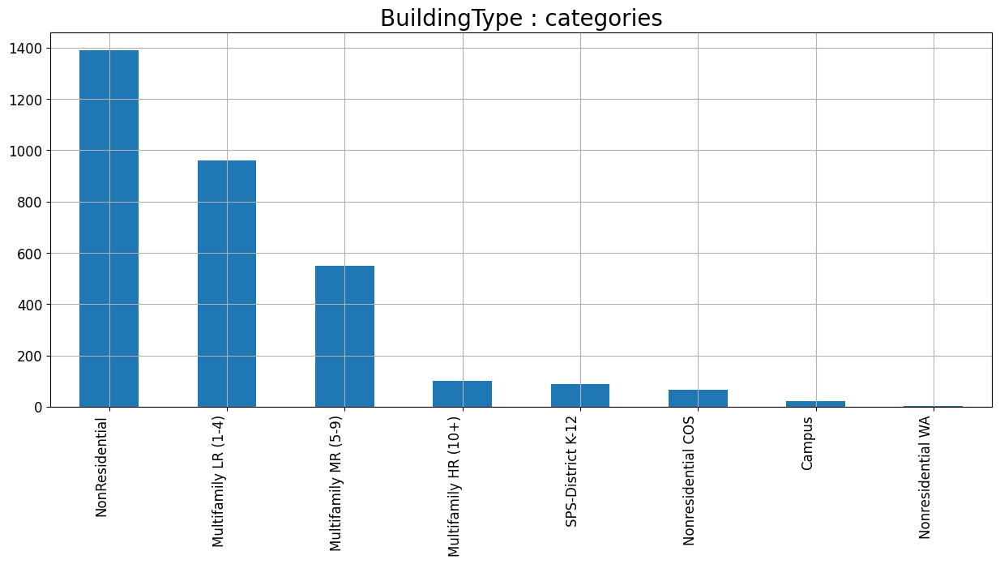

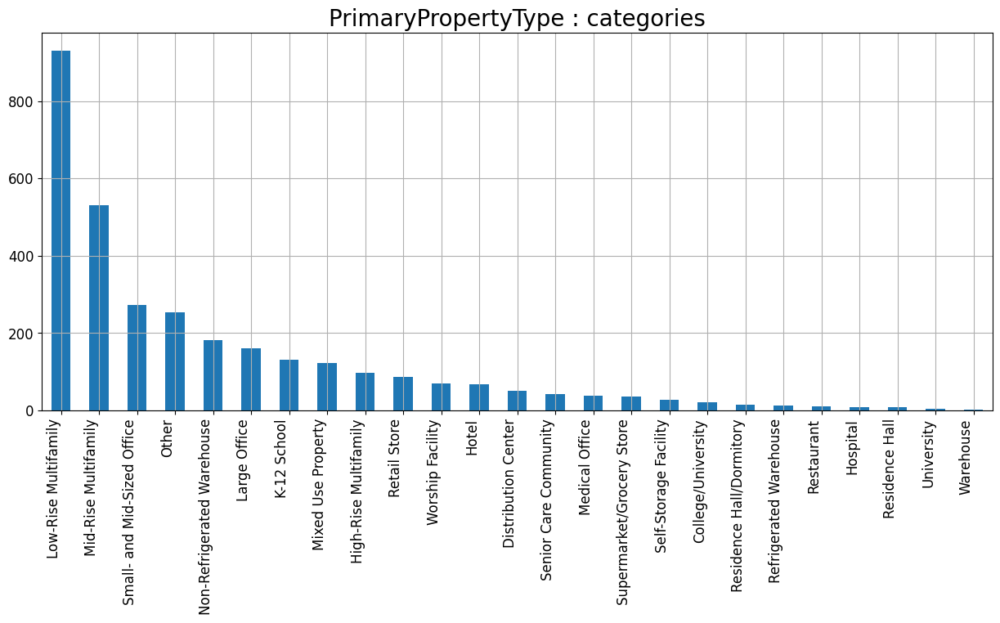

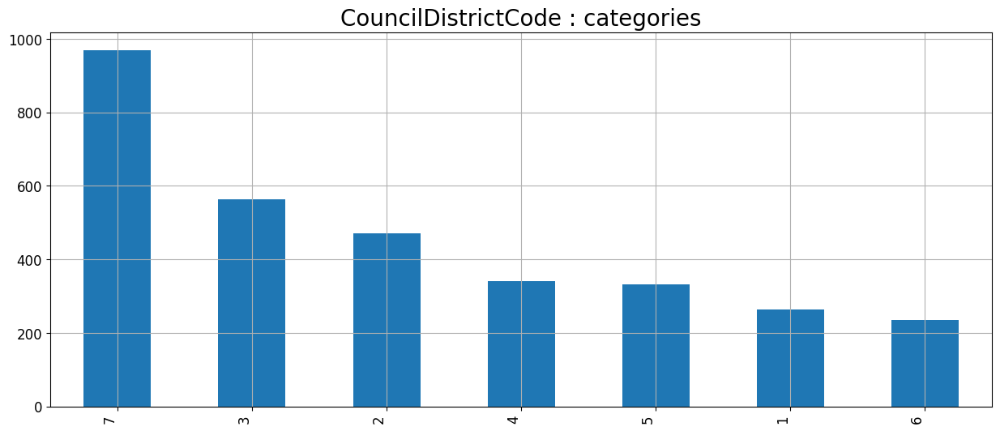

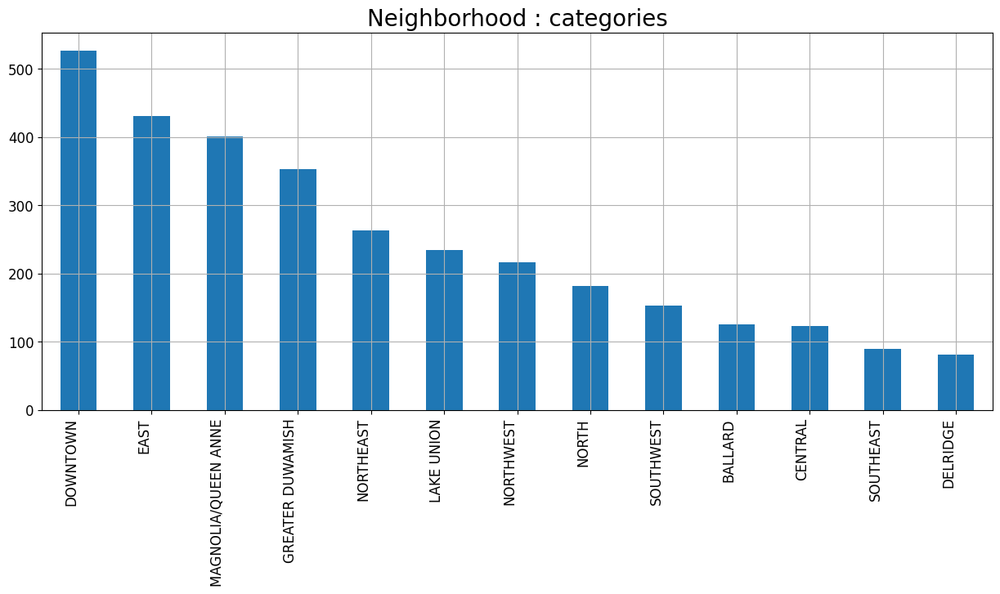

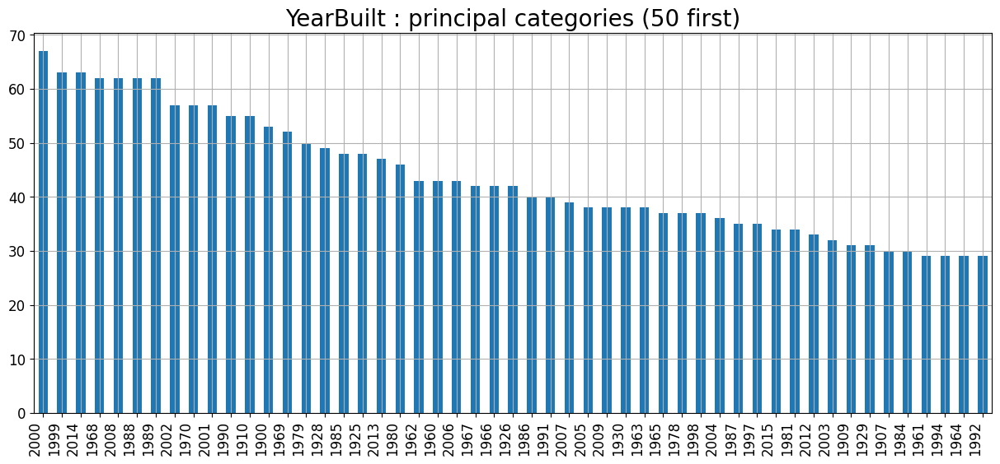

...

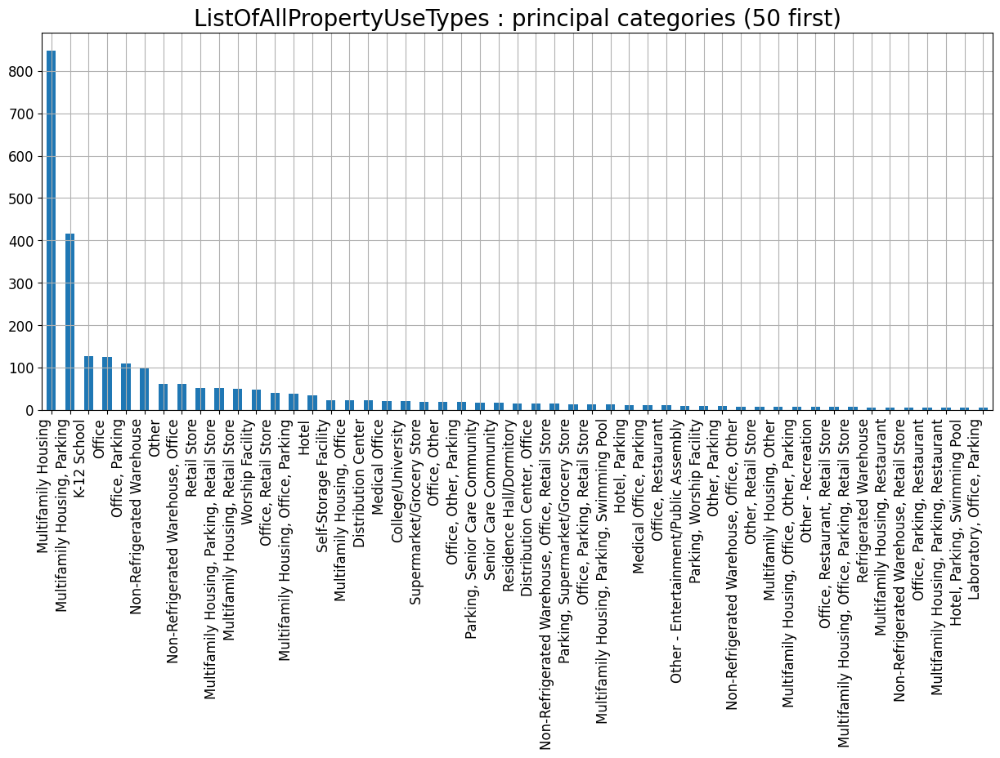

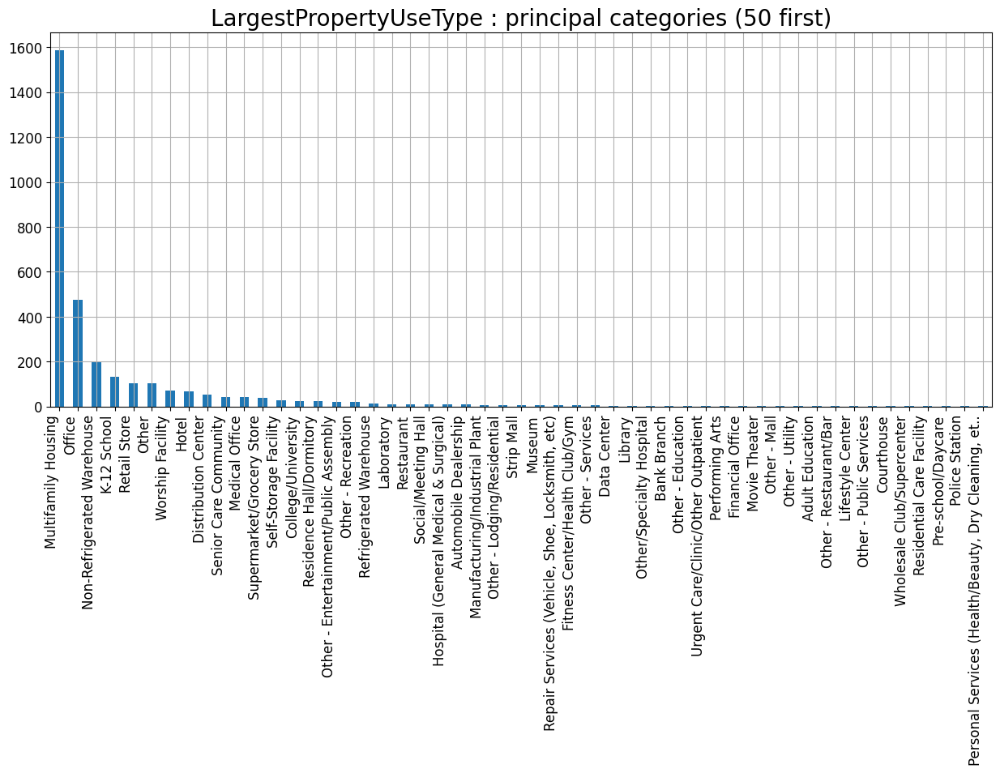

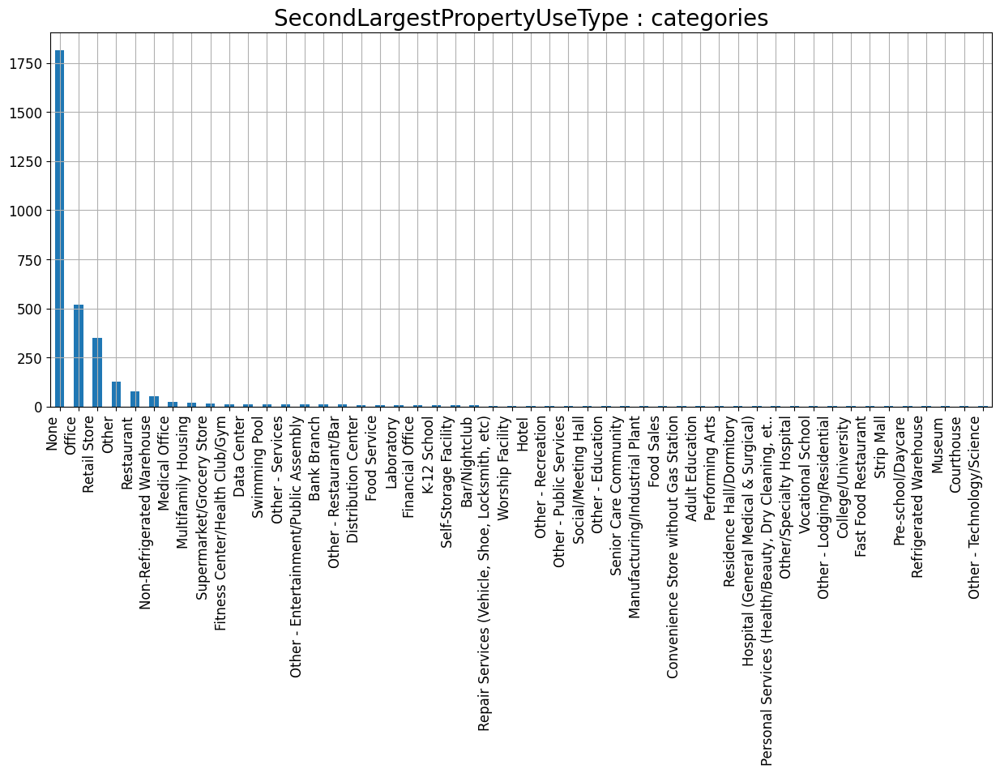

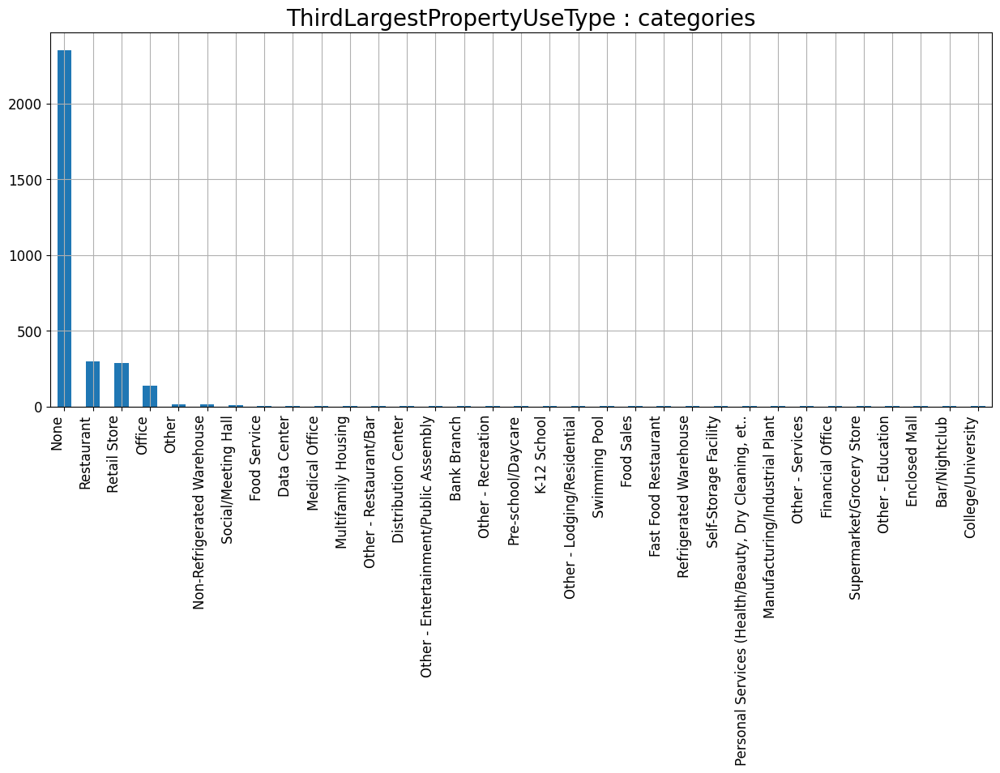

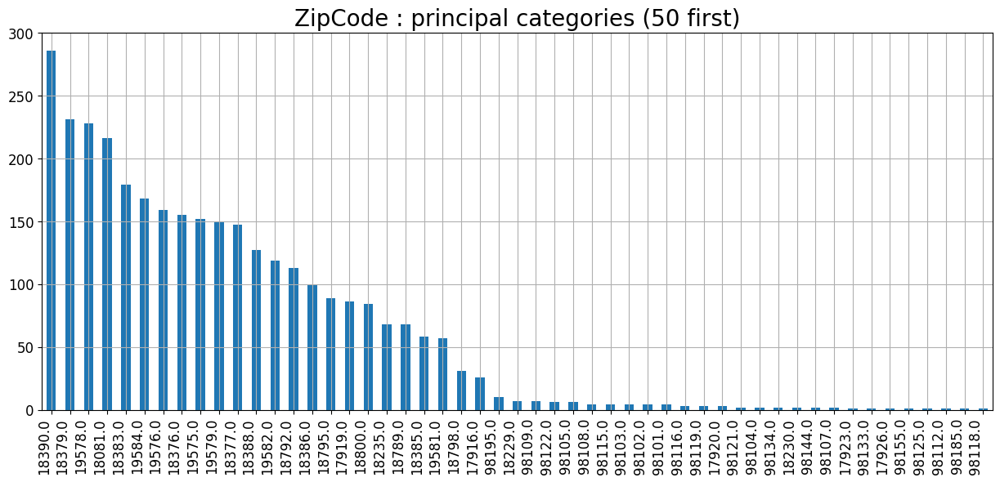

In [19]:
n = len(categ_cols)
ind = 0
for colonne in categ_cols:
    ind += 1
    DisplotData.plot_categ_bars(df_clean, colonne, seuil=1., max_bar=50, kind='bar', rot=90, show_nan=False)

- `'NumberofBuildings'` : n'a pas beaucoup de valeurs distinctes → proposée à la suppression.

#### Variables numériques

In [20]:
plt.rcParams['figure.figsize'] = [15, 6]
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

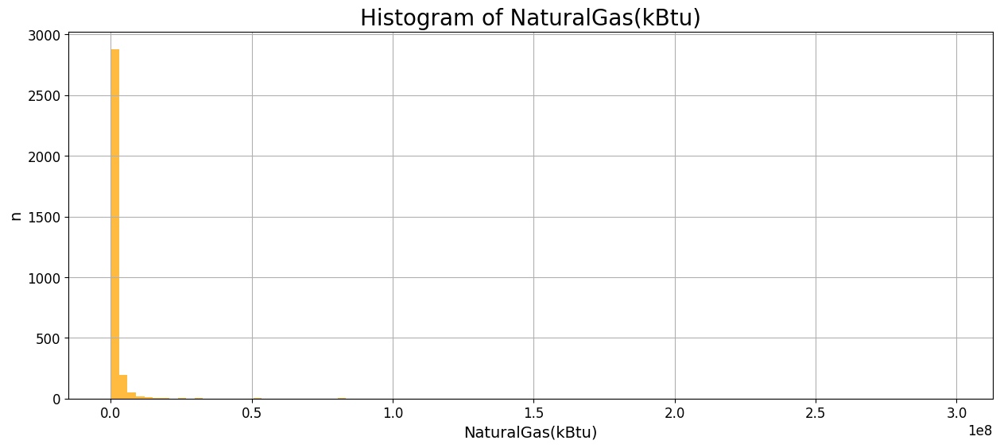

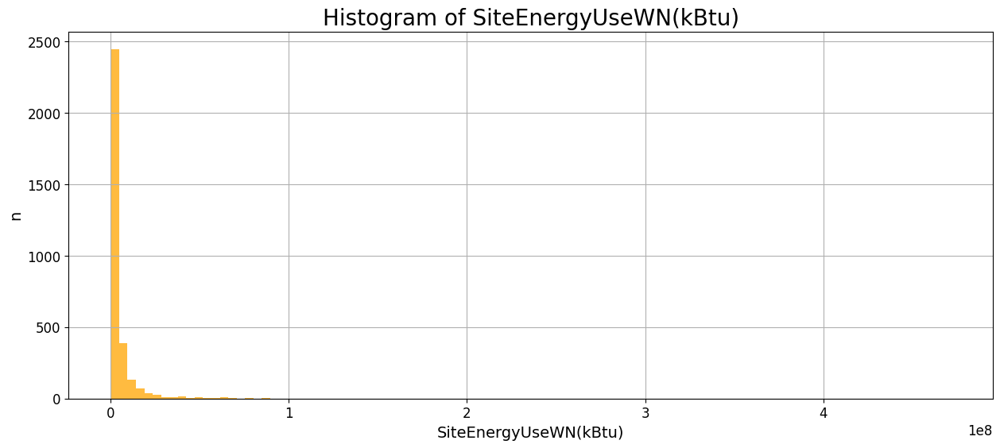

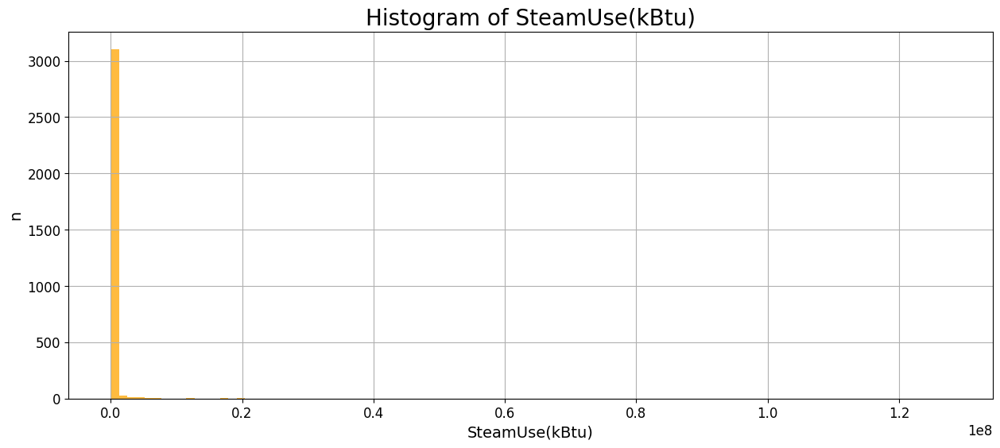

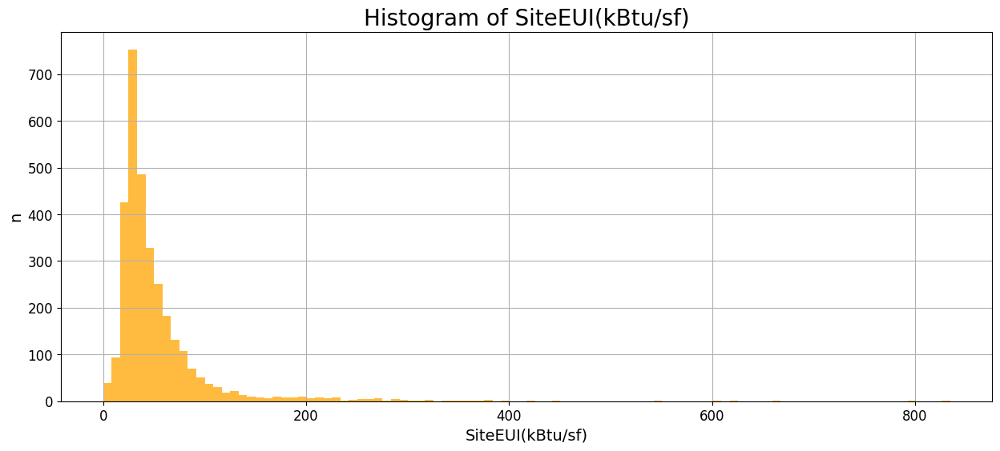

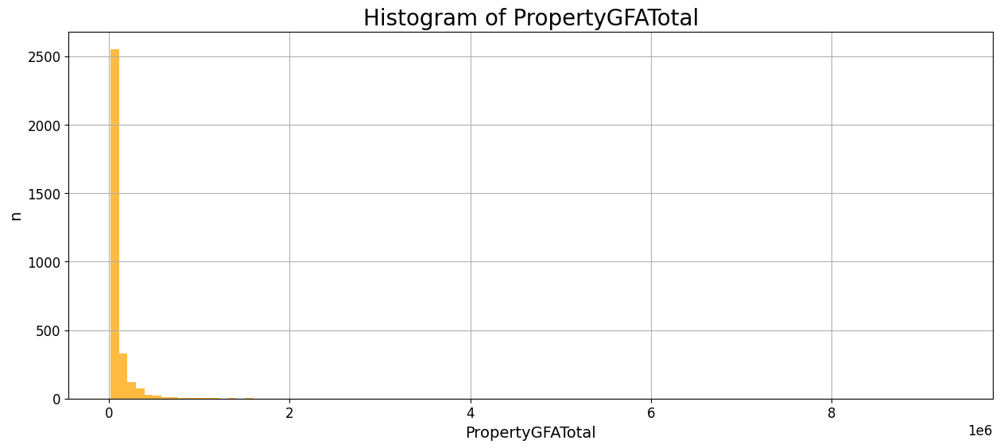

...

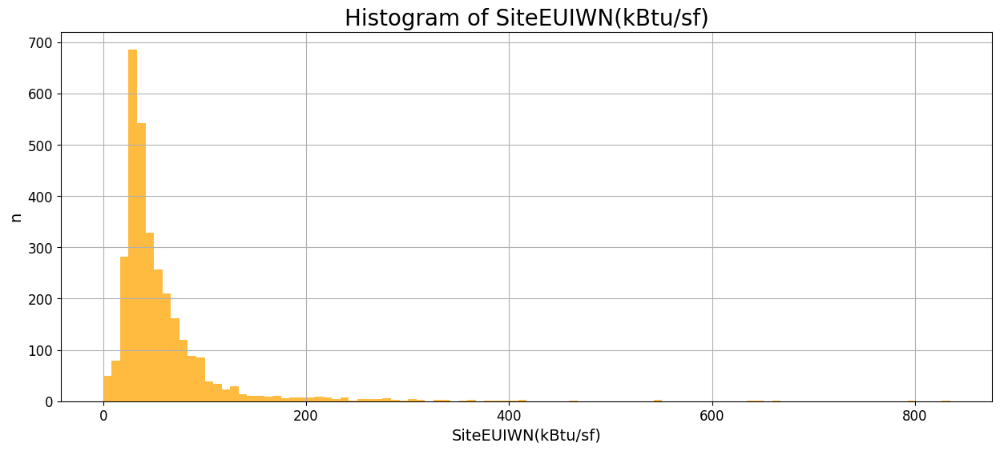

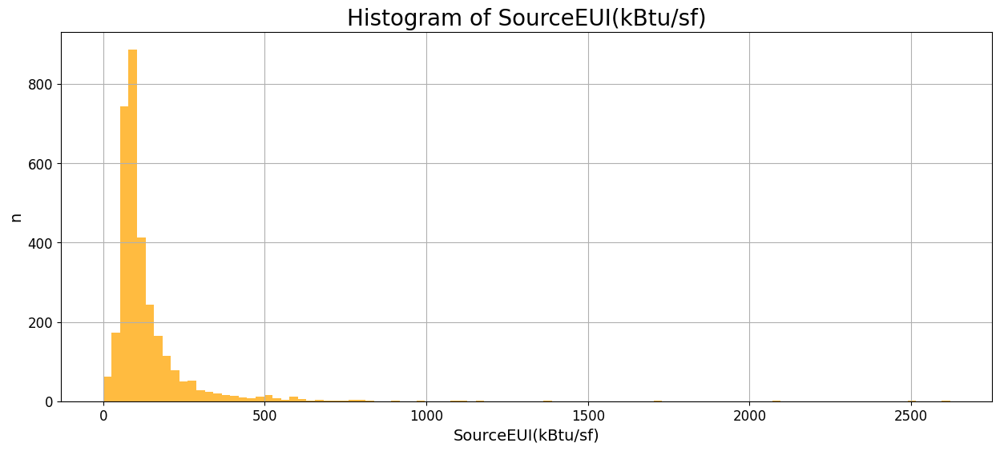

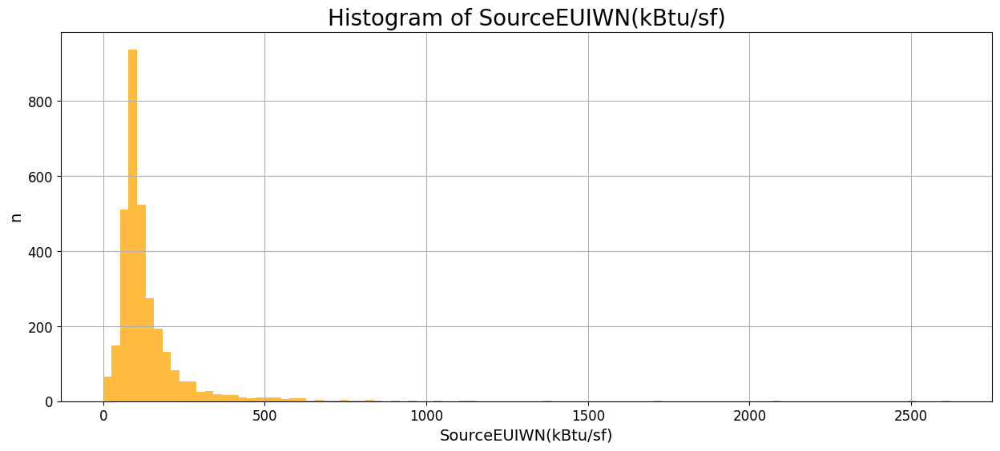

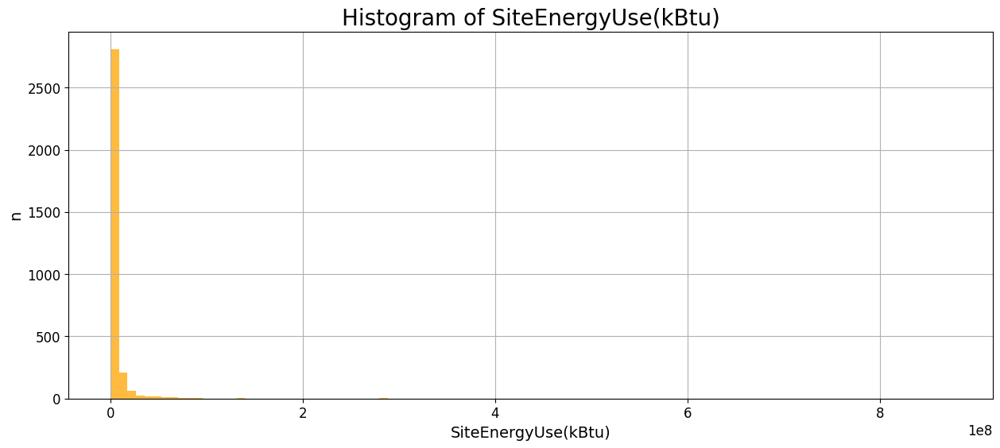

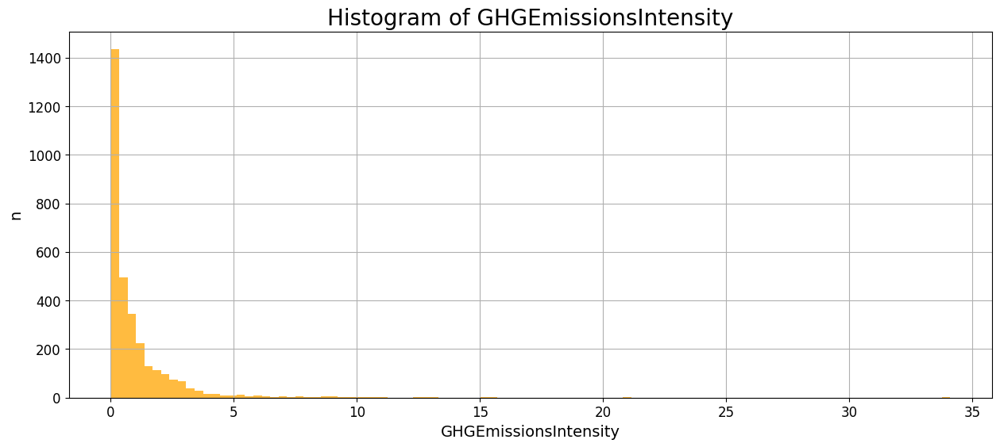

In [21]:
DisplotData.plot_distrib(df_clean, num_cols, nbins=100)

In [22]:
plt.rcParams['figure.figsize'] = [8, 4]
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

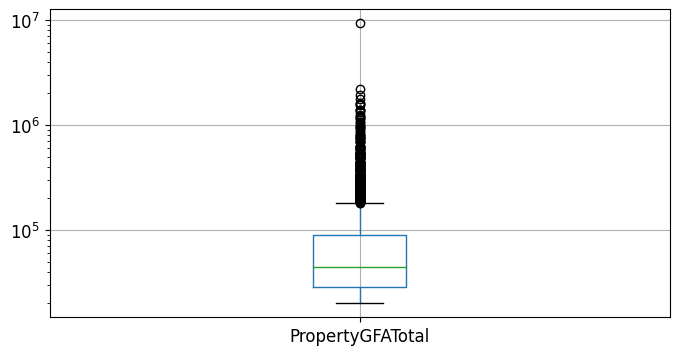

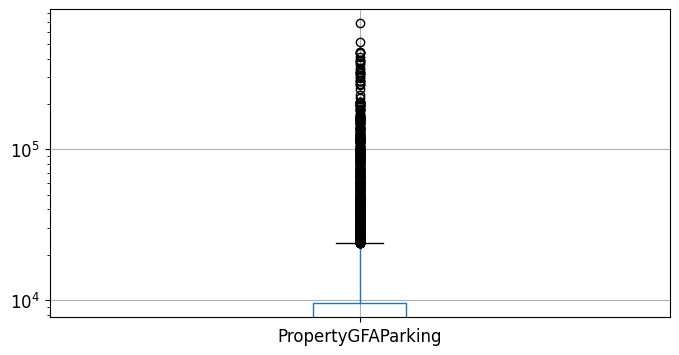

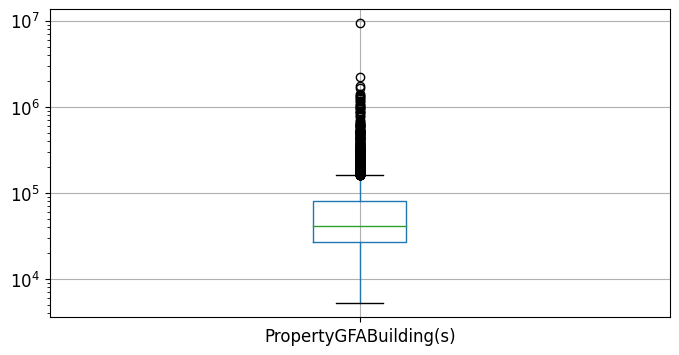

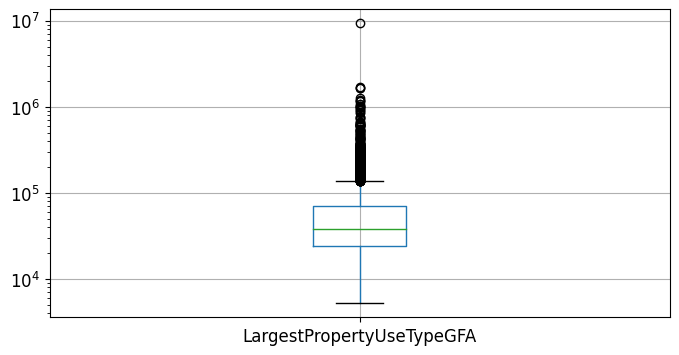

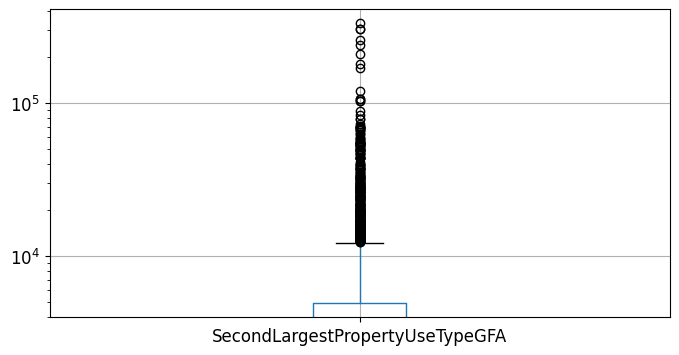

...

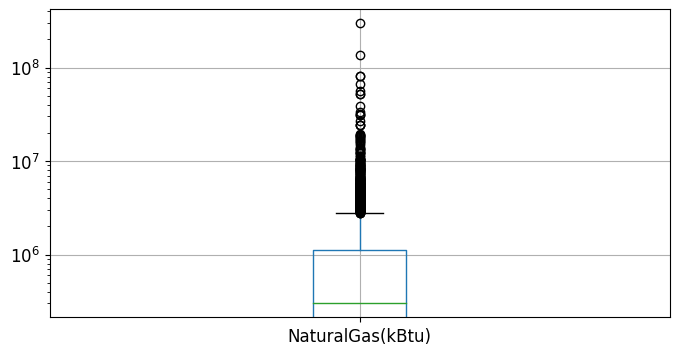

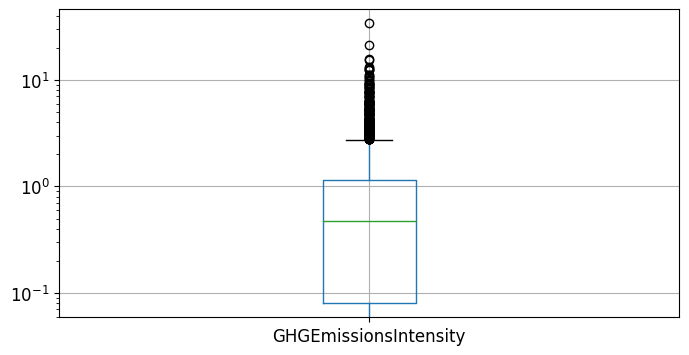

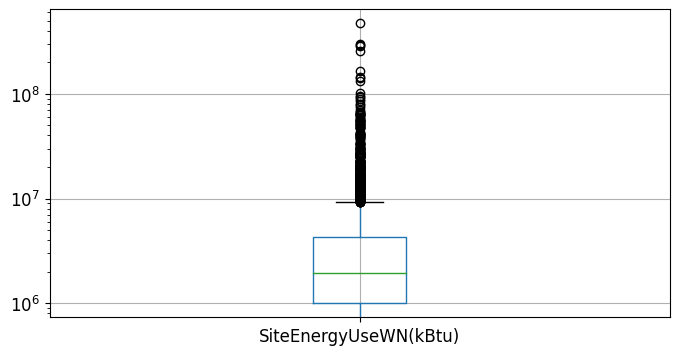

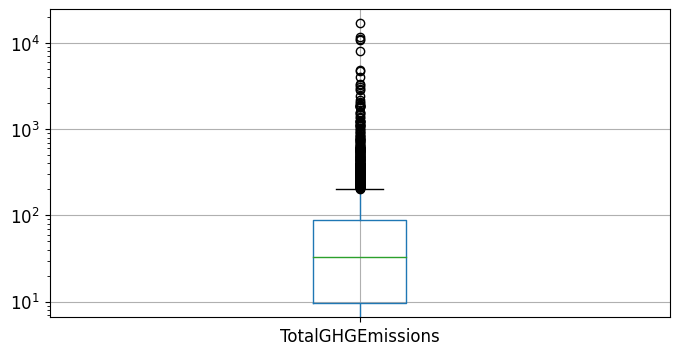

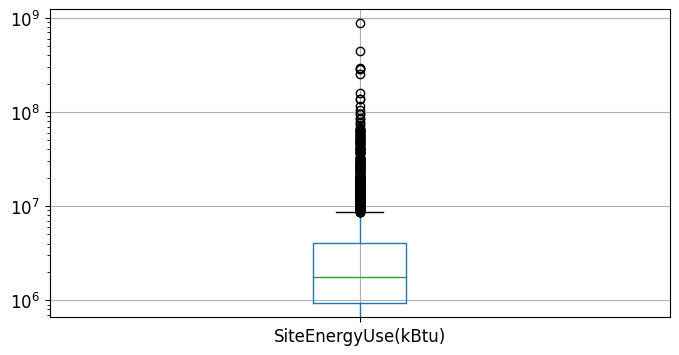

In [23]:
for col in num_cols:
    plt.figure()
    df_clean[[col]].boxplot()
    plt.yscale('log')
    plt.grid('on')

Les variables d'intensité ne sont pas homogènes (bcp d'outliers, moutache étendue) indique que la seule surface ne sera pas suffisante pour expliquer les disparités (puisque les intensités effacent cette notion de surface). 

In [24]:
plt.rcParams['figure.figsize'] = [6, 4]
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

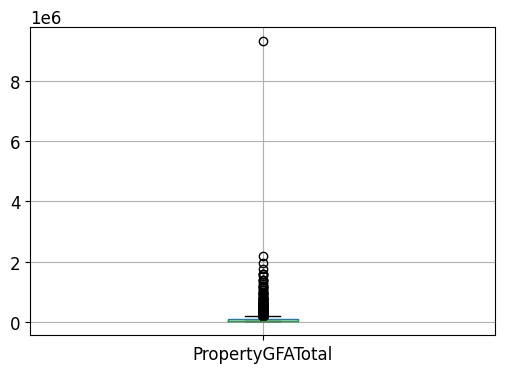

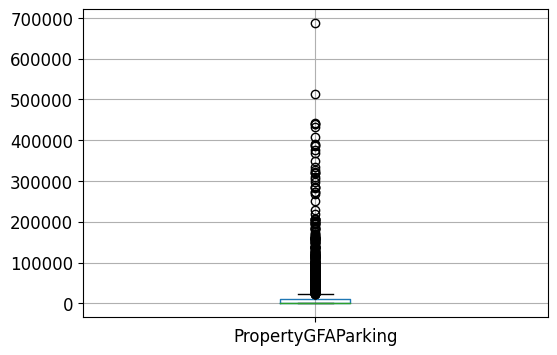

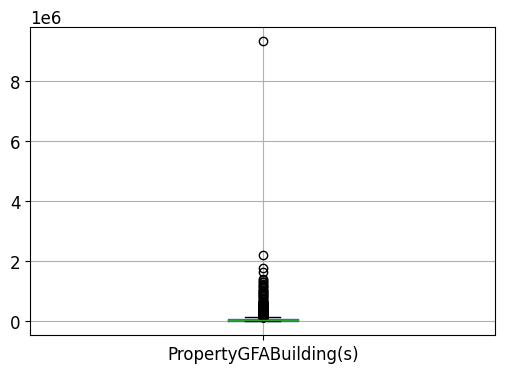

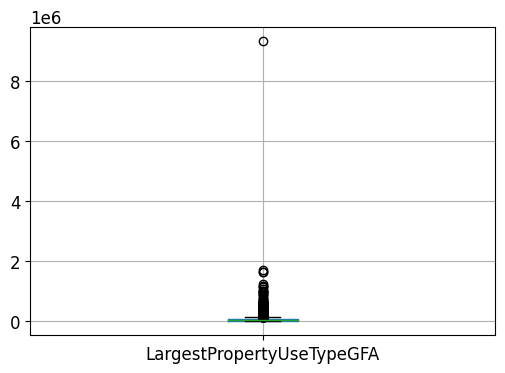

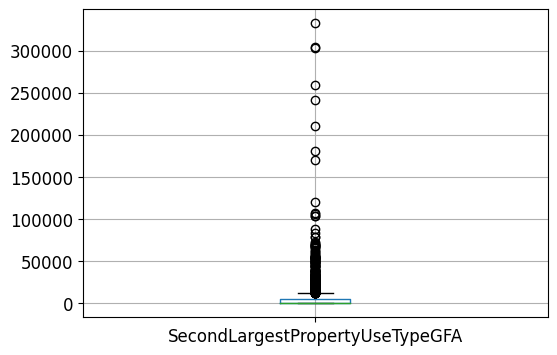

...

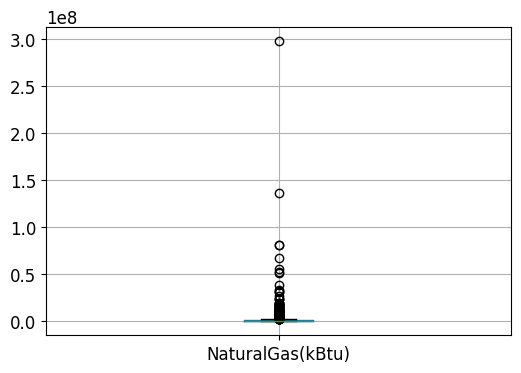

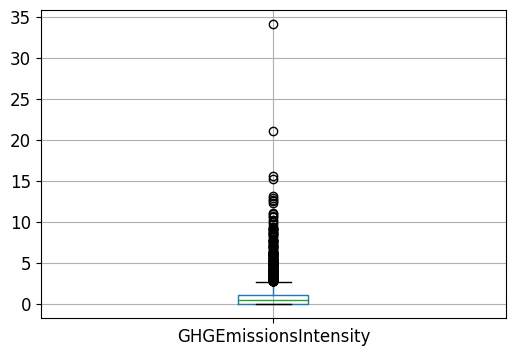

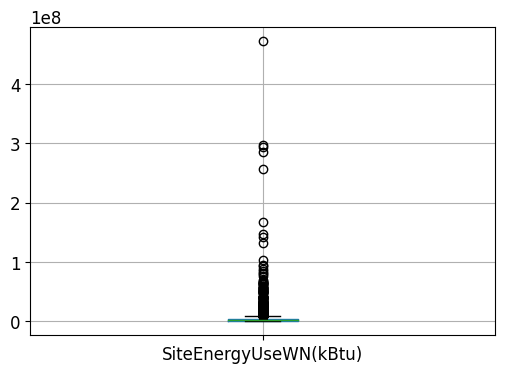

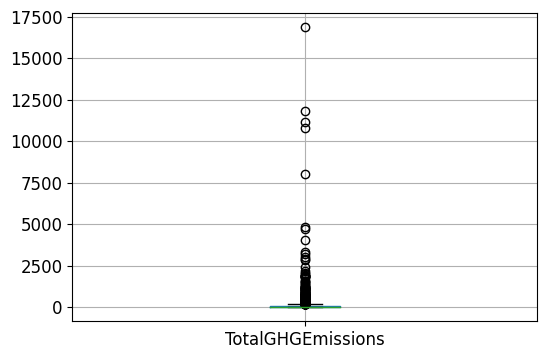

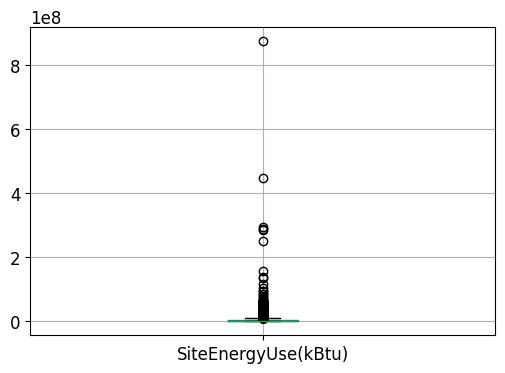

In [25]:
for col in num_cols:
    plt.figure()
    df_clean[[col]].boxplot()
    plt.grid('on')

La variable `SteamUse` est très particulière :

<AxesSubplot: >

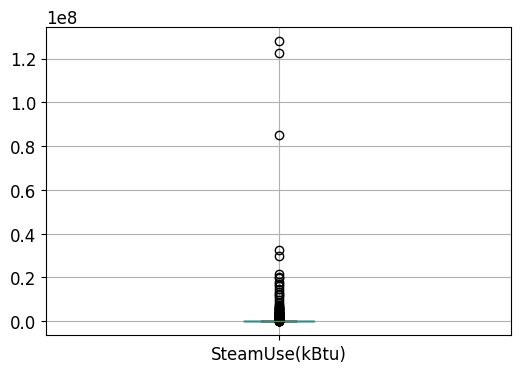

In [26]:
df_clean[['SteamUse(kBtu)']].boxplot()

#### Focus sur les sources d'énergie

Répartition globale des 3 sources :

Text(0.5, 1.0, 'Repartition of energy sources')

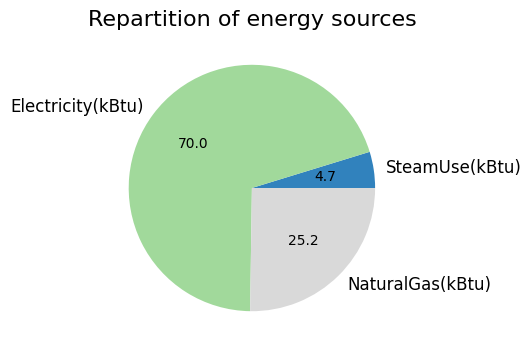

In [27]:
df_clean[['SteamUse(kBtu)', 'Electricity(kBtu)', 'NaturalGas(kBtu)']].mean(axis=0).plot.pie(colormap='tab20c',autopct='%.1f')
plt.title("Repartition of energy sources")

Les énergies ne sont pas en proportions égales, la vapeur peut éventuellement être ignorée, mais cela dépendra des types de bâtiment ou d'usage (voir études bivariées).

#### Comptage du nombre de sources d'énergie par propriété

In [28]:
df_clean = df_clean.copy()
df_clean['SteamUsed'] = 0
df_clean['ElecUsed'] = 0
df_clean['GasUsed'] = 0

df_clean.loc[df_clean['SteamUse(kBtu)']>0,'SteamUsed'] = 1
df_clean.loc[df_clean['Electricity(kBtu)']>0,'ElecUsed'] = 1
df_clean.loc[df_clean['NaturalGas(kBtu)']>0,'GasUsed'] = 1

In [29]:
df_clean[['SteamUse(kBtu)','Electricity(kBtu)','NaturalGas(kBtu)','SteamUsed','ElecUsed','GasUsed']].head(50)

,SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),SteamUsed,ElecUsed,GasUsed
0,2023032.0,3686160.0,1272388.0,1,1,1
4,0.0,6066245.0,8763105.0,0,1,1
5,0.0,7271004.0,4781283.0,0,1,1
7,2003108.0,4108004.0,315079.0,1,1,1
8,0.0,7355649.0,5278400.0,0,1,1
11,5426396.0,19058722.0,3232700.0,1,1,1
12,1987163.0,1615057.0,3205074.0,1,1,1
13,4731090.0,14090906.0,3990280.0,1,1,1
17,0.0,21932264.0,11339166.0,0,1,1
21,0.0,19677268.0,31222797.0,0,1,1


In [30]:
df_clean = df_clean.copy()
df_clean['NbUsedEnergies'] = df_clean[['SteamUsed', 'ElecUsed', 'GasUsed']].sum(axis=1)

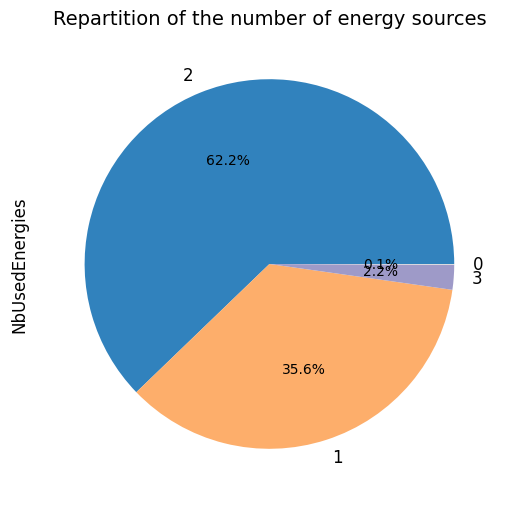

In [31]:
plt.rcParams['figure.figsize'] = [6, 6]
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
df_clean['NbUsedEnergies'].value_counts().plot.pie(colormap='tab20c',autopct='%.1f%%')
plt.title("Repartition of the number of energy sources");

Ah, il semble que certaines propriétés aient 0 source d'énergie !

In [32]:
df_clean.loc[df_clean['NbUsedEnergies']==0]

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
44,NonResidential,Retail Store,7,DOWNTOWN,1920,1.0,2.0,57428,0,57428,"Non-Refrigerated Warehouse, Other, Retail Store",Retail Store,34617.0,Non-Refrigerated Warehouse,13028.0,Other,9783.00000,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13028.0,0.0,9783.0,0.0,0.0,0.0,0.0,0.0,0.0
572,NonResidential,Large Office,7,DOWNTOWN,1929,1.0,27.0,216571,13320,203251,"Office, Other - Technology/Science, Parking",Office,182604.0,Other - Technology/Science,6246.0,Retail Store,5943.34375,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6246.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,182604.0


Mais cela peut ne faire que du bien aux algorithmes, d'avoir un point (0,0). 

## Etudes bivariées

On ajoute l'année de construction aux colonnes considérées comme numériques :

In [33]:
num_cols2 = ['YearBuilt',
            'PropertyGFATotal', 'PropertyGFAParking', 'PropertyGFABuilding(s)',
            'LargestPropertyUseTypeGFA', 
            'SecondLargestPropertyUseTypeGFA', 'ThirdLargestPropertyUseTypeGFA',
            'SiteEUI(kBtu/sf)', 'SiteEUIWN(kBtu/sf)', # not to be used as input for regressions
            'SourceEUI(kBtu/sf)', 'SourceEUIWN(kBtu/sf)', # not to be used as input for regressions
            'SteamUse(kBtu)', 'Electricity(kBtu)', 'NaturalGas(kBtu)', # not to be used as input for regressions
            'GHGEmissionsIntensity', # not to be used as input for regressions
            'SiteEnergyUseWN(kBtu)', # not to be used as input for regressions
            'TotalGHGEmissions', 'SiteEnergyUse(kBtu)']

#### Comparaison des distributions avant/après après imputations

In [161]:
df_nonan2 = df_nonan.copy()
df_nonan2['filled'] = 'NO'

df_clean2 = df_clean.copy()
df_clean2['filled'] = 'YES'

df_nan_imp = pd.concat([df_nonan2,df_clean2], axis=0)

Comparons les distributions avant et après l'imputation, avec la boîte des dispersions parallèles :

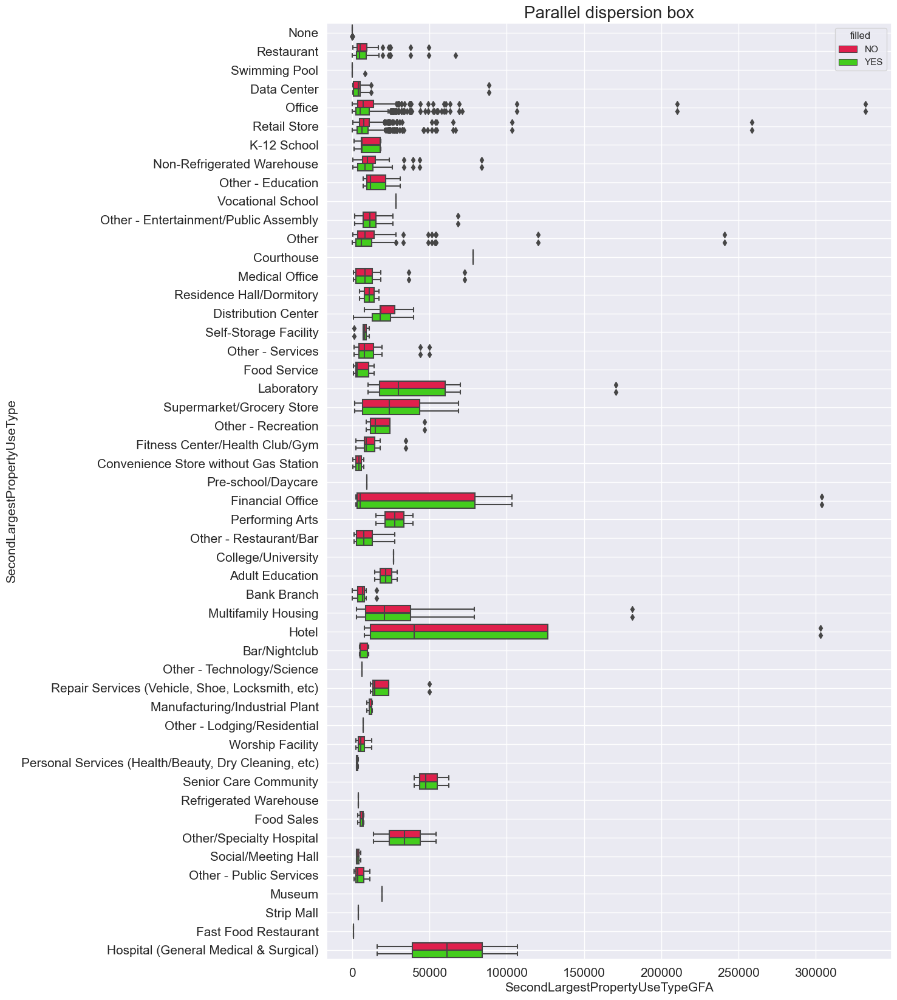

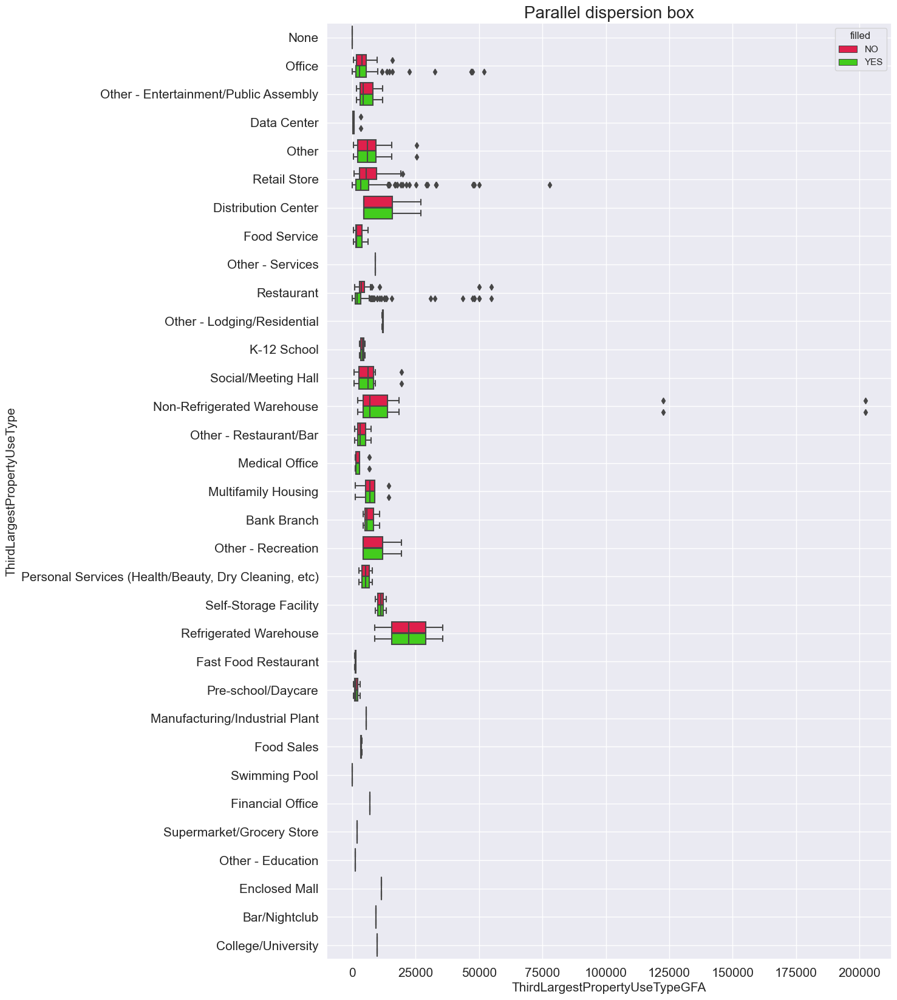

In [162]:
for col in ['SecondLargestPropertyUseType', 'ThirdLargestPropertyUseType']:
    f, ax = plt.subplots(figsize=(12, 20))
    sns.boxplot(data=df_nan_imp, x=col+'GFA', y=col, hue='filled', palette='prism_r', showfliers = True) # 'gist_rainbow_r', width=0.8, notch=True
    plt.title("Parallel dispersion box")
    plt.grid('on')

L'imputation semble s'être bien passée, il n'y a pas de perturbation majeure des min/max/Q1/Me/Q3. Par contre, on a créé des outliers (`SecondUseType` : `Retail Store, Other`. `ThirdUseType` : `Retail Store`, `Restaurant`)

#### Création de variables d'intensité 

Créons quelques variables d'intensité pour comparer les samples sur une même base (1 square feet), en écartant les parkings :

In [35]:
df_clean = df_clean.copy()

# FE_ = "FeatureEngineering"
df_clean['FE_SteamUseEUI_GFATotal'] = df_clean['SteamUse(kBtu)'] / df_clean['PropertyGFATotal']
df_clean['FE_NaturalGasEUI_GFATotal'] = df_clean['NaturalGas(kBtu)'] / df_clean['PropertyGFATotal']
df_clean['FE_ElectricityEUI_GFATotal'] = df_clean['Electricity(kBtu)'] / df_clean['PropertyGFATotal']
df_clean['FE_SteamUseEUI_GFABldng'] = df_clean['SteamUse(kBtu)'] / df_clean['PropertyGFABuilding(s)']
df_clean['FE_NaturalGasEUI_GFABldng'] = df_clean['NaturalGas(kBtu)'] / df_clean['PropertyGFABuilding(s)']
df_clean['FE_ElectricityEUI_GFABldng'] = df_clean['Electricity(kBtu)'] / df_clean['PropertyGFABuilding(s)']

# We will look at the intensity per unit NON-parking area
df_clean['FE_GHGEmissionsIntensity_GFABldng'] = df_clean['TotalGHGEmissions'] / df_clean['PropertyGFABuilding(s)']
df_clean['FE_SiteEUI_GFABldng'] = df_clean['SiteEnergyUse(kBtu)'] / df_clean['PropertyGFABuilding(s)']

Colonnes retenues pour les corrélations et autres comparaisons numériques :

In [36]:
correl_cols = ['YearBuilt', 'NumberofBuildings', 'NumberofFloors',
               'PropertyGFATotal', 'PropertyGFAParking', 'PropertyGFABuilding(s)',
               'LargestPropertyUseTypeGFA', 'SecondLargestPropertyUseTypeGFA',
               'ThirdLargestPropertyUseTypeGFA', 'ResidualGFA',
               'SiteEUI(kBtu/sf)',
#                'SiteEUIWN(kBtu/sf)',
               'SourceEUI(kBtu/sf)',
#                'SourceEUIWN(kBtu/sf)',
               'SiteEnergyUse(kBtu)',
#                'SiteEnergyUseWN(kBtu)',
               'SteamUse(kBtu)',
               'Electricity(kBtu)', 'NaturalGas(kBtu)',
#                'FE_SteamUseEUI_GFATotal', 'FE_NaturalGasEUI_GFATotal', 'FE_ElectricityEUI_GFATotal',
#                'FE_SteamUseEUI_GFABldng', 'FE_NaturalGasEUI_GFABldng', 'FE_ElectricityEUI_GFABldng',
               'TotalGHGEmissions','GHGEmissionsIntensity',
#                'FE_GHGEmissionsIntensity_GFABldng', 'FE_SiteEUI_GFABldng'
              ]

#### Catégorielles / numériques

**`'PrimaryPropertyType'` → `'GHGEmissionsIntensity'`**

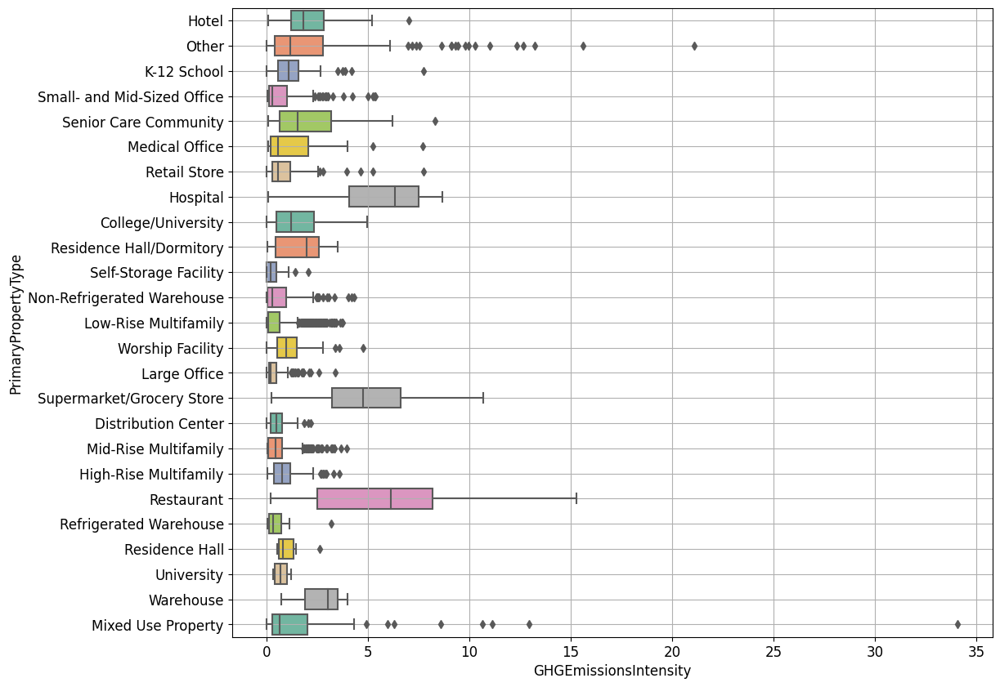

In [37]:
f, ax = plt.subplots(figsize=(12, 10))
sns.boxplot(data=df_clean, x='GHGEmissionsIntensity', y='PrimaryPropertyType', palette='Set2', showfliers = True) # 'gist_rainbow_r', width=0.8, notch=True, hue='filled', palette='prism_r'
plt.grid('on')

In [38]:
outl_GHG_PrimaryPropertyType = df_clean.loc[(df_clean['PrimaryPropertyType']=='Other') & (df_clean['GHGEmissionsIntensity']>10.)].index
outl_GHG_PrimaryPropertyType

Int64Index([1290, 2555, 3197, 3295, 1774, 819, 756], dtype='int64')

**`'BuildingType'` → `'FE_SiteEUI_GFABldng'`**

Intensité de consommation en fonction du type de bâtiment :

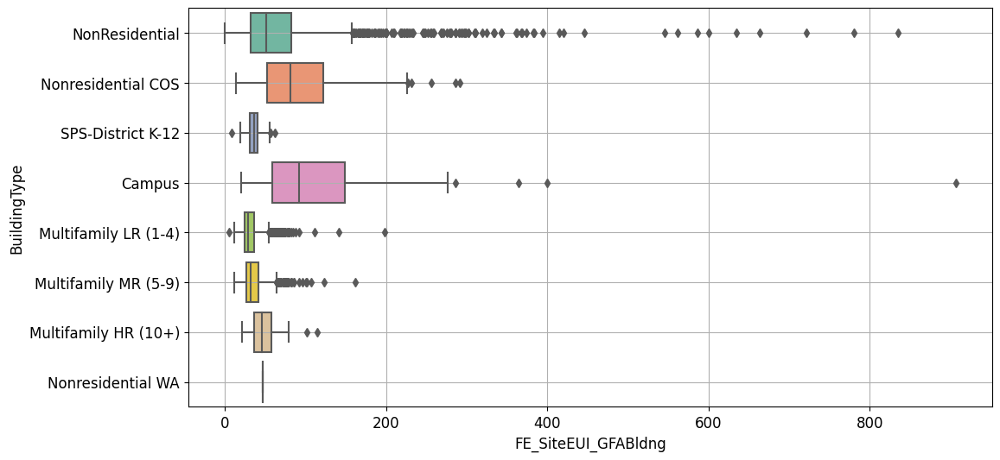

In [39]:
f, ax = plt.subplots(figsize=(12, 6))
a = sns.boxplot(data=df_clean, x='FE_SiteEUI_GFABldng', y='BuildingType', palette='Set2', showfliers=True) # 'gist_rainbow_r', width=0.8, notch=True, hue='filled', palette='prism_r'
#'LargestPropertyUseType', 'BuildingType'
plt.grid('on')

Récupération des outliers :

In [40]:
for val in df_clean['BuildingType'].unique():
    print(val)
    dfw = df_clean.loc[df_clean['BuildingType']==val,'FE_SiteEUI_GFABldng']
    outliers = boxplot_stats(dfw).pop(0)['fliers']
    print(outliers)

NonResidential
[209.07029774 175.29218283 222.06515195 285.76999317 230.3453045
 255.29898825 268.06961559 218.80131406 179.32638978 420.44362408
 310.61812223 177.5527025  292.41905959 233.55677985 342.41441464
 199.87677707 298.30704431 206.29690697 247.28489119 634.39609527
 185.93697614 168.27081006 191.30077398 360.68683175 158.28240774
 194.32840091 171.33391548 302.59229203 561.1191899  333.50204514
 166.17281503 299.15489149 302.66145698 173.76248878 367.67641823
 160.87912626 226.59142703 268.84594732 285.80857607 245.18770582
 195.7128873  278.58643593 394.65463347 309.58271568 186.19475054
 189.42465954 325.09745412 343.34755892 333.86205221 368.93723684
 281.02638811 218.85841432 182.29108308 166.85993957 226.56447471
 294.45107865 269.41156573 544.94573962 586.39748736 166.98118841
 834.4025     252.02338571 176.89677871 168.62912773 166.14747907
 209.53121377 248.69669681 170.16812842 310.79950039 225.02128996
 160.88252386 158.49597493 663.39974616 199.78129261 228.30266

In [41]:
boxplot_stats(dfw)

[{'mean': 46.72727773533905,
  'iqr': 0.0,
  'cilo': 46.72727773533905,
  'cihi': 46.72727773533905,
  'whishi': 46.72727773533905,
  'whislo': 46.72727773533905,
  'fliers': array([], dtype=float64),
  'q1': 46.72727773533905,
  'med': 46.72727773533905,
  'q3': 46.72727773533905}]

In [42]:
df_truc = df_clean.sort_values(by='PropertyGFABuilding(s)', ascending=False)
df_truc

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
6614,Campus,University,4,NORTHEAST,1900,111.0,0.0,9320156,0,9320156,College/University,College/University,9320156.0,None,0.000000,None,0.000000,NaN,93.800003,0.0,246.600006,0.0,873923712.0,0.0,84985240.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
1508,Campus,College/University,3,EAST,1939,39.0,2.0,2200000,318960,2200000,"College/University, Parking",College/University,1719643.0,Restaurant,66903.262752,Retail Store,77909.156250,NaN,66.900000,76.4,146.100000,158.3,115080128.0,131427232.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
621,NonResidential,Hospital,3,EAST,1994,1.0,14.0,1765970,441551,1765970,"Hospital (General Medical & Surgical), Parking",Hospital (General Medical & Surgical),1639334.0,Office,71238.656546,Retail Store,29206.544922,59.0,174.900000,178.6,374.600000,372.0,286685536.0,292746272.0,127869744.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.123866e+04
581,NonResidential,Large Office,7,DOWNTOWN,1985,1.0,76.0,1952220,319400,1632820,"Office, Parking",Office,1632820.0,None,0.000000,None,0.000000,84.0,56.300000,55.5,171.900000,169.1,94560088.0,93255440.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.632820e+06
305,NonResidential,Other,7,DOWNTOWN,1990,1.0,6.0,1400000,686750,1400000,"Convention Center, Parking",Convention Center,1072000.0,Office,69351.215712,Retail Store,29804.746094,NaN,72.000000,73.7,192.500000,191.3,77164568.0,79041984.0,16811018.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.935122e+04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3023,Nonresidential COS,Other,6,NORTHWEST,2004,1.0,1.0,27376,14570,12806,"Library, Parking",Library,12806.0,None,0.000000,None,0.000000,NaN,87.500000,96.2,201.400000,204.2,1120272.0,1231646.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
3219,Multifamily LR (1-4),Low-Rise Multifamily,7,MAGNOLIA/QUEEN ANNE,2012,2.0,3.0,21753,10642,11111,Multifamily Housing,Multifamily Housing,11111.0,None,0.000000,None,0.000000,41.0,37.300000,43.1,101.600000,114.1,812422.0,937637.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
841,NonResidential,Mixed Use Property,7,DOWNTOWN,2006,1.0,2.0,33792,22867,10925,"Other - Entertainment/Public Assembly, Parking...",Social/Meeting Hall,8969.0,Ot

In [43]:
df_truc.loc[6614, ['Electricity(kBtu)', 'SteamUse(kBtu)', 'NaturalGas(kBtu)']].sum()

742059629.0

In [44]:
df_truc.loc[6614, ['SiteEnergyUse(kBtu)']]

SiteEnergyUse(kBtu)    873923712.0
Name: 6614, dtype: object

In [45]:
df_truc.loc[df_truc['NumberofBuildings']>100]

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
6614,Campus,University,4,NORTHEAST,1900,111.0,0.0,9320156,0,9320156,College/University,College/University,9320156.0,None,0.0,None,0.0,NaN,93.800003,0.0,246.600006,0.0,873923712.0,0.0,84985240.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


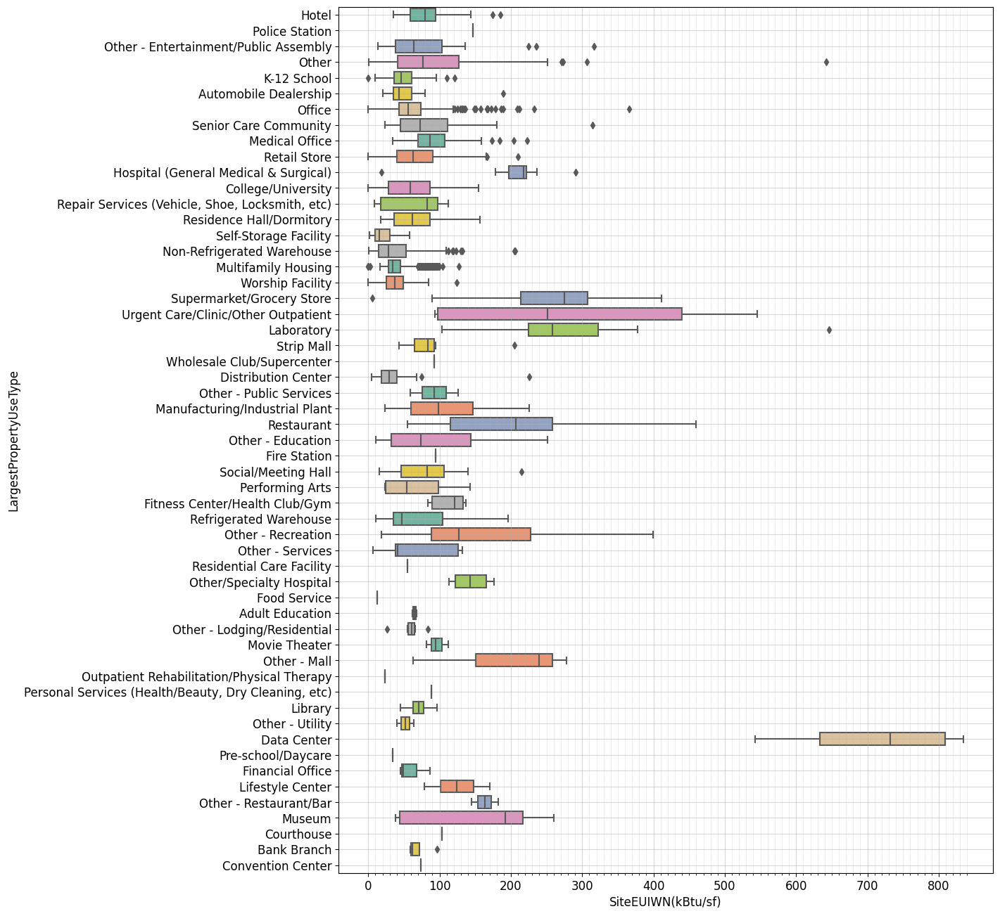

In [47]:
f, ax = plt.subplots(figsize=(12, 16))
sns.boxplot(data=df_clean, x='SiteEUIWN(kBtu/sf)', y='LargestPropertyUseType', palette='Set2', showfliers = True) # 'gist_rainbow_r', width=0.8, notch=True, hue='filled', palette='prism_r'

major_ticks = np.arange(0, 850, 100)
minor_ticks = np.arange(0, 850, 10)
ax.set_xticks(major_ticks)
ax.set_xticks(minor_ticks, minor=True)
ax.grid('on', which='both')
ax.grid(which='minor', alpha=0.2)
ax.grid(which='major', alpha=0.5)

**`'LargestPropertyUseType'` → `'SiteEnergyUse(kBtu)'`**

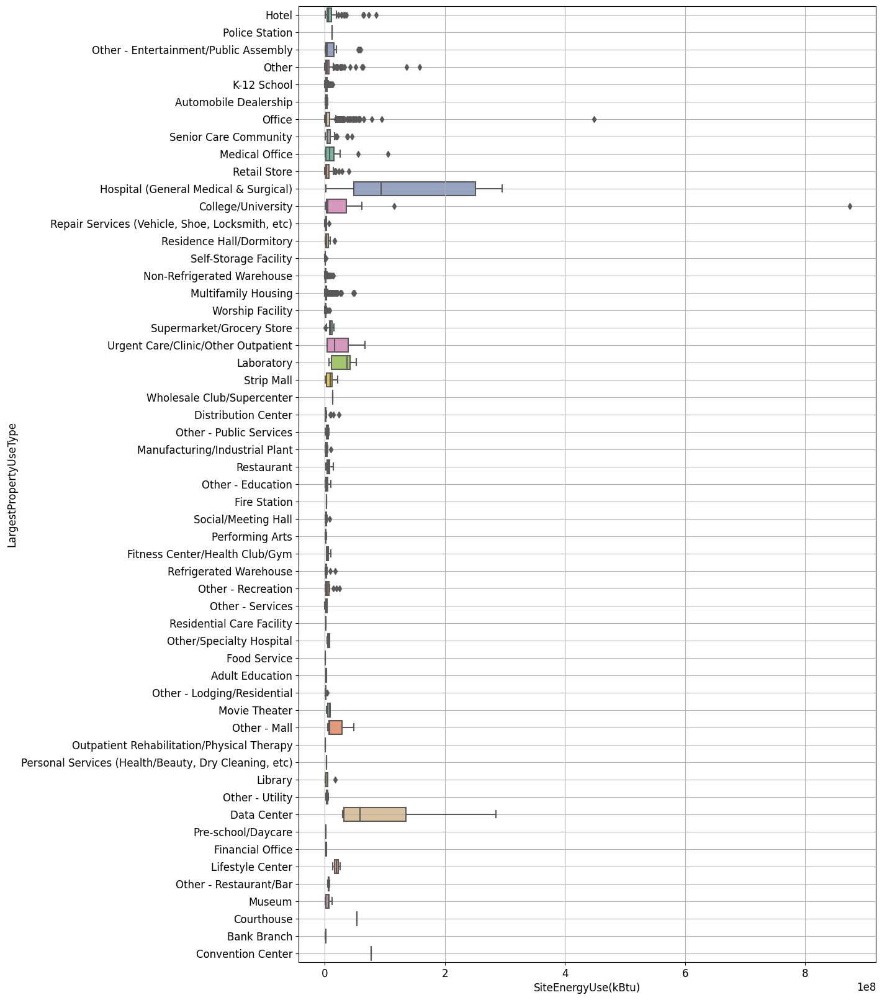

In [48]:
f, ax = plt.subplots(figsize=(12, 20))
sns.boxplot(data=df_clean, x='SiteEnergyUse(kBtu)', y='LargestPropertyUseType', palette='Set2', showfliers = True) # 'gist_rainbow_r', width=0.8, notch=True, hue='filled', palette='prism_r'
plt.grid('on')

Seuils in/out liers :[-3745994.1250 ; 8721518.8750]
df_inliers :
------------
       CouncilDistrictCode  YearBuilt  NumberofBuildings  NumberofFloors  \
count            15.000000    15.0000          15.000000       15.000000   
mean              4.266667  1958.4000           1.333333        2.466667   
std               1.791514    35.0465           1.290994        0.915475   
min               2.000000  1910.0000           1.000000        1.000000   
25%               3.000000  1924.5000           1.000000        2.000000   
50%               4.000000  1962.0000           1.000000        2.000000   
75%               5.500000  1986.0000           1.000000        3.000000   
max               7.000000  2013.0000           6.000000        4.000000   

       PropertyGFATotal  PropertyGFAParking  PropertyGFABuilding(s)  \
count         15.000000           15.000000               15.000000   
mean       57281.800000         1016.200000            56265.600000   
std        33927.315995 

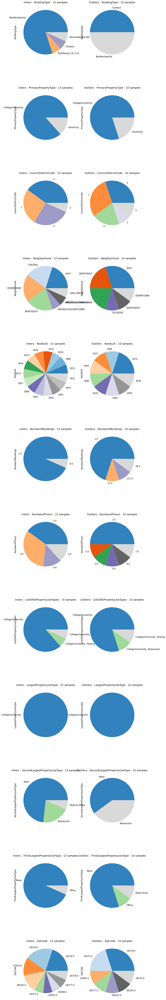

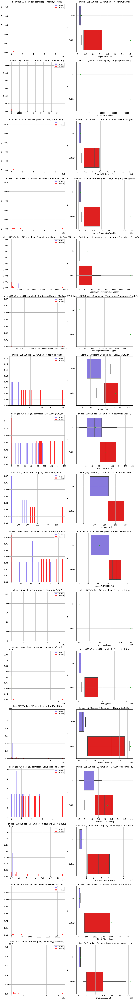

In [49]:
lier_var = 'SiteEnergyUse(kBtu)'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'College/University'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(df_clean,lier_var,lier_cat,lier_cat_val,categ_cols,num_cols,side='high')

In [50]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
105,Campus,College/University,1,DELRIDGE,1970,1.0,2.0,441071,0,441071,College/University,College/University,441071.0,None,-5.820766e-11,None,0.00000,NaN,77.500000,86.6,189.100000,201.9,37430780.0,41809228.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000
127,Campus,College/University,5,NORTHWEST,1970,11.0,2.0,694072,111625,582447,College/University,College/University,582447.0,None,0.000000e+00,None,0.00000,NaN,55.600000,59.2,162.300000,169.8,37117212.0,39513408.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000
3152,NonResidential,College/University,3,EAST,2006,1.0,5.0,84000,0,84000,College/University,College/University,84000.0,None,0.000000e+00,None,0.00000,NaN,146.100000,154.3,270.100000,272.3,12315998.0,13003462.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000
3302,NonResidential,College/University,3,EAST,1925,1.0,3.0,428347,0,428347,College/University,College/University,428347.0,None,-5.820766e-11,None,0.00000,NaN,77.000000,83.6,180.800000,185.2,36367960.0,39483712.0,13254980.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000
6614,Campus,University,4,NORTHEAST,1900,111.0,0.0,9320156,0,9320156,College/University,College/University,9320156.0,None,0.000000e+00,None,0.00000,NaN,93.800003,0.0,246.600006,0.0,873923712.0,0.0,84985240.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000
6617,NonResidential,University,4,NORTHEAST,1998,1.0,6.0,203030,0,203030,College/University,College/University,203030.0,None,0.000000e+00,None,0.00000,NaN,252.000000,0.0,561.000000,0.0,51168308.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000
24,NonResidential,College/University,7,DOWNTOWN,1928,1.0,7.0,126593,0,126593,College/University,College/University,125000.0,Restaurant,1.593000e+03,None,0.00000,NaN,78.300000,90.9,158.900000,172.1,9791557.0,11360926.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000
2351,Campus,College/University,7,MAGNOLIA/QUEEN ANNE,1945,1.0,2.0,537000,0,537000,College/University,College/University,533826.0,Restaurant,3.174000e+03,None,0.00000,NaN,116.100000,129.8,214.100000,228.5,61984596.0,69311976.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000
2350,NonResidential,College/University,7,MAGNOLIA/QUEEN ANNE,1959,1.0,2.0,122679,0,122679,"College/University, Restaurant",College/University,101035.0,Restaurant,2.000000e+03,Office,2476.10498

Dans la valeur `'College/University'` de la catégorie `'LargestPropertyUseType'`, le sample d'index 6614 est un outlier très, très important concernant la consommation **d'énergie totale**. Il risque de perturber les entraînements ou le scoring des algorithmes. Vérifions que ce n'est pas simplement dû à sa surface très élevée, en regardant les **intensités** de consommation. 

In [51]:
df_w = df_clean.loc[df_clean['LargestPropertyUseType']=='College/University','SiteEnergyUse(kBtu)']
indices = np.where(zscore(df_w) > 2)[0]
df_outliers = df_w.iloc[indices]
df_outliers

6614    873923712.0
Name: SiteEnergyUse(kBtu), dtype: float64

In [52]:
df_clean.FE_SteamUseEUI_GFABldng

0       22.876179
4        0.000000
5        0.000000
7       19.492882
8        0.000000
          ...    
6665     0.000000
6666     0.000000
6672     0.000000
6684     0.000000
6689     0.000000
Name: FE_SteamUseEUI_GFABldng, Length: 3180, dtype: float64

In [53]:
df_w = df_clean.loc[df_clean['LargestPropertyUseType']=='College/University', 'FE_ElectricityEUI_GFABldng']
indices = np.where(zscore(df_w) > 2)[0]
df_outliers = df_w.iloc[indices]
df_outliers

6617    140.937856
Name: FE_ElectricityEUI_GFABldng, dtype: float64

<AxesSubplot: >

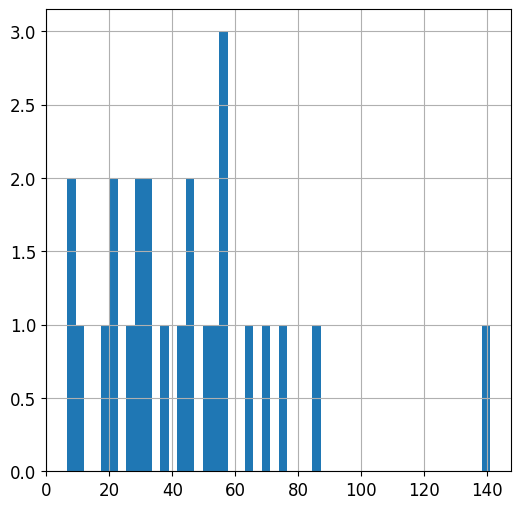

In [54]:
df_w.hist(bins=50)

In [55]:
zscore(df_w)

104    -0.540186
105     0.407148
114     0.282856
127     0.426486
583    -1.250583
635     1.449664
779    -1.201188
907    -0.777857
2806   -0.931334
3151   -0.458399
3152    0.394379
3293   -0.429063
3302    0.198109
6614    0.901314
6615    0.647685
6617    3.373713
6699    0.066864
2179    1.094135
24     -0.302651
777    -1.341508
2351   -0.033625
3301   -0.790447
2350    0.056413
1508   -0.577453
2823   -0.664472
Name: FE_ElectricityEUI_GFABldng, dtype: float64

In [56]:
df_clean.loc[df_clean['LargestPropertyUseType']=='College/University']

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
104,NonResidential,College/University,3,EAST,1915,1.0,3.0,63330,0,63330,College/University,College/University,6.333000e+04,None,0.000000e+00,None,0.000000,NaN,42.500000,48.800000,104.700000,111.400000,2.755578e+06,3.165935e+06,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
105,Campus,College/University,1,DELRIDGE,1970,1.0,2.0,441071,0,441071,College/University,College/University,4.410710e+05,None,-5.820766e-11,None,0.000000,NaN,77.500000,86.600000,189.100000,201.900000,3.743078e+07,4.180923e+07,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
114,NonResidential,College/University,7,MAGNOLIA/QUEEN ANNE,1980,1.0,2.0,52611,0,52611,College/University,College/University,5.261100e+04,None,0.000000e+00,None,0.000000,NaN,83.600000,93.700000,198.300000,208.900000,4.399828e+06,4.930107e+06,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
127,Campus,College/University,5,NORTHWEST,1970,11.0,2.0,694072,111625,582447,College/University,College/University,5.824470e+05,None,0.000000e+00,None,0.000000,NaN,55.600000,59.200000,162.300000,169.800000,3.711721e+07,3.951341e+07,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
583,NonResidential,College/University,3,CENTRAL,1916,1.0,2.0,60122,0,60122,"College/University, Parking",College/University,6.012200e+04,None,0.000000e+00,None,0.000000,NaN,9.200000,11.500000,28.900000,36.100000,5.527290e+05,6.908200e+05,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
635,NonResidential,College/University,3,CENTRAL,1974,1.0,4.0,76700,0,76700,College/University,College/University,7.670000e+04,None,0.000000e+00,None,0.000000,NaN,61.500000,62.700000,185.700000,186.900000,7.011508e+06,7.146047e+06,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
779,NonResidential,College/University,7,DOWNTOWN,1928,1.0,3.0,21600,0,21600,College/University,College/University,2.160000e+04,None,0.000000e+00,None,0.000000,NaN,14.600000,17.400000,37.500000,43.000000,3.154680e+05,3.764180e+05,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
907,NonResidential,College/University,7,DOWNTOWN,1910,1.0,3.0,28800,0,28800,College/University,College/University,2.880000e+04,None,0.000000e+00,None,0.000000,NaN,25.400000,28.200000,74.000000,80.900000,7.313150e+05,8.115950e+05,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
2806,Multifamily LR (1-4),

**`'LargestPropertyUseType'` → `'FE_SiteEUI_GFABldng'`**

Intensité de consommation en fonction de l'usage principal :

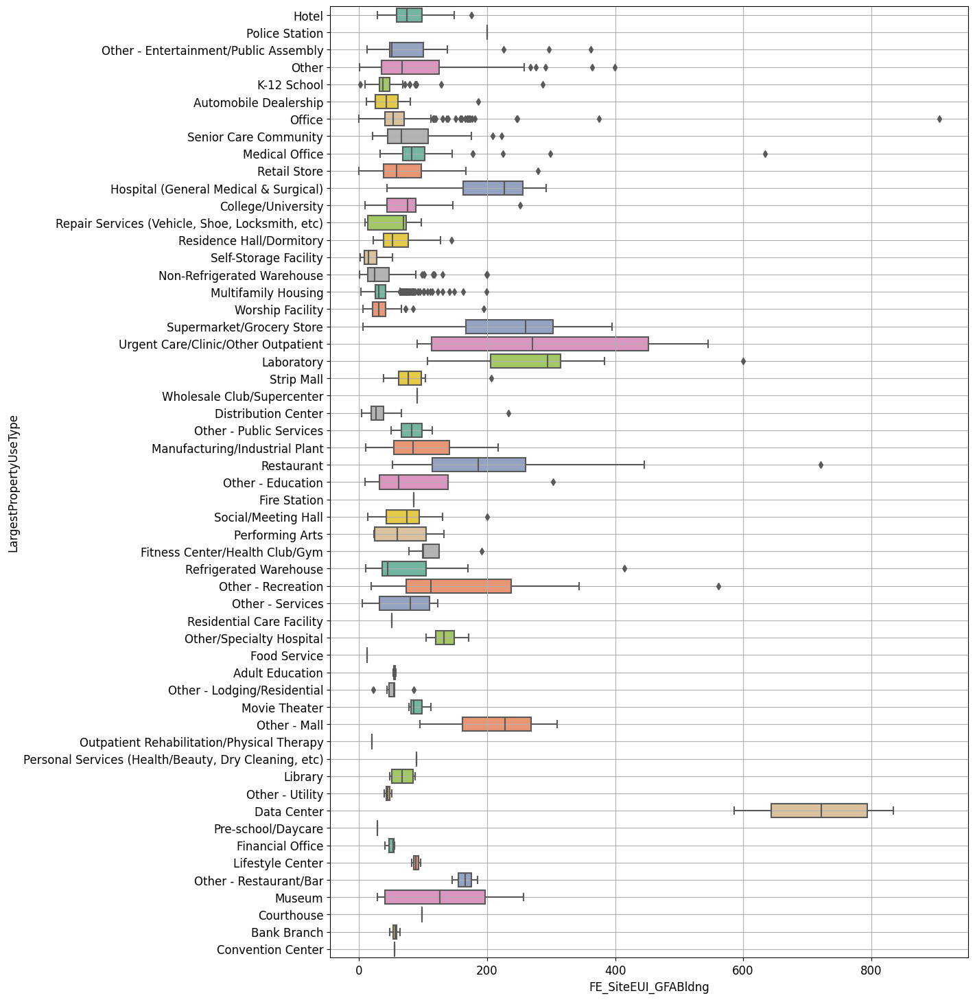

In [57]:
f, ax = plt.subplots(figsize=(12, 18))
a = sns.boxplot(data=df_clean, x='FE_SiteEUI_GFABldng', y='LargestPropertyUseType', palette='Set2', showfliers=True) # 'gist_rainbow_r', width=0.8, notch=True, hue='filled', palette='prism_r'
plt.grid('on')

In [ ]:
lier_var = 'FE_SiteEUI_GFABldng'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'College/University'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols, side='high')

In [59]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
3152,NonResidential,College/University,3,EAST,2006,1.0,5.0,84000,0,84000,College/University,College/University,84000.000000,None,0.000000,None,0.0,NaN,146.1,154.3,270.1,272.3,12315998.0,13003462.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6617,NonResidential,University,4,NORTHEAST,1998,1.0,6.0,203030,0,203030,College/University,College/University,203030.000000,None,0.000000,None,0.0,NaN,252.0,0.0,561.0,0.0,51168308.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2179,NonResidential,College/University,4,LAKE UNION,1940,1.0,2.0,41293,15243,26050,"College/University, Medical Office",College/University,16609.998067,Medical Office,9440.001933,None,0.0,NaN,68.1,73.6,171.4,172.4,2817261.0,3044881.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2351,Campus,College/University,7,MAGNOLIA/QUEEN ANNE,1945,1.0,2.0,537000,0,537000,College/University,College/University,533826.000000,Restaurant,3174.000000,None,0.0,NaN,116.1,129.8,214.1,228.5,61984596.0,69311976.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [60]:
df_inliers.shape

(21, 117)

Peut-être que le groupe de points (21) rend la détection d'outlier moins nette ? Changeons de groupe de points :

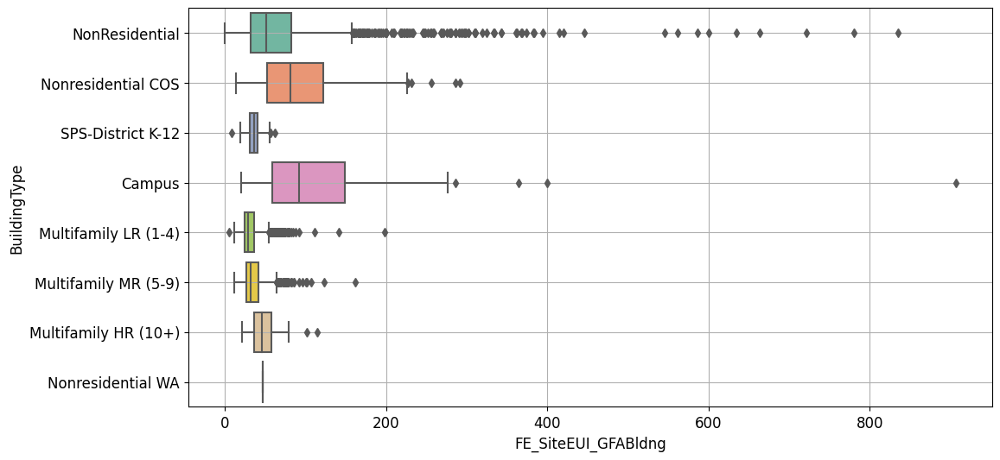

In [61]:
f, ax = plt.subplots(figsize=(12, 6))
a = sns.boxplot(data=df_clean, x='FE_SiteEUI_GFABldng', y='BuildingType', palette='Set2', showfliers=True) # 'gist_rainbow_r', width=0.8, notch=True, hue='filled', palette='prism_r'
plt.grid('on')

In [62]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
3152,NonResidential,College/University,3,EAST,2006,1.0,5.0,84000,0,84000,College/University,College/University,84000.000000,None,0.000000,None,0.0,NaN,146.1,154.3,270.1,272.3,12315998.0,13003462.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6617,NonResidential,University,4,NORTHEAST,1998,1.0,6.0,203030,0,203030,College/University,College/University,203030.000000,None,0.000000,None,0.0,NaN,252.0,0.0,561.0,0.0,51168308.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2179,NonResidential,College/University,4,LAKE UNION,1940,1.0,2.0,41293,15243,26050,"College/University, Medical Office",College/University,16609.998067,Medical Office,9440.001933,None,0.0,NaN,68.1,73.6,171.4,172.4,2817261.0,3044881.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2351,Campus,College/University,7,MAGNOLIA/QUEEN ANNE,1945,1.0,2.0,537000,0,537000,College/University,College/University,533826.000000,Restaurant,3174.000000,None,0.0,NaN,116.1,129.8,214.1,228.5,61984596.0,69311976.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
lier_var = 'FE_SiteEUI_GFABldng'
lier_cat = 'BuildingType'
lier_cat_val = 'Campus'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols, side='high')

In [64]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
195,Campus,Other,7,DOWNTOWN,1995,4.0,3.0,215476,0,215476,Other,Other,215476.000000,None,-2.910383e-11,None,0.000000,NaN,116.900000,121.800000,266.400000,269.300000,25377650.0,26431774.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,215476.0,0.0,0.0,0.0,0.0,0.0,0.000000
341,Campus,Other,3,LAKE UNION,1997,3.0,5.0,535947,195283,340664,"Other, Parking",Other,340664.000000,None,0.000000e+00,None,0.000000,NaN,254.200000,272.900000,536.600000,546.400000,136241424.0,146248640.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,340664.0,0.0,0.0,0.0,0.0,0.0,0.000000
967,Campus,K-12 School,4,NORTHEAST,1989,1.0,3.0,21500,0,21500,K-12 School,K-12 School,21500.000000,None,0.000000e+00,None,0.000000,51.0,64.100000,71.200000,136.400000,143.900000,6159684.0,6844304.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
1881,Campus,Other,7,MAGNOLIA/QUEEN ANNE,1955,1.0,1.0,260241,0,260241,Other,Other,260241.000000,None,0.000000e+00,None,0.000000,NaN,125.600000,137.700000,337.500000,370.200000,32675250.0,35823228.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,260241.0,0.0,0.0,0.0,0.0,0.0,0.000000
3272,Campus,Other,7,MAGNOLIA/QUEEN ANNE,2002,7.0,4.0,808520,376000,432520,Other,Other,432520.000000,None,0.000000e+00,None,0.000000,NaN,194.900000,206.000000,403.000000,414.600000,157606480.0,166523440.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,432520.0,0.0,0.0,0.0,0.0,0.0,0.000000
161,Campus,Large Office,1,GREATER DUWAMISH,1980,16.0,2.0,334368,31874,302494,"Laboratory, Office, Parking",Office,232409.900592,Laboratory,7.008410e+04,None,0.000000,NaN,154.500000,157.500000,439.300000,442.500000,52273792.0,53294752.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,232409.900592
1312,Campus,Restaurant,7,DOWNTOWN,1912,1.0,2.0,25380,0,25380,"Food Sales, Office, Restaurant",Restaurant,16971.603519,Food Sales,6.582426e+03,Office,1825.970674,NaN,273.800000,270.900000,548.500000,539.300000,7003615.0,6928804.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1825.970674
3375,Campus,Mixed Use Property,2,GREATER DUWAMISH,1992,1.0,3.0,494835,0,494835,"Energy/Power Station, Laboratory, Manufacturin...",Office,201757.012443,Laboratory,1.705495e+05,Non-Refrigerated Warehouse,122528.500247,8.0,221.699997,233.100006,388.200012,400.299988,448385312.0,471613856.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,122528.500247,0.0,0.0,0.0,0.0,0.0,0.0,0.0,201757.012443
2351,Campus,College/University,7,MAGNOLIA/QUEEN ANNE,1945

Par contre, ça n'est pas en **intensité** de consommation d'énergie totale que le 6614 est un outlier (dans le groupe de points où `'LargestPropertyUseType'` = `'College/University'`).

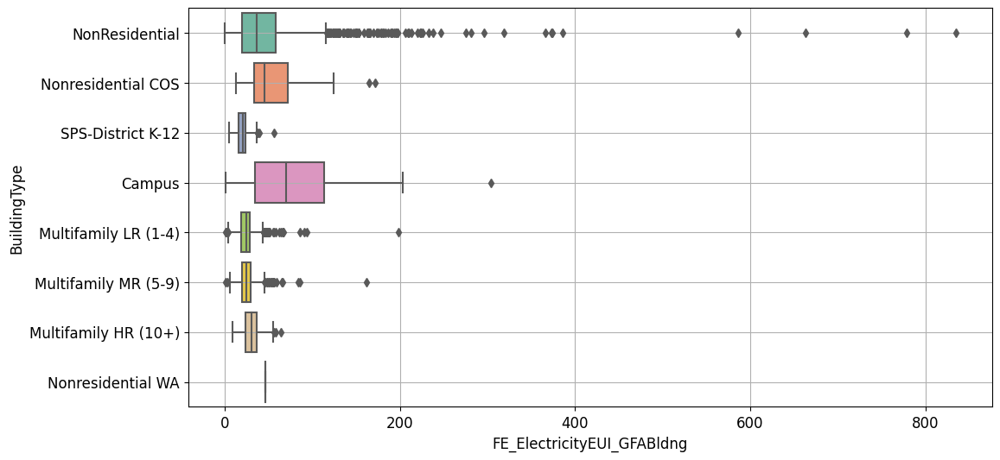

In [65]:
f, ax = plt.subplots(figsize=(12, 6))
a = sns.boxplot(data=df_clean, x='FE_ElectricityEUI_GFABldng', y='BuildingType', palette='Set2', showfliers=True) # 'gist_rainbow_r', width=0.8, notch=True, hue='filled', palette='prism_r'
plt.grid('on')

In [ ]:
lier_var = 'FE_ElectricityEUI_GFABldng'
lier_cat = 'BuildingType'
lier_cat_val = 'Campus'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols, side='high')

In [67]:
df_outliers[lier_var]

341     202.979379
967     147.896093
1881     98.394896
3272    177.429945
6614     70.500364
161     148.322929
290     101.047744
1308     85.578003
1311     84.921604
1312    125.823562
3375    304.093856
302      79.417007
Name: FE_ElectricityEUI_GFABldng, dtype: float64

Ah, l'Université 6614 est donc bien un outlier en **intensité de consommation d'électricité**.

In [ ]:
lier_var = 'SourceEUI(kBtu/sf)'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'College/University'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols2, side='high')

In [69]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
3152,NonResidential,College/University,3,EAST,2006,1.0,5.0,84000,0,84000,College/University,College/University,84000.0,None,0.0,None,0.0,NaN,146.100000,154.3,270.100000,272.3,12315998.0,13003462.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6614,Campus,University,4,NORTHEAST,1900,111.0,0.0,9320156,0,9320156,College/University,College/University,9320156.0,None,0.0,None,0.0,NaN,93.800003,0.0,246.600006,0.0,873923712.0,0.0,84985240.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6617,NonResidential,University,4,NORTHEAST,1998,1.0,6.0,203030,0,203030,College/University,College/University,203030.0,None,0.0,None,0.0,NaN,252.000000,0.0,561.000000,0.0,51168308.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Regardons la variable `'SiteEUI(kBtu/sf)'` :

Seuils in/out liers :[-19.1875 ; 105.3125]
df_inliers :
------------
       CouncilDistrictCode    YearBuilt  NumberofBuildings  NumberofFloors  \
count            22.000000    22.000000          22.000000       22.000000   
mean              4.272727  1953.045455           8.409091        2.500000   
std               1.881788    32.849552          24.359723        1.371478   
min               1.000000  1900.000000           1.000000        0.000000   
25%               3.000000  1925.750000           1.000000        2.000000   
50%               4.000000  1957.500000           1.000000        2.000000   
75%               6.500000  1973.000000           1.000000        3.000000   
max               7.000000  2013.000000         111.000000        7.000000   

       PropertyGFATotal  PropertyGFAParking  PropertyGFABuilding(s)  \
count      2.200000e+01           22.000000            2.200000e+01   
mean       6.450975e+05        20264.909091            6.393308e+05   
std        1.99

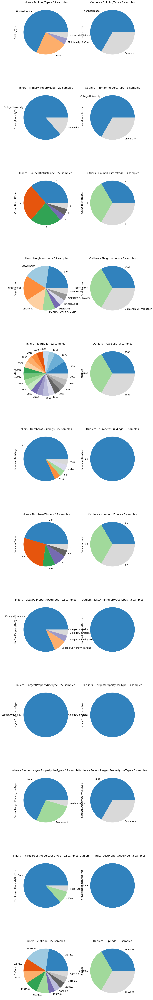

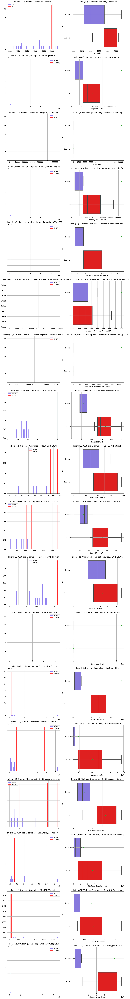

In [70]:
lier_var = 'SiteEUI(kBtu/sf)'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'College/University'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols2, side='high')

In [71]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
3152,NonResidential,College/University,3,EAST,2006,1.0,5.0,84000,0,84000,College/University,College/University,84000.0,None,0.0,None,0.0,NaN,146.1,154.3,270.1,272.3,12315998.0,13003462.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6617,NonResidential,University,4,NORTHEAST,1998,1.0,6.0,203030,0,203030,College/University,College/University,203030.0,None,0.0,None,0.0,NaN,252.0,0.0,561.0,0.0,51168308.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2351,Campus,College/University,7,MAGNOLIA/QUEEN ANNE,1945,1.0,2.0,537000,0,537000,College/University,College/University,533826.0,Restaurant,3174.0,None,0.0,NaN,116.1,129.8,214.1,228.5,61984596.0,69311976.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Intéressant : la variable `'SourceEUI(kBtu/sf)'` place le 6614 en outlier, et pas la variable `'SiteEUI(kBtu/sf)'` !

Autre élément qui peut perturber les régressions qui tiendront compte du **nombre d'étages** (`'NumberofFloors'`) : celui-ci est nul pour un site de 111 bâtiments ! Cette valeur est donc sûrement **fausse**.

Le sample 6614 (ID 49967) a plusieurs données mal renseignées :
 - son intensité normalisée (WN) est nulle
 - consommations normalisées (WN) est nulle
 - le score `ENERGYSTAR` est manquant
 - le nombre d'étages est nul, ce qui paraît impossible
 - la surface de parking est nulle.

In [72]:
df_clean.loc[6614,'SiteEnergyUse(kBtu)']

873923712.0

In [73]:
df_clean.loc[6614,'SteamUse(kBtu)'] + df_clean.loc[6614,'Electricity(kBtu)'] + df_clean.loc[6614,'NaturalGas(kBtu)']

742059629.0

In [74]:
df_clean.loc[0,'SiteEnergyUse(kBtu)']

6981428.0

In [75]:
df_clean.loc[0,'SteamUse(kBtu)'] + df_clean.loc[0,'Electricity(kBtu)'] + df_clean.loc[0,'NaturalGas(kBtu)']

6981580.0

In [76]:
df_check = df_clean.copy()

In [77]:
df_check['CheckEnergyUse'] = (abs(df_check['SiteEnergyUse(kBtu)']-\
                              df_check['SteamUse(kBtu)']-df_check['Electricity(kBtu)']-df_check['NaturalGas(kBtu)'])) / \
                              df_check['SiteEnergyUse(kBtu)']

In [78]:
nrj_ko = df_check.loc[(df_check['CheckEnergyUse'] > 0.15)]
nrj_ko

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office,CheckEnergyUse
69,Nonresidential COS,Other,7,MAGNOLIA/QUEEN ANNE,1962,1.0,1.0,129000,0,129000,Other,Other,1.290000e+05,None,0.000000e+00,None,0.000000,NaN,79.700000,78.700000,167.700000,167.700000,2.933740e+07,28974828.0,8560000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,129000.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.220347
2283,Multifamily LR (1-4),Low-Rise Multifamily,3,CENTRAL,1926,1.0,3.0,27840,7031,20809,"Multifamily Housing, Parking",Multifamily Housing,2.080900e+04,None,0.000000e+00,None,0.000000,99.0,35.100000,35.900000,69.000000,69.900000,7.302920e+05,748040.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.195997
6614,Campus,University,4,NORTHEAST,1900,111.0,0.0,9320156,0,9320156,College/University,College/University,9.320156e+06,None,0.000000e+00,None,0.000000,NaN,93.800003,0.000000,246.600006,0.000000,8.739237e+08,0.0,84985240.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.150887
6615,NonResidential,University,4,NORTHEAST,1969,1.0,4.0,58779,0,58779,College/University,College/University,5.877900e+04,None,0.000000e+00,None,0.000000,NaN,85.099998,0.000000,221.000000,0.000000,5.000717e+06,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.256263
6617,NonResidential,University,4,NORTHEAST,1998,1.0,6.0,203030,0,203030,College/University,College/University,2.030300e+05,None,0.000000e+00,None,0.000000,NaN,252.000000,0.000000,561.000000,0.000000,5.116831e+07,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.440775
6690,Multifamily LR (1-4),Low-Rise Multifamily,7,MAGNOLIA/QUEEN ANNE,2015,1.0,4.0,51095,2791,48311,"Multifamily Housing, Parking",Multifamily Housing,4.831100e+04,None,-7.275958e-12,None,0.000000,1.0,55.799999,60.700001,288.100006,315.899994,2.751301e+06,2992911.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.645032
1201,NonResidential,Small- and Mid-Sized Office,5,NORTHWEST,1951,1.0,2.0,39815,0,39815,"Non-Refrigerated Warehouse, Office",Office,2.711800e+04,Non-Refrigerated Warehouse,1.269700e+04,None,0.000000,70.0,39.100000,53.500000,118.800000,134.000000,1.554939e+06,2129737.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12697.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,27118.000000,0.314228
6611,Multifamily MR (5-9),Mid-Rise Multifamily,3,EAST,2014,2.0,7.0,278554,37424,241130,Multifamily Housing,Multifamily Housing,2.304582e+05,Retail Store,1.067183e+04,None,0.000000,100.0,22.799999,22.799999,72.699997,72.699997,6.352846e+06,6362361.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [ ]:
lier_var = 'FE_ElectricityEUI_GFABldng'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'College/University'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols, side='high')

In [81]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
635,NonResidential,College/University,3,CENTRAL,1974,1.0,4.0,76700,0,76700,College/University,College/University,7.670000e+04,None,0.000000,None,0.0,NaN,61.500000,62.7,185.700000,186.9,7011508.0,7146047.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6614,Campus,University,4,NORTHEAST,1900,111.0,0.0,9320156,0,9320156,College/University,College/University,9.320156e+06,None,0.000000,None,0.0,NaN,93.800003,0.0,246.600006,0.0,873923712.0,0.0,84985240.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6617,NonResidential,University,4,NORTHEAST,1998,1.0,6.0,203030,0,203030,College/University,College/University,2.030300e+05,None,0.000000,None,0.0,NaN,252.000000,0.0,561.000000,0.0,51168308.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2179,NonResidential,College/University,4,LAKE UNION,1940,1.0,2.0,41293,15243,26050,"College/University, Medical Office",College/University,1.661000e+04,Medical Office,9440.001933,None,0.0,NaN,68.100000,73.6,171.400000,172.4,2817261.0,3044881.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Le 6614 est un outlier sur l'intensité de consommation électrique.

In [ ]:
lier_var = 'FE_SteamUseEUI_GFABldng'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'College/University'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols, side='high')

In [83]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
3302,NonResidential,College/University,3,EAST,1925,1.0,3.0,428347,0,428347,College/University,College/University,428347.0,None,-5.820766e-11,None,0.0,NaN,77.000000,83.6,180.800000,185.2,36367960.0,39483712.0,13254980.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6614,Campus,University,4,NORTHEAST,1900,111.0,0.0,9320156,0,9320156,College/University,College/University,9320156.0,None,0.000000e+00,None,0.0,NaN,93.800003,0.0,246.600006,0.0,873923712.0,0.0,84985240.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [84]:
df_clean.FE_SteamUseEUI_GFABldng

0       22.876179
4        0.000000
5        0.000000
7       19.492882
8        0.000000
          ...    
6665     0.000000
6666     0.000000
6672     0.000000
6684     0.000000
6689     0.000000
Name: FE_SteamUseEUI_GFABldng, Length: 3180, dtype: float64

Le 6614 est également un outlier sur l'intensité de consommation de vapeur.

In [ ]:
lier_var = 'FE_SteamUseEUI_GFABldng'
lier_cat = 'BuildingType'
lier_cat_val = 'Campus'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols, side='high')

In [86]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
2297,Campus,K-12 School,3,EAST,1923,1.0,4.0,46100,0,46100,"K-12 School, Parking",K-12 School,46100.0,None,0.0,None,0.0,66.0,53.200000,62.3,110.500000,120.5,2454812.0,2873504.0,742481.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6614,Campus,University,4,NORTHEAST,1900,111.0,0.0,9320156,0,9320156,College/University,College/University,9320156.0,None,0.0,None,0.0,NaN,93.800003,0.0,246.600006,0.0,873923712.0,0.0,84985240.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
302,Campus,Mixed Use Property,7,DOWNTOWN,1913,1.0,10.0,258497,155000,258497,"Data Center, Office, Parking, Restaurant, Reta...",Office,145594.0,Retail Store,103200.0,Restaurant,9703.0,NaN,89.000000,93.2,254.900000,260.0,23914744.0,25042638.0,3386539.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,145594.0


In [ ]:
lier_var = 'FE_ElectricityEUI_GFABldng'
lier_cat = 'BuildingType'
lier_cat_val = 'Campus'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols, side='high')

In [88]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
341,Campus,Other,3,LAKE UNION,1997,3.0,5.0,535947,195283,340664,"Other, Parking",Other,3.406640e+05,None,0.000000,None,0.000000,NaN,254.200000,272.900000,536.600000,546.400000,136241424.0,146248640.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,340664.0,0.0,0.0,0.0,0.0,0.0,0.000000
967,Campus,K-12 School,4,NORTHEAST,1989,1.0,3.0,21500,0,21500,K-12 School,K-12 School,2.150000e+04,None,0.000000,None,0.000000,51.0,64.100000,71.200000,136.400000,143.900000,6159684.0,6844304.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
1881,Campus,Other,7,MAGNOLIA/QUEEN ANNE,1955,1.0,1.0,260241,0,260241,Other,Other,2.602410e+05,None,0.000000,None,0.000000,NaN,125.600000,137.700000,337.500000,370.200000,32675250.0,35823228.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,260241.0,0.0,0.0,0.0,0.0,0.0,0.000000
3272,Campus,Other,7,MAGNOLIA/QUEEN ANNE,2002,7.0,4.0,808520,376000,432520,Other,Other,4.325200e+05,None,0.000000,None,0.000000,NaN,194.900000,206.000000,403.000000,414.600000,157606480.0,166523440.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,432520.0,0.0,0.0,0.0,0.0,0.0,0.000000
6614,Campus,University,4,NORTHEAST,1900,111.0,0.0,9320156,0,9320156,College/University,College/University,9.320156e+06,None,0.000000,None,0.000000,NaN,93.800003,0.000000,246.600006,0.000000,873923712.0,0.0,84985240.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
161,Campus,Large Office,1,GREATER DUWAMISH,1980,16.0,2.0,334368,31874,302494,"Laboratory, Office, Parking",Office,2.324099e+05,Laboratory,70084.099408,None,0.000000,NaN,154.500000,157.500000,439.300000,442.500000,52273792.0,53294752.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,232409.900592
290,Campus,Mixed Use Property,7,DOWNTOWN,1908,1.0,4.0,137400,0,137400,"Food Sales, Multifamily Housing, Office, Other...",Retail Store,4.407800e+04,Other - Restaurant/Bar,19182.000000,Multifamily Housing,14380.000000,NaN,114.100000,114.100000,358.300000,358.300000,13883385.0,13883385.0,0.0,...,0.0,0.0,0.0,19182.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
1308,Campus,Mixed Use Property,7,DOWNTOWN,1900,1.0,2.0,49280,0,49280,"Food Sales, Office, Restaurant, Retail Store, ...",Retail Store,1.561400e+04,Restaurant,9240.000000,Social/Meeting Hall,8199.000000,NaN,85.600000,85.600000,268.700000,268.700000,4217108.0,4217108.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8199.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
1311,Campus,Low-Rise Mul

Le 341 est aussi suspect ;-)

**`'LargestPropertyUseType'` → `'GHGEmissionsIntensity'`**

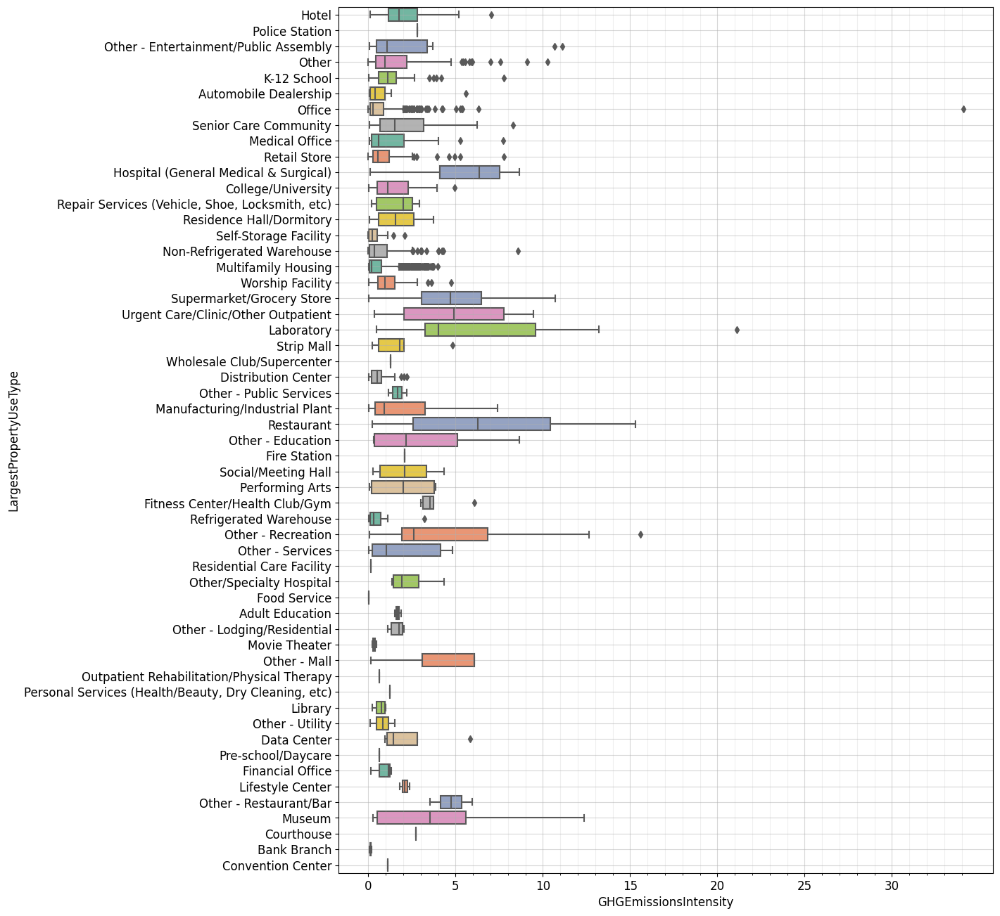

In [89]:
f, ax = plt.subplots(figsize=(12, 16))
sns.boxplot(data=df_clean, x='GHGEmissionsIntensity', y='LargestPropertyUseType', palette='Set2',
            showfliers=True)  # 'gist_rainbow_r', width=0.8, notch=True, hue='filled', palette='prism_r'

major_ticks = np.arange(0, 35, 5)
minor_ticks = np.arange(0, 35, 1)
ax.set_xticks(major_ticks)
ax.set_xticks(minor_ticks, minor=True)
ax.grid('on', which='both')
ax.grid(which='minor', alpha=0.2)
ax.grid(which='major', alpha=0.5)

Il y a moins d'outliers, visuellement, dans la catégorisation `'LargestPropertyUseType'` que dans la catégorisation `'PrimaryPropertyType`', donc on gardera décidément `'LargestPropertyUseType'` comme variable explicative.

Tentons de comprendre ce qui fait les outliers pour la variable `'GHGEmissionsIntensity'` et les valeurs `'Multifamily Housing'`, `'Office'`, `'Non-Refrigerated Warehouse'`, de la catégorie `'LargestPropertyUseType'` :

Seuils in/out liers :[-1.5400 ; 2.7800]
df_inliers :
------------
       CouncilDistrictCode    YearBuilt  NumberofBuildings  NumberofFloors  \
count          1538.000000  1538.000000        1538.000000     1538.000000   
mean              4.528609  1976.905722           1.012354        5.263329   
std               2.035029    31.008565           0.185284        4.103124   
min               1.000000  1900.000000           1.000000        0.000000   
25%               3.000000  1965.000000           1.000000        3.000000   
50%               4.500000  1986.000000           1.000000        4.000000   
75%               7.000000  2001.000000           1.000000        6.000000   
max               7.000000  2015.000000           6.000000       42.000000   

       PropertyGFATotal  PropertyGFAParking  PropertyGFABuilding(s)  \
count      1.538000e+03         1538.000000             1538.000000   
mean       7.135607e+04        11619.983095            62553.562419   
std        8.49440

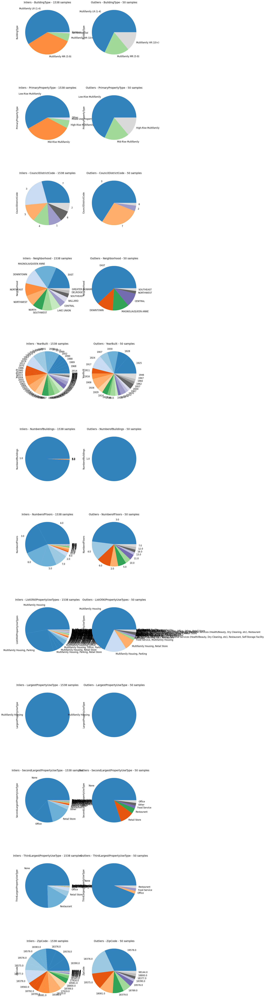

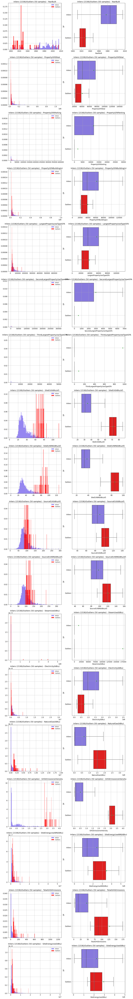

In [90]:
lier_var = 'GHGEmissionsIntensity'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'Multifamily Housing'  # Non-Refrigerated Warehouse
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols2, side='high')

In [91]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
847,Multifamily LR (1-4),Low-Rise Multifamily,3,EAST,1928,1.0,4.0,27182,3200,27182,"Multifamily Housing, Parking",Multifamily Housing,27182.000000,None,0.000000e+00,None,0.000000,52.0,66.200000,83.000000,91.900000,109.600000,1798694.0,2257296.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
883,Multifamily LR (1-4),Low-Rise Multifamily,7,DOWNTOWN,1917,1.0,3.0,21130,0,21130,Multifamily Housing,Multifamily Housing,21130.000000,None,0.000000e+00,None,0.000000,88.0,65.000000,80.600000,86.900000,103.400000,1372475.0,1703889.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
884,Multifamily MR (5-9),Mid-Rise Multifamily,7,DOWNTOWN,1914,1.0,6.0,36880,0,36880,Multifamily Housing,Multifamily Housing,36880.000000,None,0.000000e+00,None,0.000000,90.0,56.600000,65.600000,91.000000,101.800000,2086588.0,2417747.0,1349585.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
1074,Multifamily LR (1-4),Low-Rise Multifamily,3,CENTRAL,1907,1.0,3.0,25248,0,25248,Multifamily Housing,Multifamily Housing,25248.000000,None,0.000000e+00,None,0.000000,47.0,71.700000,83.500000,93.400000,105.900000,1809327.0,2109403.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
1076,Multifamily LR (1-4),Low-Rise Multifamily,3,EAST,1907,1.0,3.0,24783,0,24783,Multifamily Housing,Multifamily Housing,24783.000000,None,0.000000e+00,None,0.000000,60.0,69.600000,85.500000,89.600000,106.300000,1725035.0,2119602.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
1083,Multifamily LR (1-4),Low-Rise Multifamily,7,MAGNOLIA/QUEEN ANNE,1928,1.0,3.0,28940,2262,26678,Multifamily Housing,Multifamily Housing,26678.000000,None,0.000000e+00,None,0.000000,71.0,62.000000,75.300000,82.900000,96.900000,1795493.0,2180551.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
1163,Multifamily HR (10+),High-Rise Multifamily,7,EAST,1922,1.0,10.0,90920,0,90920,Multifamily Housing,Multifamily Housing,90920.000000,None,0.000000e+00,None,0.000000,80.0,64.700000,76.500000,101.700000,114.100000,6468083.0,7646743.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
1259,Multifamily HR (10+),High-Rise Multifamily,3,EAST,2000,1.0,13.0,207022,48946,158076,"Multifamily Housing, Parking",Multifamily Housing,158076.000000,None,0.000000e+00,None,0.000000,1.0,114.300000,126.800000,220.600000,232.100000,18074716.0,20043350.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

Les outliers sont en moyenne 7x plus intensément émetteurs que les autres et 3x plus énergivores.
Ca peut être, côté variables numériques :
- `NumberofFloors` : 1/4 plus petit en moyenne
- `PropertyGFAParking` : 2x plus grands (paradoxalement !), mais la moyenne est faite sur un seul point non-nul, les médianes sont toutes les deux à 0.
- `PropertyGFATotal` (ou `PropertyGFABuilding(s)`, `LargestPropertyUseTypeGFA)` : 20% plus petit en moyenne
- `NaturalGas(kBtu)` (mais on ne l'a pas comme input) : 3x plus élevé
La réponse n'est pas nette.

**Remarque :** le fait d'avoir finalement conservé les colonnes Second/ThirdUseType puis de supprimer les NaN a modifier la base de points, et moins d'outliers sont apparus pour `'Non-Refrigerated Warehouse'`.

On retente une étude pour `'Office'`, pour les 'high' outlier (`side='high'`):

Seuils in/out liers :[-1.5400 ; 2.7800]
df_inliers :
------------
       CouncilDistrictCode    YearBuilt  NumberofBuildings  NumberofFloors  \
count           453.000000   453.000000         453.000000      453.000000   
mean              5.335541  1961.181015           1.046358        7.108168   
std               2.095612    37.167558           0.743745        9.396820   
min               1.000000  1900.000000           1.000000        1.000000   
25%               3.000000  1922.000000           1.000000        3.000000   
50%               7.000000  1971.000000           1.000000        4.000000   
75%               7.000000  1990.000000           1.000000        6.000000   
max               7.000000  2015.000000          16.000000       76.000000   

       PropertyGFATotal  PropertyGFAParking  PropertyGFABuilding(s)  \
count      4.530000e+02          453.000000            4.530000e+02   
mean       1.669587e+05        35140.035320            1.385157e+05   
std        2.58223

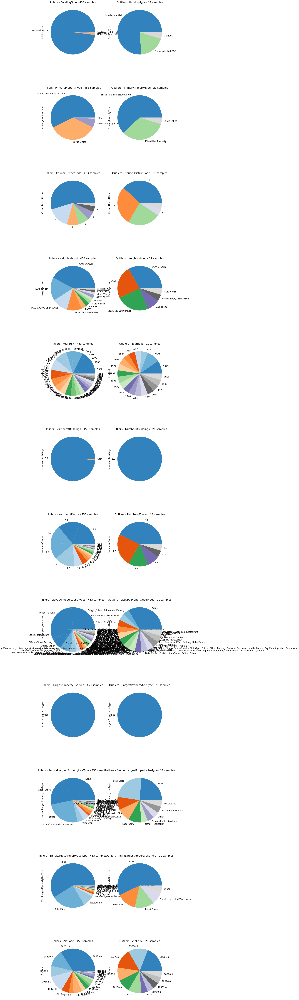

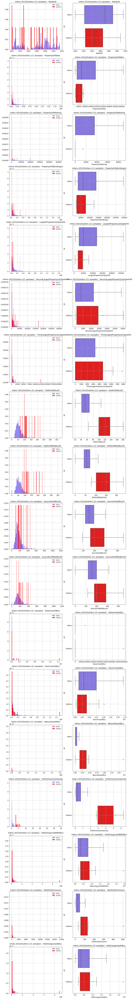

In [92]:
lier_var = 'GHGEmissionsIntensity'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'Office'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols2, side='high')

 Côté outliers :
- YearBuilt 25 ans plus vieux "en médiane" (1946 vs 1971) et 15 ans plus vieux en moyenne (1945 vs 1961)
- Mais même si on va faire sans pour la prédiction, la consommation de gaz est également nettement plus importante (mais ce sera lié à l'année) : 1.6e7 vs 6.e6 = 3x
- `NumberofFloors` moins élevé (moy = 3.8 contre 7.1)
- `PropertyGFATotal` moins élevé (moy = 0.6e5 contre 1.5e5)
- `PropertyGFAParking` moins élevés (moy 3000 contre 27000)
La surface de parking moins élevée peut expliquer la plus grande intensité d'émissions de la propriété.

Le mystère se cache peut-être dans les surfaces d'usage secondaire et tertiaire ?

On retente une étude pour `'Non-Refrigerated Warehouse'` :

In [ ]:
lier_var = 'GHGEmissionsIntensity'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'Non-Refrigerated Warehouse'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols2, side='high')

On retente une étude pour `'College/University'` sur `'SiteEUI(kBtu/sf'` :

In [ ]:
lier_var = 'SiteEUI(kBtu/sf)'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'College/University'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols2, side='high')

In [95]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
3152,NonResidential,College/University,3,EAST,2006,1.0,5.0,84000,0,84000,College/University,College/University,84000.0,None,0.0,None,0.0,NaN,146.1,154.3,270.1,272.3,12315998.0,13003462.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6617,NonResidential,University,4,NORTHEAST,1998,1.0,6.0,203030,0,203030,College/University,College/University,203030.0,None,0.0,None,0.0,NaN,252.0,0.0,561.0,0.0,51168308.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2351,Campus,College/University,7,MAGNOLIA/QUEEN ANNE,1945,1.0,2.0,537000,0,537000,College/University,College/University,533826.0,Restaurant,3174.0,None,0.0,NaN,116.1,129.8,214.1,228.5,61984596.0,69311976.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
lier_var = 'GHGEmissionsIntensity'
lier_cat = 'LargestPropertyUseType'
lier_cat_val = 'College/University'
df_inliers, df_outliers = DisplotData.compare_in_out_liers(
    df_clean, lier_var, lier_cat, lier_cat_val, categ_cols, num_cols2, side='high')

In [97]:
df_outliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
3152,NonResidential,College/University,3,EAST,2006,1.0,5.0,84000,0,84000,College/University,College/University,84000.0,None,0.0,None,0.0,NaN,146.1,154.3,270.1,272.3,12315998.0,13003462.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2351,Campus,College/University,7,MAGNOLIA/QUEEN ANNE,1945,1.0,2.0,537000,0,537000,College/University,College/University,533826.0,Restaurant,3174.0,None,0.0,NaN,116.1,129.8,214.1,228.5,61984596.0,69311976.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


**`'BuildingType'` → `'GHGEmissionsIntensity'`**

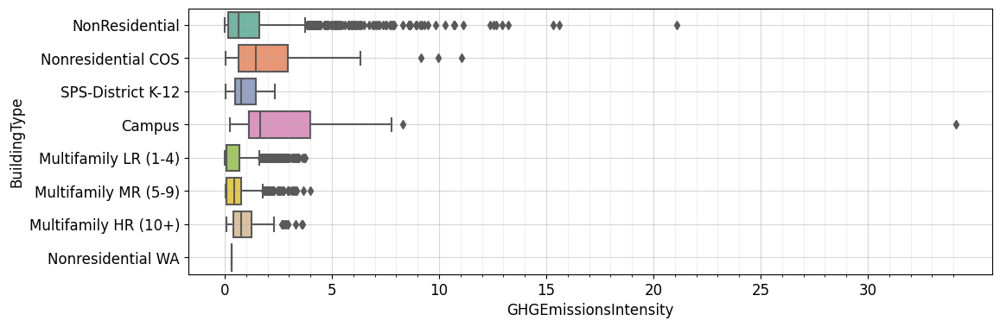

In [98]:
fig, ax = plt.subplots(figsize=(12, 4))
sns.boxplot(data=df_clean, x='GHGEmissionsIntensity',
            y='BuildingType', palette='Set2', showfliers=True)
major_ticks = np.arange(0, 35, 5)
minor_ticks = np.arange(0, 35, 1)
ax.set_xticks(major_ticks)
ax.set_xticks(minor_ticks, minor=True)
ax.grid('on', which='both')
ax.grid(which='minor', alpha=0.2)
ax.grid(which='major', alpha=0.5)

In [99]:
df_clean.loc[(df_clean['BuildingType']=='Campus') & (df_clean['GHGEmissionsIntensity']>30.)]

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Performing Arts,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office
3375,Campus,Mixed Use Property,2,GREATER DUWAMISH,1992,1.0,3.0,494835,0,494835,"Energy/Power Station, Laboratory, Manufacturin...",Office,201757.012443,Laboratory,170549.48731,Non-Refrigerated Warehouse,122528.500247,8.0,221.699997,233.100006,388.200012,400.299988,448385312.0,471613856.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,122528.500247,0.0,0.0,0.0,0.0,0.0,0.0,0.0,201757.012443


**`'Neighborhood'` → `'GHGEmissionsIntensity'`**

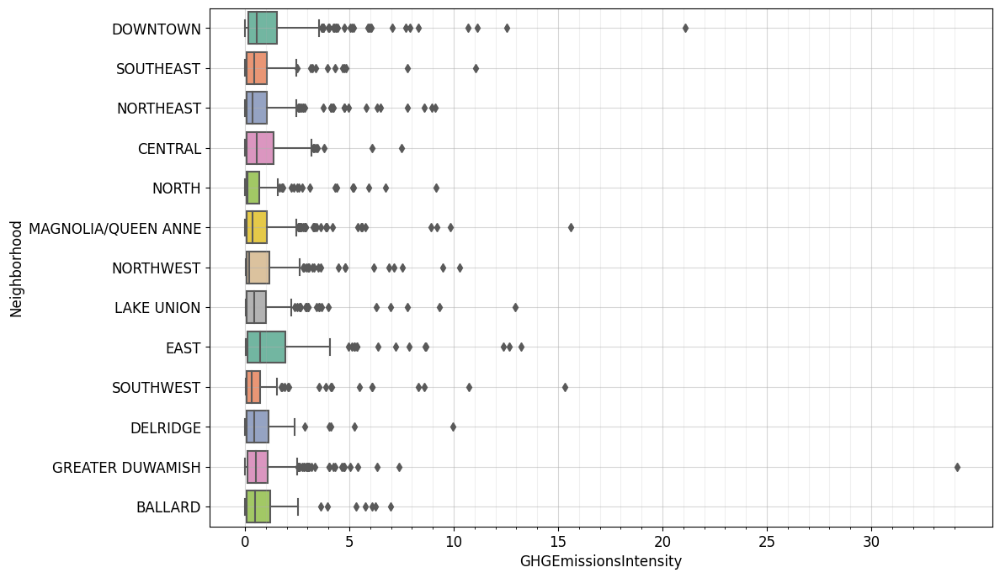

In [100]:
f, ax = plt.subplots(figsize=(12, 8))
sns.boxplot(data=df_clean, x='GHGEmissionsIntensity',
            y='Neighborhood', palette='Set2', showfliers=True)
major_ticks = np.arange(0, 35, 5)
minor_ticks = np.arange(0, 35, 1)
ax.set_xticks(major_ticks)
ax.set_xticks(minor_ticks, minor=True)
ax.grid('on', which='both')
ax.grid(which='minor', alpha=0.2)
ax.grid(which='major', alpha=0.5)

In [101]:
distrib_egales = PwePwocess.kruskal_custo(df_clean, 'Neighborhood', ['GHGEmissionsIntensity'])

GHGEmissionsIntensity
---------------------
  H = 111.219
  p = 0.000000000000
H0 rejetée, les distributions sont significativement différentes pour la catégorie 'Neighborhood'



Le test de Kruskal pousse à retenir la variable `'Neighborhood'`, mais on la réservera aux modèles complexes.  

#### First/Second Use Type

In [102]:
df_clean.columns

Index(['BuildingType', 'PrimaryPropertyType', 'CouncilDistrictCode',
       'Neighborhood', 'YearBuilt', 'NumberofBuildings', 'NumberofFloors',
       'PropertyGFATotal', 'PropertyGFAParking', 'PropertyGFABuilding(s)',
       ...
       'UseType_Distribution Center', 'UseType_Non-Refrigerated Warehouse',
       'UseType_Urgent Care/Clinic/Other Outpatient', 'UseType_Other',
       'UseType_Financial Office', 'UseType_Courthouse',
       'UseType_Vocational School', 'UseType_Supermarket/Grocery Store',
       'UseType_Senior Care Community', 'UseType_Office'],
      dtype='object', length=117)

In [103]:
usages = df_clean['LargestPropertyUseType'].value_counts()
usages

Multifamily Housing                                     1588
Office                                                   474
Non-Refrigerated Warehouse                               196
K-12 School                                              132
Retail Store                                             102
                                                        ... 
Personal Services (Health/Beauty, Dry Cleaning, etc)       1
Outpatient Rehabilitation/Physical Therapy                 1
Fire Station                                               1
Food Service                                               1
Convention Center                                          1
Name: LargestPropertyUseType, Length: 55, dtype: int64

#### Répartition des 2nd et 3rd usage, pour chaque 1st usage

Multifamily Housing : 1588
---------------------
 SecondLargestPropertyUseType :
None                                                    1018
Office                                                   236
Retail Store                                             223
Other                                                     26
Restaurant                                                19
Medical Office                                             9
Swimming Pool                                              8
Supermarket/Grocery Store                                  7
Non-Refrigerated Warehouse                                 6
Other - Restaurant/Bar                                     4
Senior Care Community                                      3
Food Service                                               3
Social/Meeting Hall                                        2
Bar/Nightclub                                              2
Personal Services (Health/Beauty, Dry Cleaning, etc)       2
Hote

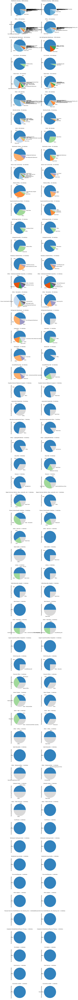

In [104]:
usages = df_clean['LargestPropertyUseType'].value_counts()

n = len(usages)
plt.figure(figsize=(15,5*n))
ind = -1
for val in usages.index:
    ind += 1
    nbval = usages[val]
    print(f'{val} : {nbval}\n'+'-'*len(val)+'--')
    plt.subplot(n+1,2,2*ind+1)
    df = df_clean.loc[df_clean['LargestPropertyUseType']==val,'SecondLargestPropertyUseType']
    print(f' SecondLargestPropertyUseType :\n{df.value_counts()}')
    df.value_counts().plot.pie(colormap='tab20c')
    plt.title(f'{val} : {nbval} individus')

    df = df_clean.loc[df_clean['LargestPropertyUseType']==val,'ThirdLargestPropertyUseType']
    plt.subplot(n+1,2,2*ind+2)
    df.value_counts().plot.pie(colormap='tab20c')
    print(f' -----\nThirdLargestPropertyUseType :\n{df.value_counts()}')
    plt.title(f'{val} : {nbval} individus')
    print('\n')

#### Influence de l'année de construction sur les intensités de consommation

C:\Users\a072108\AppData\Local\Temp\ipykernel_31600\2517417674.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10,5))


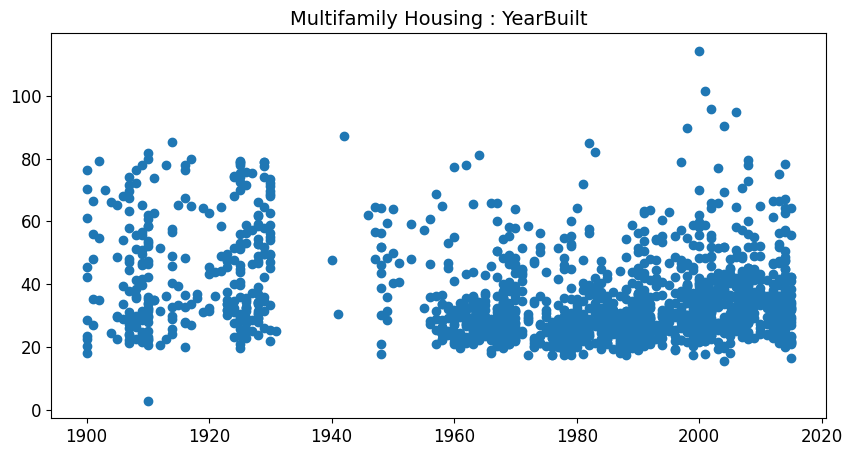

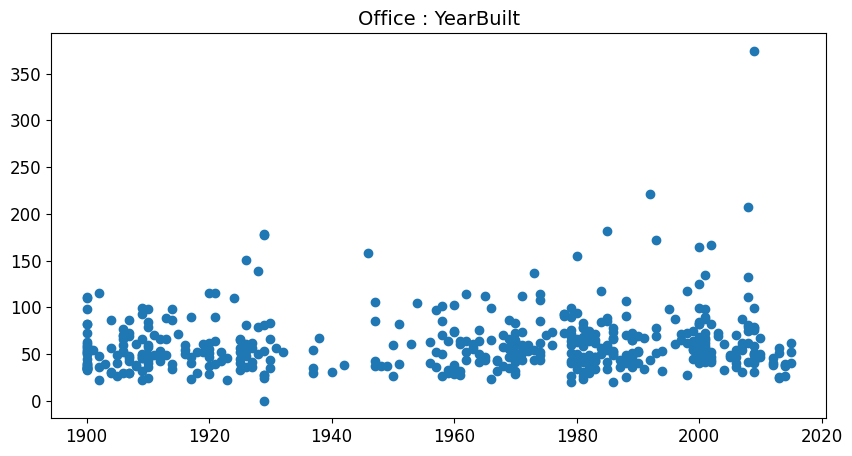

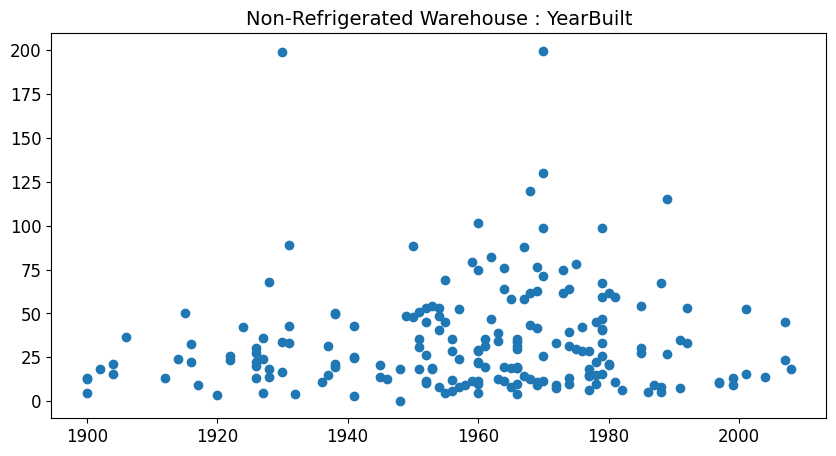

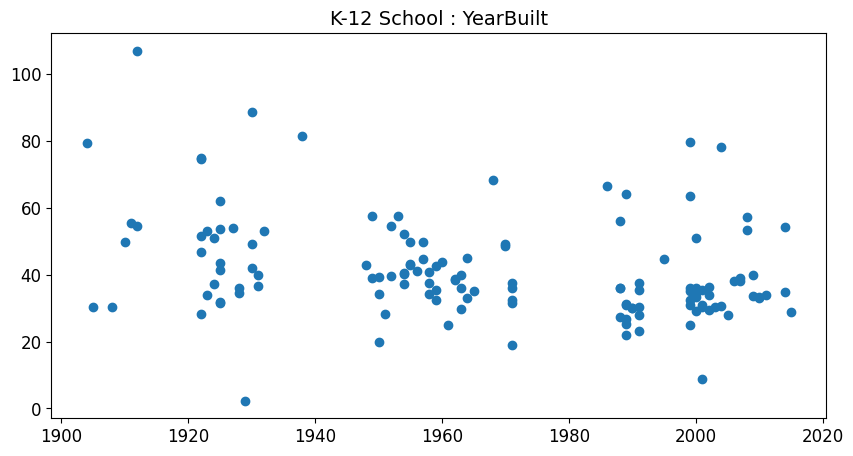

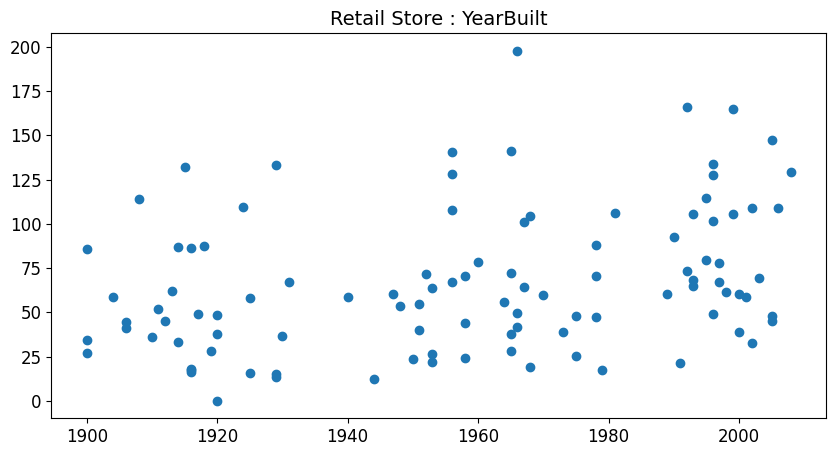

...

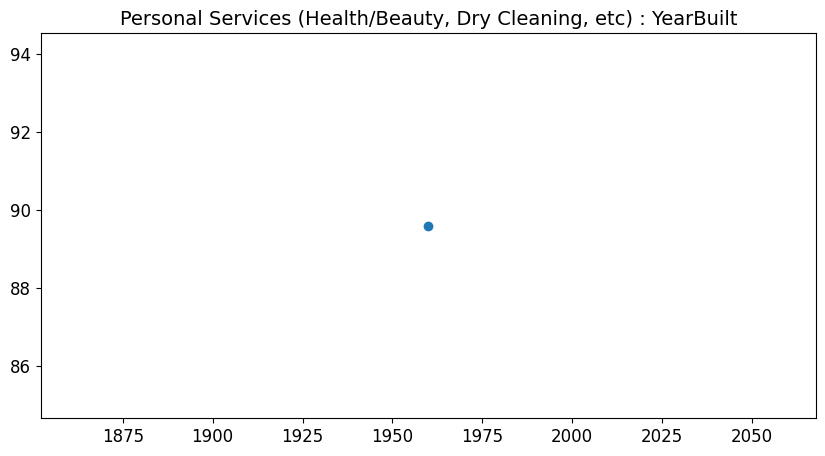

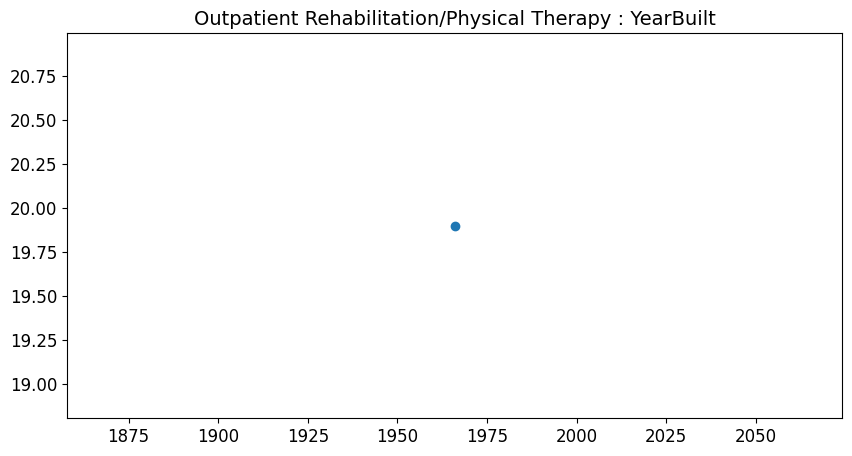

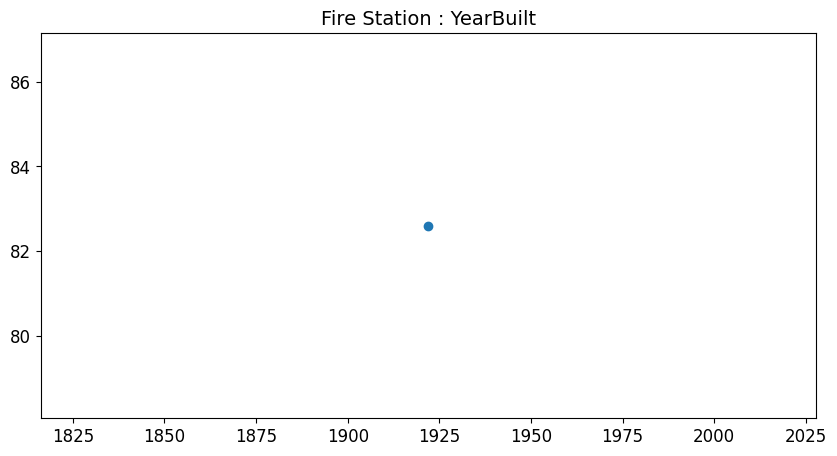

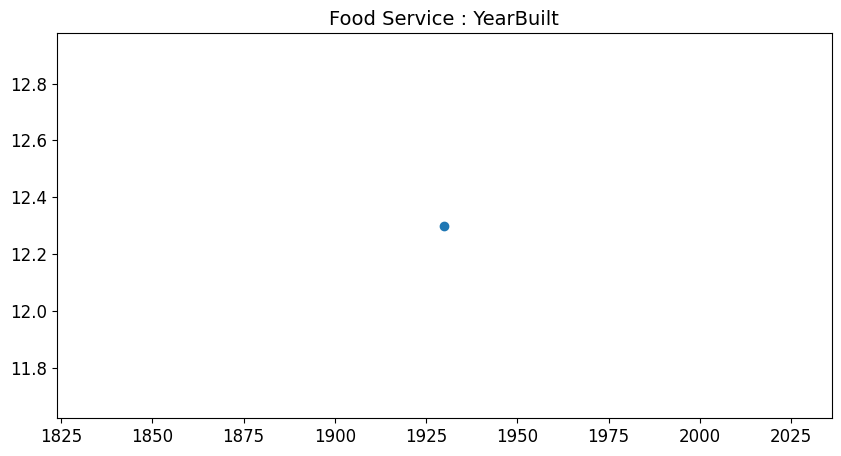

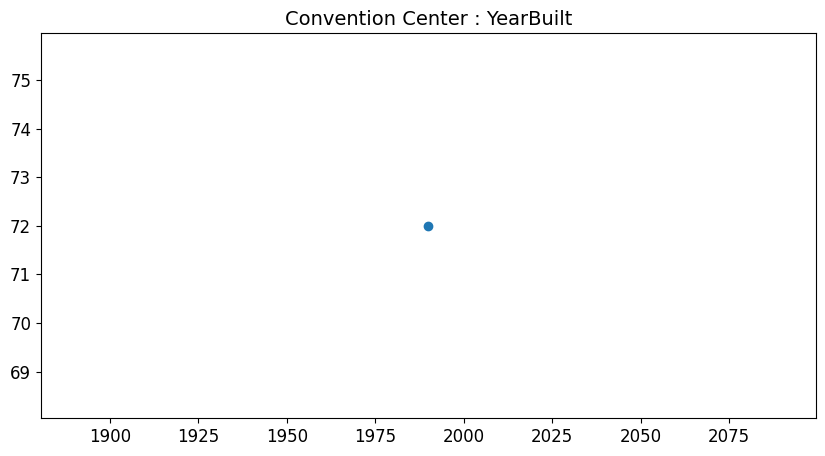

In [105]:
usages = df_clean['LargestPropertyUseType'].value_counts()

n = len(usages)
ind = -1
for val in usages.index:
    plt.figure(figsize=(10,5))
    df = df_clean.loc[df_clean['LargestPropertyUseType']==val]
    plt.scatter(df['YearBuilt'],df['SiteEUI(kBtu/sf)'])
    plt.title(f'{val} : YearBuilt')
    

L'anticorrélation entre l'année de construction et l'intensité de consommation énergétique n'est pas très visible sur les graphes ! Attendons de voir la matrice des corrélations de Pearson.

#### Répartition (de la moyenne) des intensités des différentes énergies

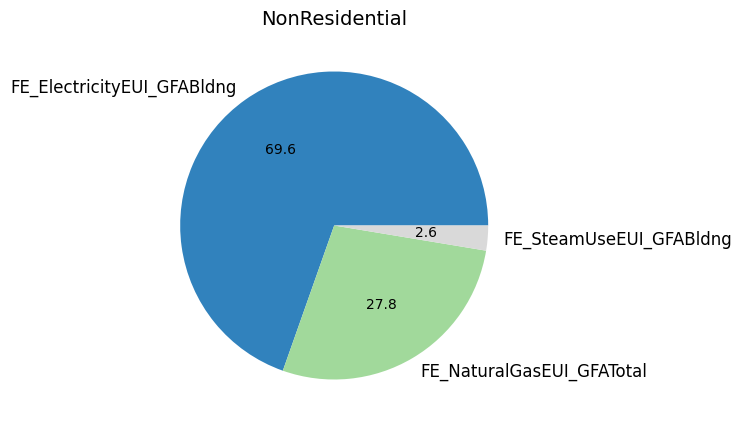

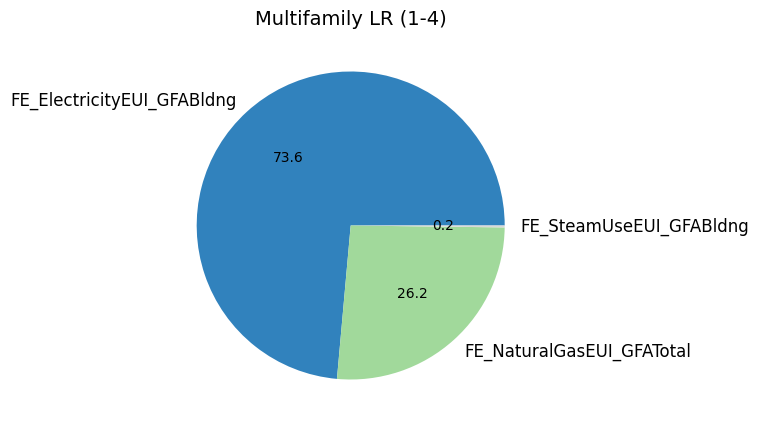

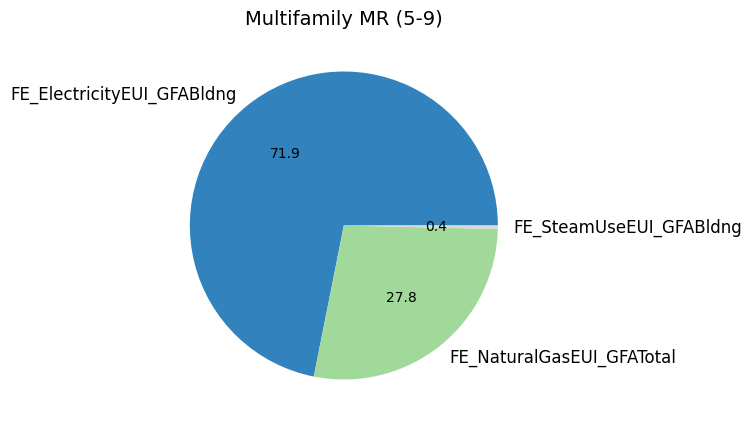

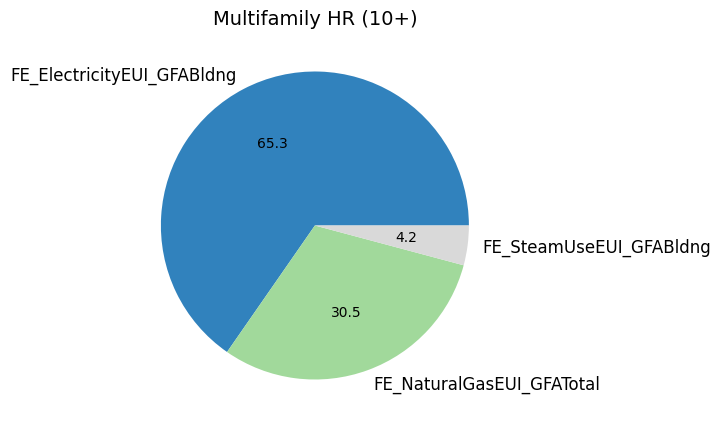

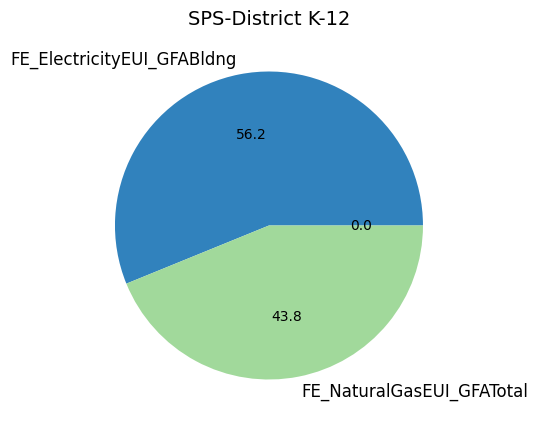

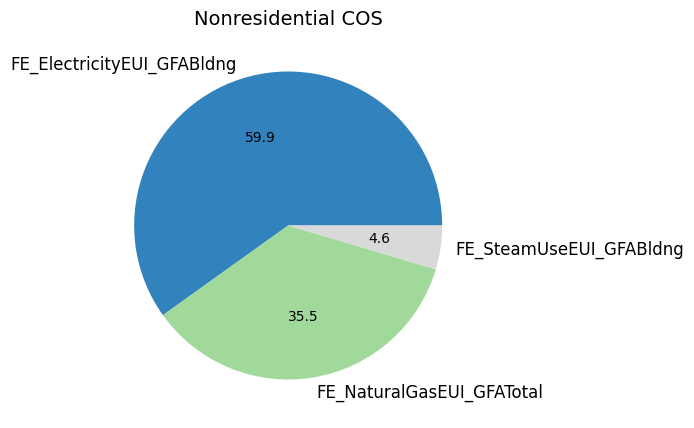

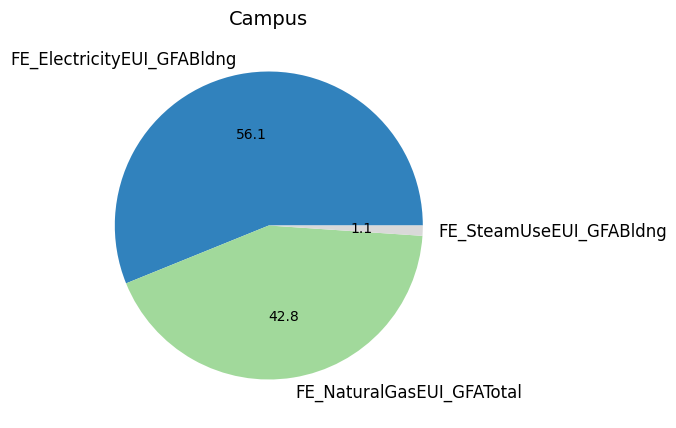

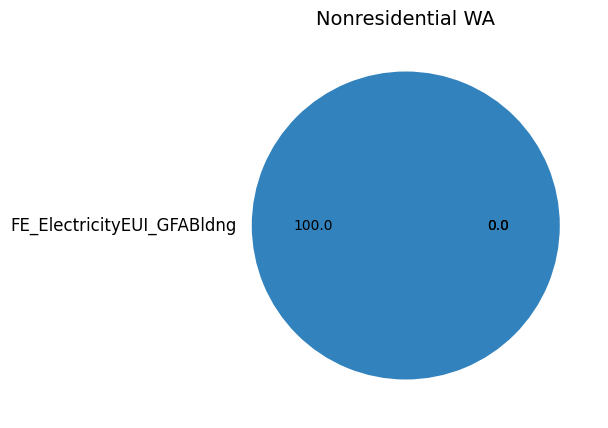

In [106]:
btypes = df_clean['BuildingType'].value_counts()

n = len(btypes)
ind = -1
for val in btypes.index:
    plt.figure(figsize=(10,5))
    df = df_clean.loc[df_clean['BuildingType']==val, ['FE_ElectricityEUI_GFABldng', 'FE_NaturalGasEUI_GFATotal', 'FE_SteamUseEUI_GFABldng']].mean(axis=0)
    df.plot.pie(colormap='tab20c', autopct='%.1f') # labels=labels
    plt.title(f'{val}')


C:\Users\a072108\AppData\Local\Temp\ipykernel_31600\641582816.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10,5))


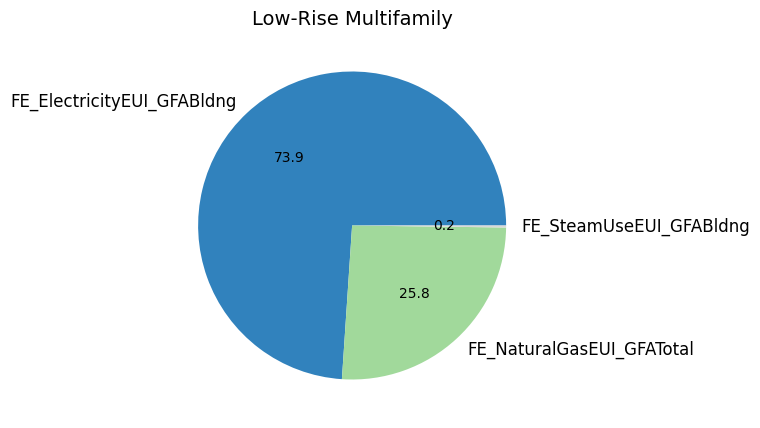

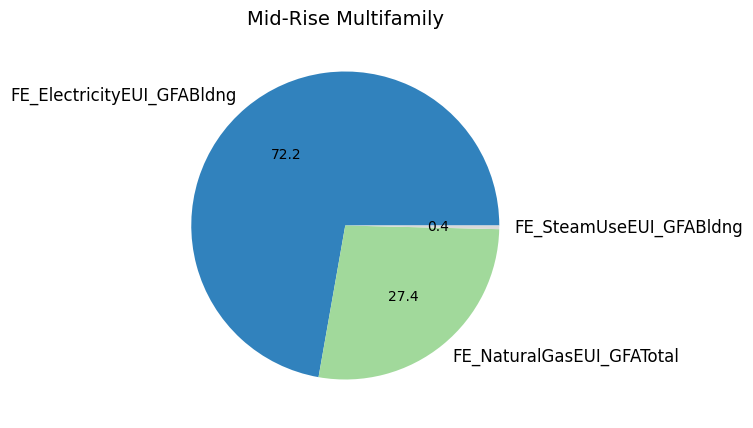

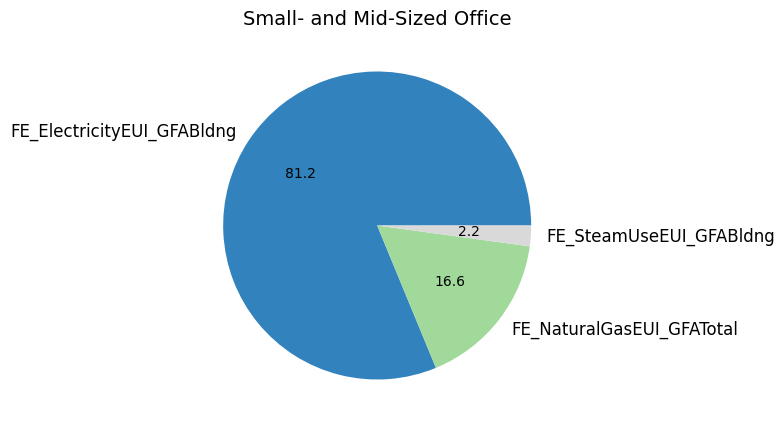

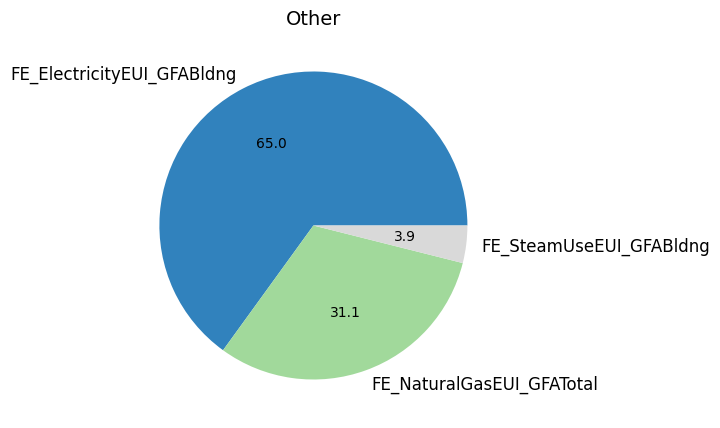

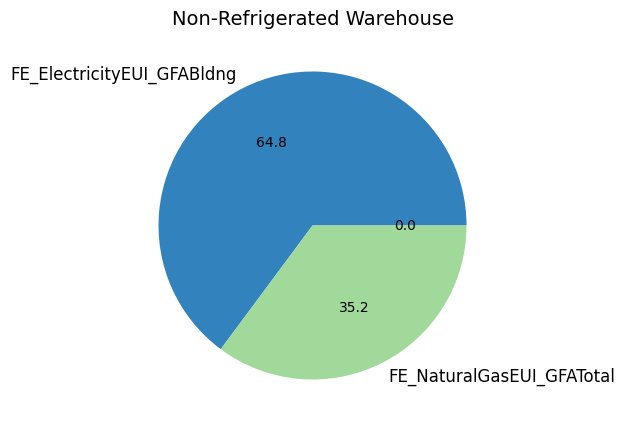

...

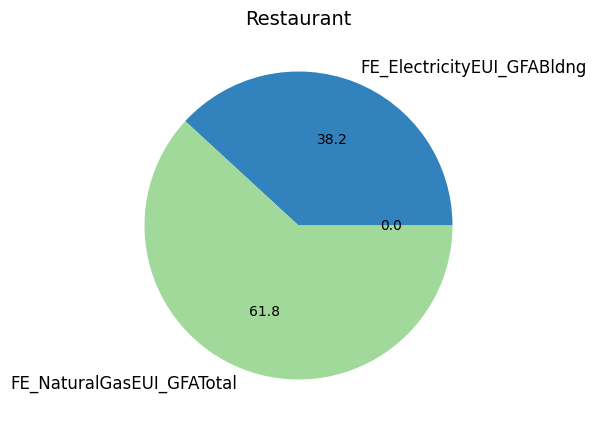

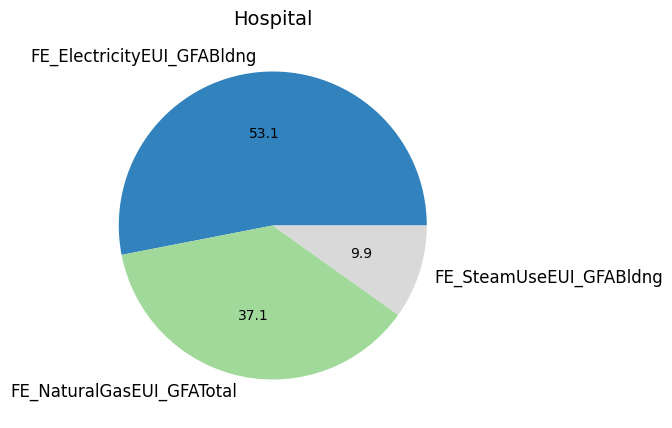

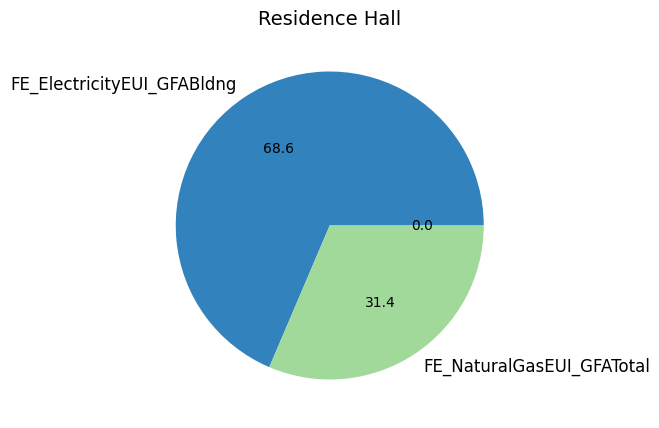

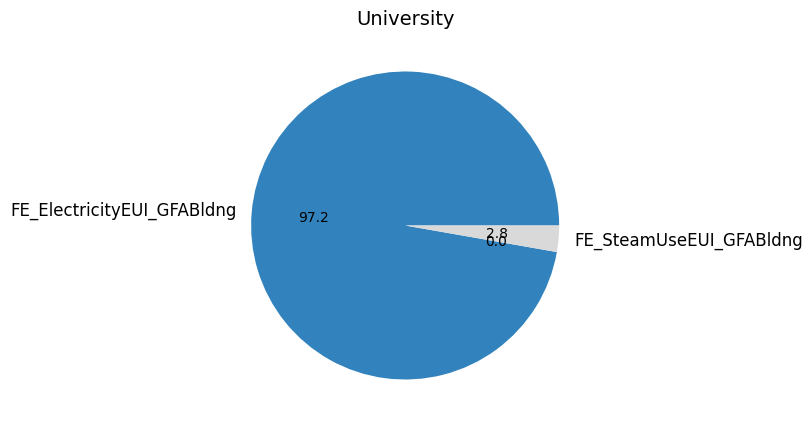

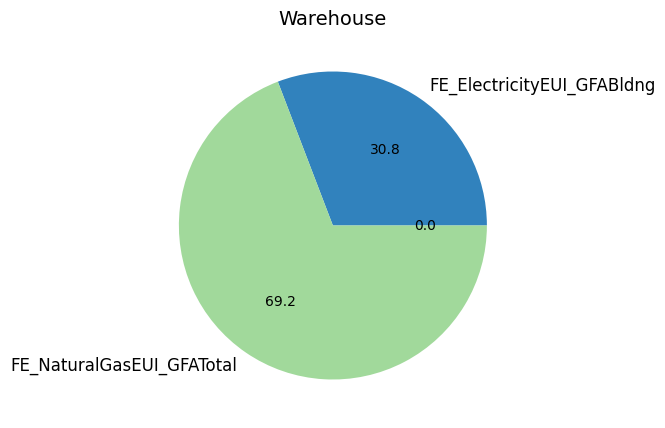

In [107]:
pptypes = df_clean['PrimaryPropertyType'].value_counts()

n = len(pptypes)
ind = -1
for val in pptypes.index:
    plt.figure(figsize=(10,5))
    df = df_clean.loc[df_clean['PrimaryPropertyType']==val, ['FE_ElectricityEUI_GFABldng', 'FE_NaturalGasEUI_GFATotal', 'FE_SteamUseEUI_GFABldng']].mean(axis=0)
    df.plot.pie(colormap='tab20c', autopct='%.1f') # labels=labels
    plt.title(f'{val}')
    

#### Parmi les bâtiments ressemblants (en source d'énergie) au 6614 : celui-ci est-il un outlier ?

In [108]:
df_source = df_clean.copy()

In [109]:
df_source['ElectricityRate'] = df_source['Electricity(kBtu)'] / df_source['SiteEnergyUse(kBtu)']
df_source['GasRate'] = df_source['NaturalGas(kBtu)'] / df_source['SiteEnergyUse(kBtu)']
df_source['SteamRate'] = df_source['SteamUse(kBtu)'] / df_source['SiteEnergyUse(kBtu)']

In [110]:
df_surtout_elec = df_source.loc[df_source['ElectricityRate'] > 0.5]
df_surtout_vap = df_source.loc[df_source['GasRate'] > 0.5]
df_surtout_gaz = df_source.loc[df_source['SteamRate'] > 0.5]

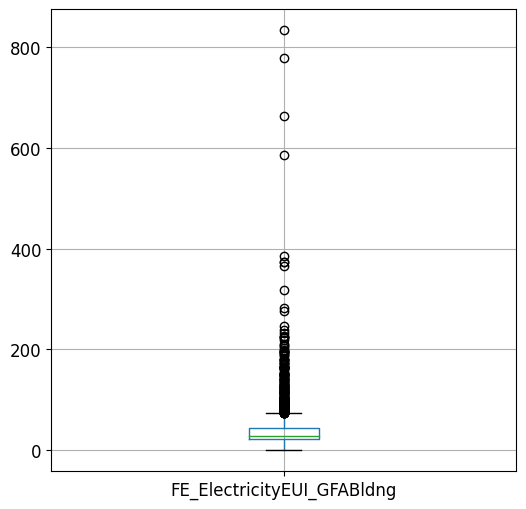

In [111]:
a = df_surtout_elec[['FE_ElectricityEUI_GFABldng']].boxplot()

In [112]:
6614 in df_surtout_elec.loc[df_surtout_elec['FE_ElectricityEUI_GFABldng']>70].index

True

Le 6614 est un outlier dans le groupe des propriétés utilisant surtout l'électricité.

#### Z-score

In [113]:
indices = np.where(np.absolute(zscore(df_clean['SiteEUI(kBtu/sf)'])) > 2)[0]
df_outliers = df_clean.iloc[indices]
df_outliers.index

Int64Index([  60,   98,  123,  167,  170,  197,  217,  254,  331,  335,
            ...
             509,  548,  604,  621,  643,  756, 1122, 1912, 3226, 3238],
           dtype='int64', length=124)

In [114]:
indices

array([  28,   52,   66,   94,   97,  113,  118,  128,  142,  143,  147,
        153,  156,  173,  175,  194,  213,  220,  280,  298,  338,  466,
        599,  614,  730,  746,  752,  754,  771,  777,  843,  846,  880,
        998, 1017, 1098, 1106, 1184, 1263, 1265, 1333, 1339, 1422, 1554,
       1627, 1693, 1695, 1710, 1717, 1719, 1724, 1743, 1757, 1767, 1780,
       1787, 1803, 1827, 1864, 1866, 1874, 1880, 1892, 1904, 1954, 1990,
       1992, 2017, 2036, 2059, 2094, 2104, 2110, 2144, 2173, 2176, 2210,
       2243, 2244, 2279, 2297, 2310, 2316, 2355, 2411, 2415, 2417, 2420,
       2428, 2441, 2449, 2465, 2493, 2503, 2511, 2543, 2553, 2558, 2568,
       2574, 2601, 2616, 2626, 2668, 2670, 2688, 2736, 2801, 2807, 2833,
       2862, 2863, 2882, 2884, 2887, 2893, 2899, 2901, 2902, 2915, 2942,
       3011, 3129, 3133], dtype=int64)

In [115]:
df_clean.loc[6614,num_cols]

PropertyGFATotal                       9320156
PropertyGFAParking                           0
PropertyGFABuilding(s)                 9320156
LargestPropertyUseTypeGFA            9320156.0
SecondLargestPropertyUseTypeGFA            0.0
ThirdLargestPropertyUseTypeGFA             0.0
SiteEUI(kBtu/sf)                     93.800003
SiteEUIWN(kBtu/sf)                         0.0
SourceEUI(kBtu/sf)                  246.600006
SourceEUIWN(kBtu/sf)                       0.0
SteamUse(kBtu)                      84985240.0
Electricity(kBtu)                  657074389.0
NaturalGas(kBtu)                           0.0
GHGEmissionsIntensity                      1.2
SiteEnergyUseWN(kBtu)                      0.0
TotalGHGEmissions                     11140.56
SiteEnergyUse(kBtu)                873923712.0
Name: 6614, dtype: object

In [116]:
df_clean.columns

Index(['BuildingType', 'PrimaryPropertyType', 'CouncilDistrictCode',
       'Neighborhood', 'YearBuilt', 'NumberofBuildings', 'NumberofFloors',
       'PropertyGFATotal', 'PropertyGFAParking', 'PropertyGFABuilding(s)',
       ...
       'UseType_Distribution Center', 'UseType_Non-Refrigerated Warehouse',
       'UseType_Urgent Care/Clinic/Other Outpatient', 'UseType_Other',
       'UseType_Financial Office', 'UseType_Courthouse',
       'UseType_Vocational School', 'UseType_Supermarket/Grocery Store',
       'UseType_Senior Care Community', 'UseType_Office'],
      dtype='object', length=117)

#### Matrice de corrélation de Pearson

In [117]:
df_clean.columns

Index(['BuildingType', 'PrimaryPropertyType', 'CouncilDistrictCode',
       'Neighborhood', 'YearBuilt', 'NumberofBuildings', 'NumberofFloors',
       'PropertyGFATotal', 'PropertyGFAParking', 'PropertyGFABuilding(s)',
       ...
       'UseType_Distribution Center', 'UseType_Non-Refrigerated Warehouse',
       'UseType_Urgent Care/Clinic/Other Outpatient', 'UseType_Other',
       'UseType_Financial Office', 'UseType_Courthouse',
       'UseType_Vocational School', 'UseType_Supermarket/Grocery Store',
       'UseType_Senior Care Community', 'UseType_Office'],
      dtype='object', length=117)

[Text(0, 0.5, 'YearBuilt'),
 Text(0, 1.5, 'NumberofBuildings'),
 Text(0, 2.5, 'NumberofFloors'),
 Text(0, 3.5, 'PropertyGFATotal'),
 Text(0, 4.5, 'PropertyGFAParking'),
 Text(0, 5.5, 'PropertyGFABuilding(s)'),
 Text(0, 6.5, 'LargestPropertyUseTypeGFA'),
 Text(0, 7.5, 'SecondLargestPropertyUseTypeGFA'),
 Text(0, 8.5, 'ThirdLargestPropertyUseTypeGFA'),
 Text(0, 9.5, 'ResidualGFA'),
 Text(0, 10.5, 'SiteEUI(kBtu/sf)'),
 Text(0, 11.5, 'SourceEUI(kBtu/sf)'),
 Text(0, 12.5, 'SiteEnergyUse(kBtu)'),
 Text(0, 13.5, 'SteamUse(kBtu)'),
 Text(0, 14.5, 'Electricity(kBtu)'),
 Text(0, 15.5, 'NaturalGas(kBtu)'),
 Text(0, 16.5, 'TotalGHGEmissions'),
 Text(0, 17.5, 'GHGEmissionsIntensity')]

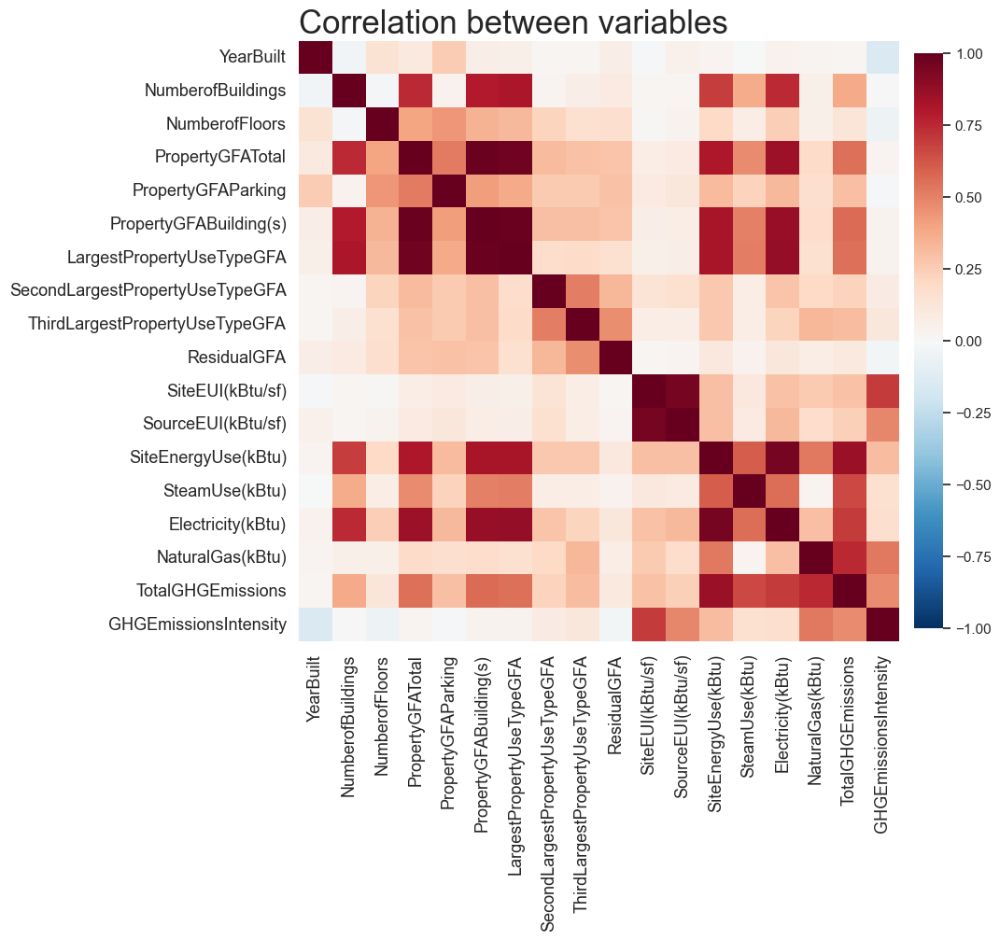

In [118]:
correl = df_clean[correl_cols].corr(method='pearson')
sns.set(font_scale=2)
sns.set(rc={'figure.facecolor': 'white'})
fig, ax = plt.subplots(figsize=(10, 10))
correl_final = sns.heatmap(correl, vmin=-1, vmax=1, cmap="RdBu_r", square=True, ax=ax,
                           cbar_kws={'orientation': 'vertical',
                                     'pad': 0.02, 'shrink': 0.8}
                           )
correl_final.set_title('Correlation between variables', fontsize=25, loc='left')
correl_final.set_xticklabels(correl_final.get_xmajorticklabels(), fontsize=13)
correl_final.set_yticklabels(correl_final.get_ymajorticklabels(), fontsize=13)

- Les variables WN (Weather Normalized) sont bien ultra-corrélées au variables annuelles, inutile de les conserver.
- PropertyGFATotal et PropertyGFABuilding(s) sont très corrélées, donc inutile de conserver la 2nd (par ex).
- PropertyGFATotal et NumberofBuildings : idem
- La variable émissions totales `'TotalGHGEmissions'` est corrélée aux variables :
  `'NumberofBuildings'`, `'PropertyGFATotal'`, `'PropertyGFABuilding(s)'`
- L'intensité des émissions `'GHGEmissionsIntensity'` est anticorrélée :
  à l'année de construction `'YearBuilt'` 
  au nombre d'étages `'NumberofFloors'` (donc à conserver finalement ?)
  à la surface des parkings `'PropertyGFAParking'`
- La variable consommation totale d'énergie `'SiteEnergyUse'` est très corrélée à :
  `'NumberofBuildings'`, `'PropertyGFATotal'`, `'PropertyGFABuilding(s)'`
- YearBuilt est légèrement anticorrélée à `'SiteEUIWN'` (et, encore une fois, plutôt anticorrélée à `'GHGEmissionsIntensity'`)
- Les variables introduites d'intensité par unité de surface de plancher habitable `'_Bldng'` montrent de meilleures anticorrélations avec l'année de construction `'YearBuilt'` et le nombre d'étages `'NumberofFloors'`
- Avec plaisir, les `'ResidualGFA'` n'expliquent pas grand chose côté énergie et CO2, même si sont corrélées aux autres surfaces de base
- Les énergies gaz et vapeur sont anti-corrélées entre elles
- Mais l'électricité est un peu à assez corrélées avec ces deux dernières, comme quoi.
- Le nombre d'étages joue vraiment un rôle sur les intensités
- Le nombre de buildings joue sur les quantités totales d'émission/conso (mais car corrélé aux surfaces totales), mais pas sur les intensités 

## Etudes multivariées

#### ACP

In [119]:
Xpca = df_clean[correl_cols].values

In [120]:
names = df_clean.index
features = correl_cols

In [121]:
std_scale = StandardScaler().fit(Xpca)
Xpca_scaled = std_scale.transform(Xpca)

In [122]:
n_comp = 6

In [123]:
pca = PCA(n_components=n_comp)
pca.fit(Xpca_scaled)

PCA(n_components=6)

#### Valeurs propres

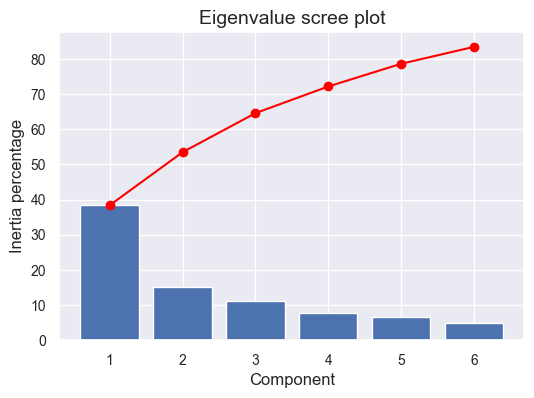

In [124]:
plt.rcParams['figure.figsize'] = [6, 4]
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

DisplotML.display_scree_plot(pca)

#### Cercle des corrélations

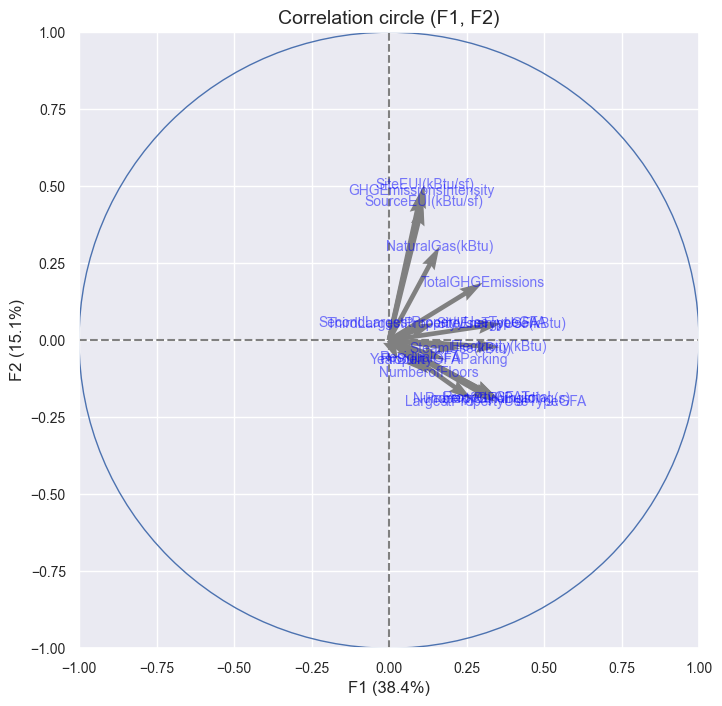

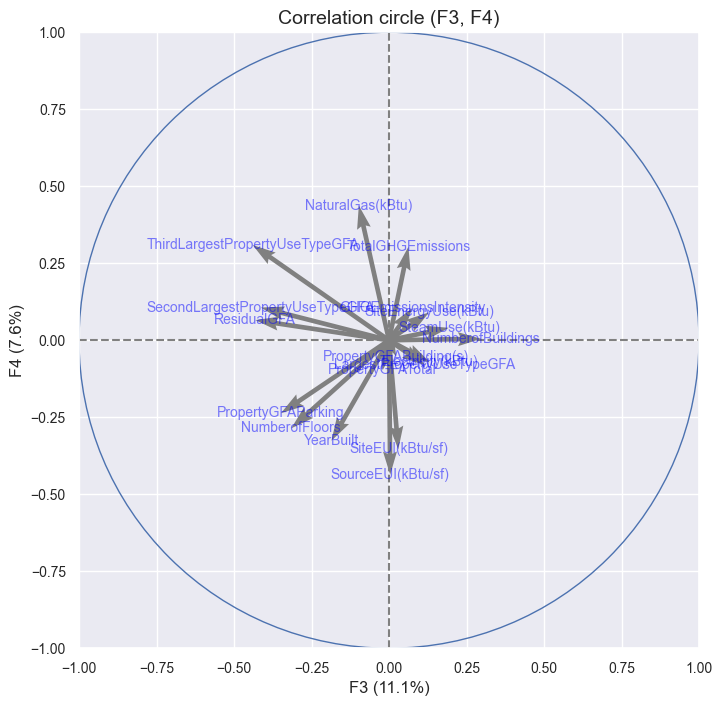

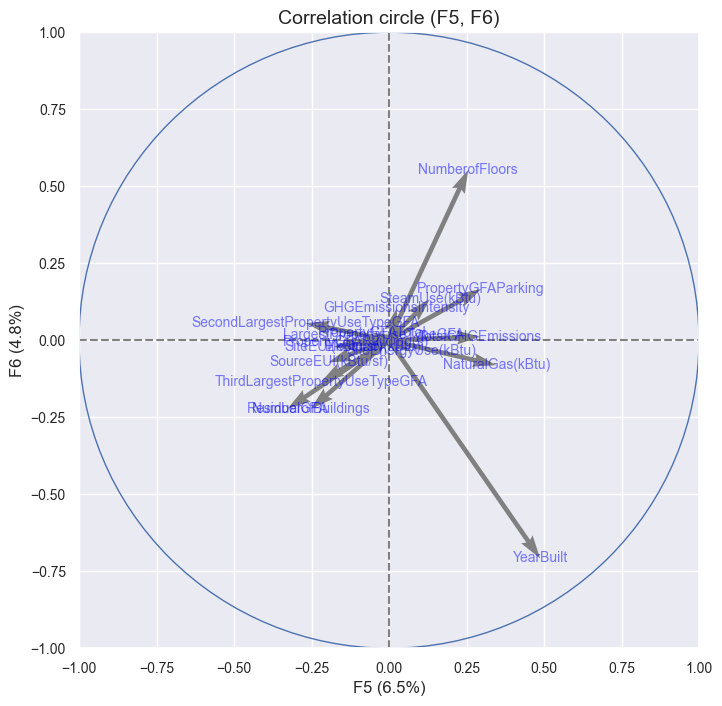

In [125]:
plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

pcs = pca.components_
DisplotML.display_circles(pcs, n_comp, pca, [(0,1),(2,3),(4,5)], labels = np.array(features))

In [126]:
# nn = 1000
nn = None

In [127]:
# %matplotlib notebook
%matplotlib inline

In [128]:
illus_var = df_clean['LargestPropertyUseType'].values[0:nn]

#### Projection des individus

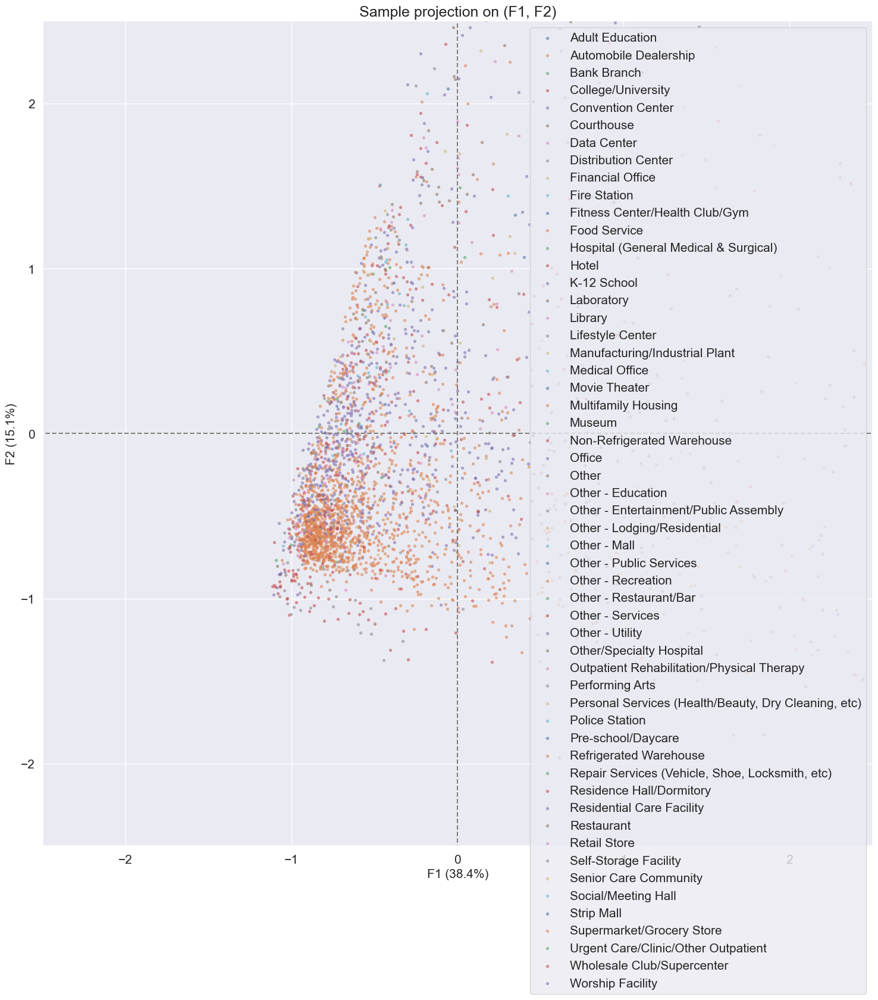

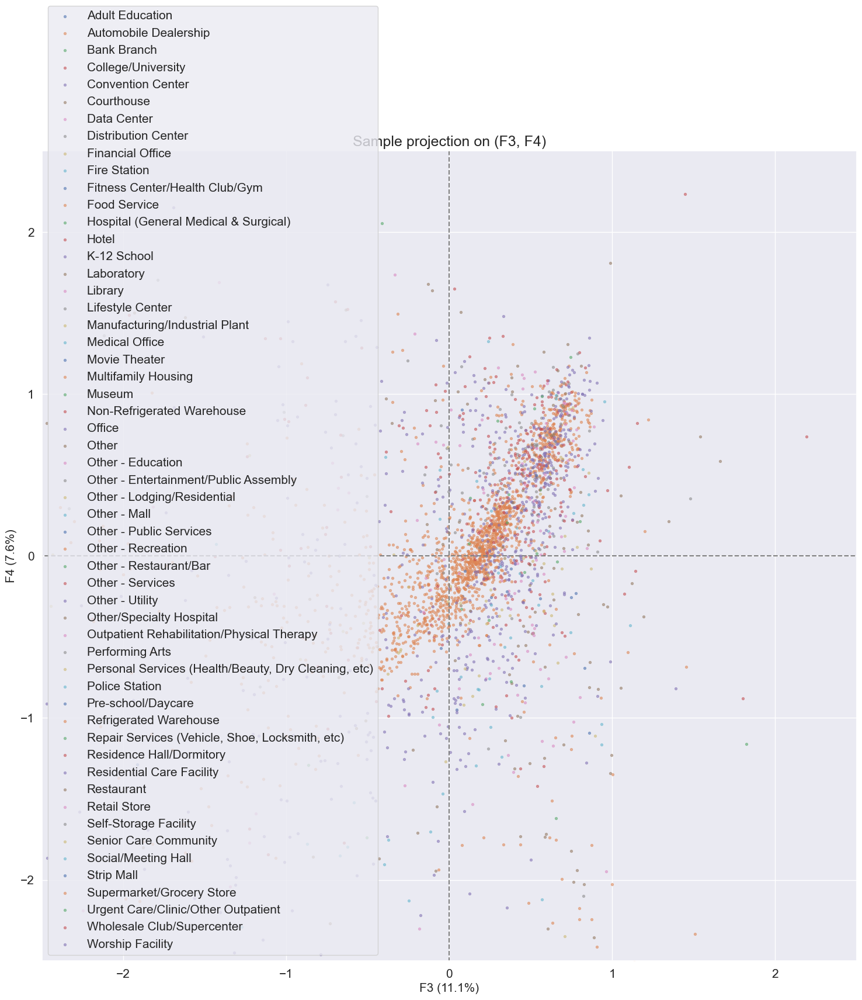

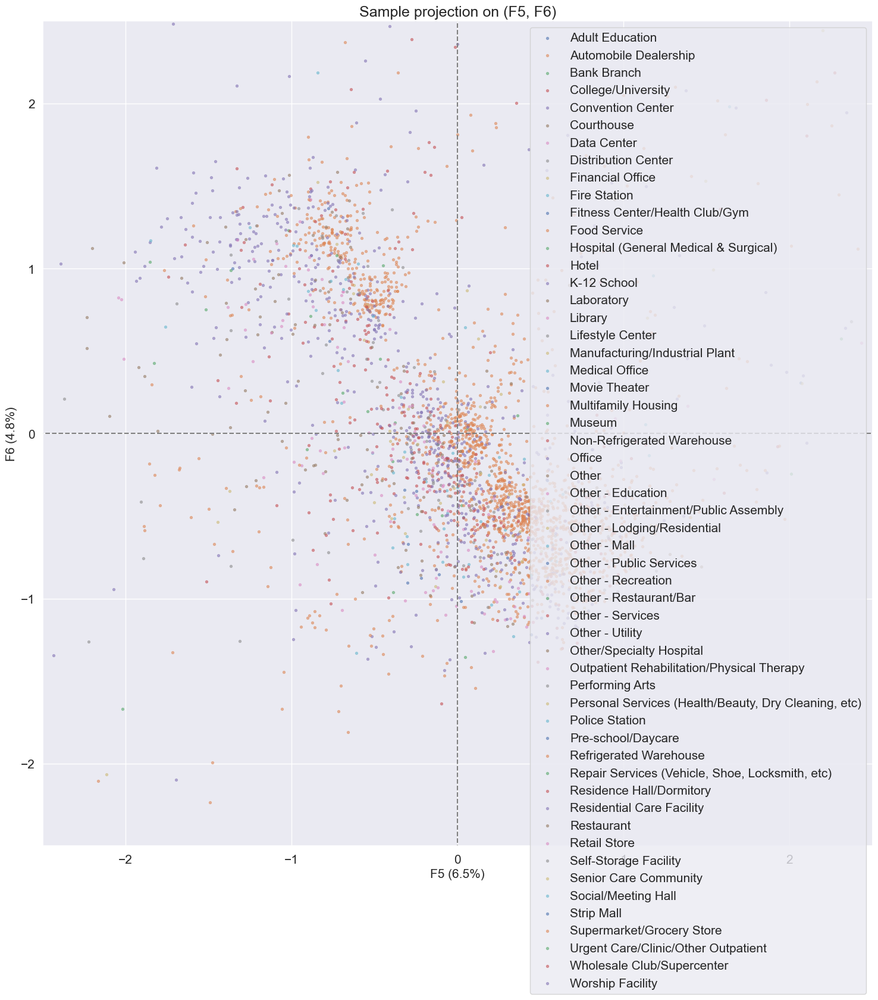

In [129]:
plt.rcParams['figure.figsize'] = [18, 18]
plt.rcParams['axes.titlesize'] = 18
plt.rcParams['axes.labelsize'] = 15
plt.rcParams['xtick.labelsize'] = 15
plt.rcParams['ytick.labelsize'] = 15

Xpca_projected = pca.transform(Xpca_scaled[0:nn, :])
DisplotML.display_factorial_planes(Xpca_projected, n_comp, pca, [(0, 1), (2, 3), (4, 5)], alpha=0.5, labels=None,
                                   marker='o', s=8, illustrative_var=illus_var,
                                   # (F1,F2) : # (F3,F4): # (F5,F6) : xlim=[-3.,7.5], ylim=[-5.,5.5]
                                   xlim=[-2.5, 2.5], ylim=[-2.5, 2.5]
                                   )
plt.show()

# Détection d'anomalies

In [130]:
X = df_clean[feat_cols].copy()
preprocessor = ColumnTransformer(
    [
        ("categorical", OneHotEncoder(sparse=False,handle_unknown='ignore'), categ_cols),
        ("numerical", StandardScaler(), num_cols),
    ],
    verbose_feature_names_out=False,
)
preprocessor.fit(X)
X_enc = preprocessor.transform(X)

In [131]:
clf = IsolationForest(n_estimators=10, warm_start=True)
clf.fit(X_enc)
clf.set_params(n_estimators=20)
c = clf.fit(X_enc)

In [132]:
y_pred = clf.predict(X_enc)

In [133]:
df_ano = df_clean.copy()

In [134]:
df_ano['Anomaly'] = y_pred

In [135]:
df_ano.loc[6614,'Anomaly']

1

In [136]:
df_ano.loc[df_ano['Anomaly']<0]

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Strip Mall,UseType_Self-Storage Facility,UseType_Other - Restaurant/Bar,UseType_None,UseType_Manufacturing/Industrial Plant,UseType_Fitness Center/Health Club/Gym,UseType_Convenience Store without Gas Station,UseType_Adult Education,UseType_Other - Utility,UseType_Social/Meeting Hall,UseType_Bar/Nightclub,UseType_Enclosed Mall,UseType_Residential Care Facility,UseType_Other - Technology/Science,UseType_Distribution Center,UseType_Non-Refrigerated Warehouse,UseType_Urgent Care/Clinic/Other Outpatient,UseType_Other,UseType_Financial Office,UseType_Courthouse,UseType_Vocational School,UseType_Supermarket/Grocery Store,UseType_Senior Care Community,UseType_Office,Anomaly


Tout le monde a gagné.

## Leviers 

In [137]:
nbCst = 1

In [138]:
p = X_enc.shape[1]
n = X_enc.shape[0]
leverage_crit = 2.*(p+nbCst)/n

In [139]:
y = df_clean[['SiteEnergyUseWN(kBtu)']]

In [140]:
model = sm.OLS(y,X_enc)
results = model.fit()
influence = results.get_influence()
leverage = influence.hat_matrix_diag

In [141]:
leverage

array([0.16526107, 0.39839566, 1.        , ..., 0.3333171 , 0.24287223,
       0.3871317 ])

In [142]:
leverage.sum()

743.0000000000072

In [143]:
leverage_crit

0.550314465408805

In [144]:
Xoutliers = X[leverage>leverage_crit]
Xoutliers

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,ListOfAllPropertyUseTypes,LargestPropertyUseType,SecondLargestPropertyUseType,ThirdLargestPropertyUseType,ZipCode,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),GHGEmissionsIntensity,SiteEnergyUseWN(kBtu),TotalGHGEmissions,SiteEnergyUse(kBtu)
5,Nonresidential COS,Other,7,DOWNTOWN,1999,1.0,2.0,Police Station,Police Station,None,None,19576.0,97288,37198,60090,60090.0,0.000000,0.000000,135.700000,146.900000,313.500000,321.600000,0.0,7271004.0,4781283.0,2.81,13045258.00,304.62,12051984.00
17,NonResidential,Hotel,7,DOWNTOWN,1983,1.0,28.0,"Hotel, Parking",Hotel,None,None,18379.0,416281,85000,331281,331281.0,0.000000,0.000000,95.500000,97.400000,231.900000,234.700000,0.0,21932264.0,11339166.0,1.59,33922016.00,755.12,33270518.00
49,NonResidential,Hotel,7,DOWNTOWN,1982,1.0,34.0,"Hotel, Parking, Swimming Pool",Hotel,None,None,18081.0,994212,146694,847518,847518.0,0.000000,0.000000,85.900000,89.300000,187.300000,191.600000,16229832.0,45041634.0,24088353.0,2.67,88771488.00,2846.07,85357952.00
80,NonResidential,Hotel,4,NORTHEAST,1962,1.0,4.0,"Hotel, Swimming Pool",Hotel,None,None,18383.0,50017,0,50017,50017.0,0.000000,0.000000,111.400000,114.300000,207.100000,210.000000,0.0,2156751.0,3413811.0,3.74,5717357.00,196.34,5570472.00
116,SPS-District K-12,K-12 School,5,NORTH,2011,1.0,2.0,"K-12 School, Parking",K-12 School,None,None,19579.0,236758,0,236758,236758.0,0.000000,0.000000,34.000000,41.100000,78.700000,89.100000,0.0,4868567.0,3182614.0,0.77,9730278.00,202.97,8050977.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3989,Multifamily LR (1-4),Low-Rise Multifamily,4,NORTHEAST,1965,5.0,2.0,"Multifamily Housing, Parking",Multifamily Housing,Retail Store,Restaurant,98115.0,62900,12417,62900,48618.0,3175.472687,813.730042,31.900000,31.900000,49.500000,49.500000,0.0,372279.0,1179772.0,1.04,1552051.25,65.25,1552051.25
6622,Multifamily MR (5-9),Residence Hall,7,MAGNOLIA/QUEEN ANNE,2015,1.0,5.0,"Parking, Residence Hall/Dormitory",Residence Hall/Dormitory,Office,Retail Store,98119.0,69451,23084,69451,46828.0,14671.632600,7272.900879,34.200001,36.900002,76.699997,82.099998,0.0,912677.0,691053.0,0.62,1725944.25,43.06,1603730.25
6642,Multifamily HR (10+),High-Rise Multifamily,7,DOWNTOWN,2014,1.0,41.0,"Multifamily Housing, Parking, Restaurant",Multifamily Housing,Retail Store,Restaurant,98101.0,499477,100000,499477,307810.0,46294.584505,48196.808594,67.099998,0.000000,140.100006,0.000000,0.0,10250156.0,10370435.0,1.25,0.00,622.23,20657852.00
6656,Multifamily MR (5-9),Mid-Rise Multifamily,2,SOUTHEAST,2015,1.0,6.0,"Multifamily Housing, Parking",Multifamily Housing,Retail Store,Office,98118.0,283479,86340,283479,165828.0,48730.316505,9760.855469,41.099998,41.799999,76.900002,79.000000,0.0,2677352.0,4144480.0,0.84,6930938.50,238.78,6821833.00


In [145]:
Xoutliers.loc[6614]

BuildingType                                   Campus
PrimaryPropertyType                        University
CouncilDistrictCode                                 4
Neighborhood                                NORTHEAST
YearBuilt                                        1900
NumberofBuildings                               111.0
NumberofFloors                                    0.0
ListOfAllPropertyUseTypes          College/University
LargestPropertyUseType             College/University
SecondLargestPropertyUseType                     None
ThirdLargestPropertyUseType                      None
ZipCode                                       98105.0
PropertyGFATotal                              9320156
PropertyGFAParking                                  0
PropertyGFABuilding(s)                        9320156
LargestPropertyUseTypeGFA                   9320156.0
SecondLargestPropertyUseTypeGFA                   0.0
ThirdLargestPropertyUseTypeGFA                    0.0
SiteEUI(kBtu/sf)            

In [146]:
for ind in [6614, 341, 1709, 476, 223, 154, 271, 334, 581, 819, 195, 271, 302, 581, 888, 888, 499, 494, 2626,
           69]:
    print(ind in Xoutliers.index)

True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
False
False
False
False


On met les suspects en garde à vue :

In [147]:
leverage_index = Xoutliers.index

On vérifie que les outliers repérés dans les études bivariées sont dans les leviers :

In [148]:
3375 in leverage_index

True

# Feature engineering

## Réduction du nombre de colonnes pour la partie UseType+UseTypeGFA

In [149]:
df_clean2 = df_clean.copy()
df_clean2['Residual'] = 'Residual'
df_clean2['Parking'] = 'Parking'

In [150]:
categ_cols2 = ['LargestPropertyUseType', 'SecondLargestPropertyUseType',
               'ThirdLargestPropertyUseType', 'Residual', 'Parking']
num_cols2 = ['LargestPropertyUseTypeGFA', 'SecondLargestPropertyUseTypeGFA',
             'ThirdLargestPropertyUseTypeGFA', 'ResidualGFA', 'PropertyGFAParking']

In [151]:
df_clean, use_type_gfa_cols = MLstuff.reduce_categ_numeric_info(df_clean2, categ_cols2, num_cols2, 'UseType_')
df_clean

,BuildingType,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),...,UseType_Other - Entertainment/Public Assembly,UseType_Bar/Nightclub,UseType_Data Center,UseType_Food Sales,UseType_Parking,UseType_Senior Care Community,UseType_Refrigerated Warehouse,UseType_Other,UseType_Strip Mall,UseType_Multifamily Housing,UseType_Police Station,UseType_Wholesale Club/Supercenter,UseType_Other - Restaurant/Bar,UseType_Vocational School,"UseType_Repair Services (Vehicle, Shoe, Locksmith, etc)",UseType_Museum,UseType_Residence Hall/Dormitory,UseType_Other - Technology/Science,UseType_Other - Lodging/Residential,UseType_Swimming Pool,UseType_K-12 School,UseType_Lifestyle Center,UseType_Performing Arts,UseType_Supermarket/Grocery Store,UseType_Movie Theater
0,NonResidential,Hotel,7,DOWNTOWN,1927,1.0,12.0,88434,0,88434,Hotel,Hotel,88434.0,None,0.000000,None,0.000000,65.0,78.900000,80.300000,173.500000,175.100000,6981428.0,7097539.00,2023032.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,NonResidential,Hotel,7,DOWNTOWN,1980,1.0,18.0,119890,68009,107430,"Hotel, Parking, Swimming Pool",Hotel,107430.0,None,0.000000,None,0.000000,67.0,120.100000,122.100000,228.800000,227.100000,14829099.0,15078243.00,0.0,...,0.0,0.0,0.0,0.0,68009.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,Nonresidential COS,Other,7,DOWNTOWN,1999,1.0,2.0,97288,37198,60090,Police Station,Police Station,60090.0,None,0.000000,None,0.000000,NaN,135.700000,146.900000,313.500000,321.600000,12051984.0,13045258.00,0.0,...,0.0,0.0,0.0,0.0,37198.0,0.0,0.0,0.0,0.0,0.0,60090.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,NonResidential,Other,7,DOWNTOWN,1926,1.0,8.0,102761,0,102761,Other - Entertainment/Public Assembly,Other - Entertainment/Public Assembly,102761.0,None,0.000000,None,0.000000,NaN,62.500000,71.800000,152.200000,160.400000,6426022.0,7380086.00,2003108.0,...,102761.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,NonResidential,Hotel,7,DOWNTOWN,1904,1.0,15.0,163984,0,163984,Hotel,Hotel,163984.0,None,0.000000,None,0.000000,46.0,77.000000,82.900000,174.600000,186.800000,12633744.0,13589025.00,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6665,Multifamily MR (5-9),Mid-Rise Multifamily,7,LAKE UNION,2014,1.0,8.0,110964,27261,110964,"Multifamily Housing, Parking",Multifamily Housing,104384.0,Office,1956.681648,Retail Store,1370.426636,98.0,30.900000,31.400000,74.099998,74.699997,3220534.0,3274963.75,0.0,...,0.0,0.0,0.0,0.0,27261.0,0.0,0.0,0.0,0.0,104384.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6666,Multifamily MR (5-9),Mid-Rise Multifamily,6,BALLARD,2014,2.0,7.0,318835,82608,318835,"Multifamily Housing, Parking",Multifamily Housing,236227.0,Retail Store,32672.576379,Office,7534.994629,100.0,30.400000,31.100000,73.300003,75.599998,7180055.0,7355683.00,0.0,...,0.0,0.0,0.0,0.0,82608.0,0.0,0.0,0.0,0.0,236227.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6672,Multifamily MR (5-9),Mid-Rise Multifamily,4,LAKE UNION,2015,1.0,5.0,175844,52045,123799,"Multifamily Housing, Parking",Multifamily Housing,99554.0,Office,8041.181458,Retail Store,2648.425781,99.0,32.000000,32.900002,77.699997,80.5000

## Nouvelles variables

#### Variables `'SteamUsed'`, `'ElecUsed'` et `'GasUsed'` donnant les types d'énergie utilisées

#### Variables `'SteamUsed'`, `'ElecUsed'` and `'GasUsed'` giving the types of energy used

Déjà créées lors de l'analyse statistiques.

## Sélection de variables

Influence des variables sur la target

In [152]:
categ_cols_infl = ['BuildingType', 'PrimaryPropertyType', 'CouncilDistrictCode',
                   'Neighborhood', 'YearBuilt', 'NumberofBuildings', 'NumberofFloors',
                   'LargestPropertyUseType', 'SecondLargestPropertyUseType', 'ThirdLargestPropertyUseType',
                   'ZipCode']

num_cols_infl = ['PropertyGFAParking', 'PropertyGFABuilding(s)', # 'PropertyGFATotal',
                 'LargestPropertyUseTypeGFA', 'SecondLargestPropertyUseTypeGFA', 'ThirdLargestPropertyUseTypeGFA',
                 'SteamUsed', 'ElecUsed','GasUsed',
                ]

feat_cols_infl = categ_cols_infl+num_cols_infl

RandomForest gives us feature importance

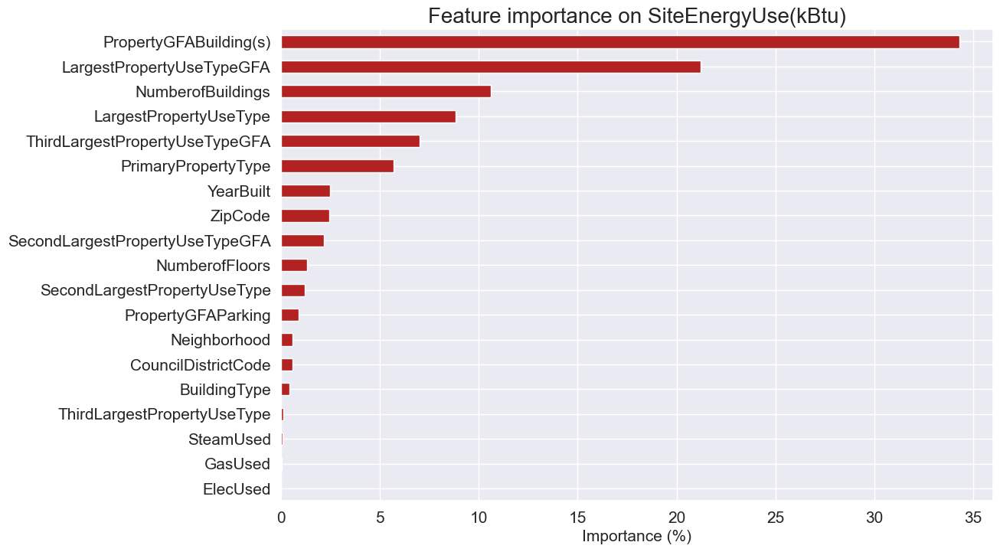

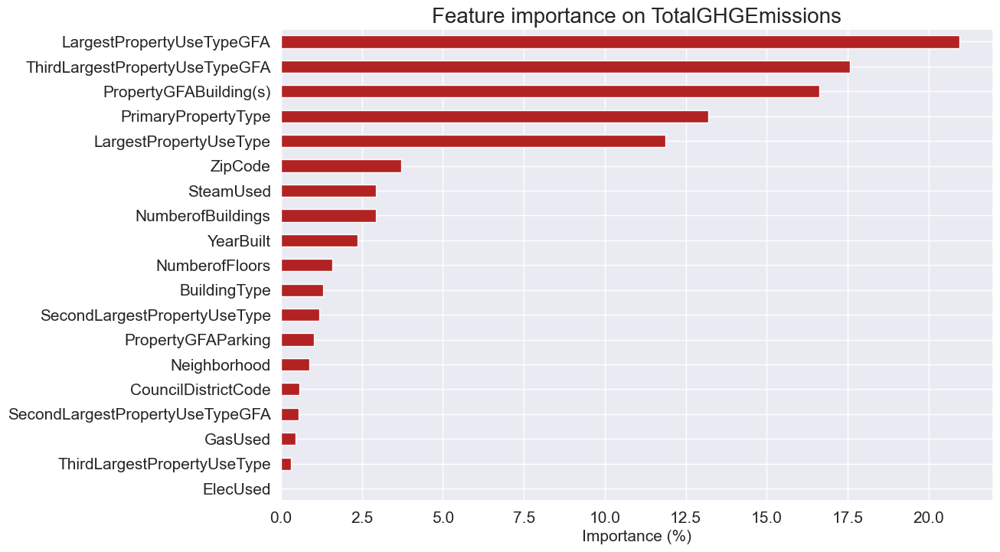

In [153]:
for target_col in ['SiteEnergyUse(kBtu)', 'TotalGHGEmissions']:

    X = df_clean[feat_cols_infl].copy()
    y = df_clean[target_col].copy()
    preprocessor = ColumnTransformer(
        [
            ("categorical", OneHotEncoder(sparse=False,handle_unknown='ignore'), categ_cols_infl),
            ("numerical", MinMaxScaler(), num_cols_infl),
        ],
        verbose_feature_names_out=False,
    )
    preprocessor.fit(X)

    X_enc = preprocessor.transform(X)

    model = RandomForestRegressor()
    model.fit(X_enc, y)

    feat_values = preprocessor.get_feature_names_out()
    feat_values

    # Importance computation
    importance = model.feature_importances_

    feat_values = list(feat_values)

    influenceValsRandomForest = PwePwocess.influenceCatVal(feat_values, importance)

    df = pd.Series(influenceValsRandomForest)*100.

    plt.rcParams['figure.figsize'] = [12, 8]
    plt.rcParams['axes.titlesize'] = 20
    plt.rcParams['axes.labelsize'] = 15
    plt.rcParams['xtick.labelsize'] = 15
    plt.rcParams['ytick.labelsize'] = 15
    
    # Plot feature importance
    fig = plt.figure()
    df.plot(kind='barh', color='firebrick') # firebrick, salmon

    plt.title(f'Feature importance on {target_col}');
    plt.xlabel('Importance (%)');
    plt.show()


# Sauvegarde du dataframe propre pour les prédictions

In [154]:
df_clean_lev = df_clean.copy()
df_clean_no_lev = df_clean.copy()
df_clean_no_lev = df_clean_lev.drop(leverage_index)

In [155]:
with open(data_processed_dir+'df_clean_lev.pkl', 'wb') as output:
    pickle.dump(df_clean_lev, output, pickle.HIGHEST_PROTOCOL)

In [156]:
with open(data_processed_dir+'df_clean_no_lev.pkl', 'wb') as output:
    pickle.dump(df_clean_no_lev, output, pickle.HIGHEST_PROTOCOL)

In [157]:
with open(data_processed_dir+'leverage_index.pkl', 'wb') as output:
    pickle.dump(leverage_index, output, pickle.HIGHEST_PROTOCOL)

In [158]:
with open(data_processed_dir+'use_type_gfa_cols.pkl', 'wb') as output:
    pickle.dump(use_type_gfa_cols, output, pickle.HIGHEST_PROTOCOL)